Setting up Environment
----------------------------

In [22]:
import tensorflow as tf
tf.enable_eager_execution()

import functools
import matplotlib.pyplot as plt
import numpy as np
import pdb

# Download the class repository
! git clone https://github.com/aamini/introtodeeplearning_labs.git  > /dev/null 2>&1
% cd introtodeeplearning_labs 
! git pull
% cd .. 

!cp -r introtodeeplearning_labs/lab1 lab1
!cp -r /content/lab1/util.py util.py

# Import the necessary class-specific utility files for this lab
import introtodeeplearning_labs as util


/content/introtodeeplearning_labs
Already up to date.
/content


Opening /root/.keras/datasets/train_face.h5
Loading data into memory...


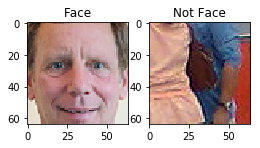

In [23]:
# Get the training data: both images from CelebA and ImageNet
path_to_training_data = tf.keras.utils.get_file('train_face.h5', 'https://www.dropbox.com/s/l5iqduhe0gwxumq/train_face.h5?dl=1')
# Instantiate a TrainingDatasetLoader using the downloaded dataset
loader = util.TrainingDatasetLoader(path_to_training_data)
number_of_training_examples = loader.get_train_size()
(images, labels) = loader.get_batch(100)

#@title Change the sliders to look at positive and negative training examples! { run: "auto" }

face_images = images[np.where(labels==1)[0]]
not_face_images = images[np.where(labels==0)[0]]

idx_face = 16 #@param {type:"slider", min:0, max:50, step:1}
idx_not_face = 42 #@param {type:"slider", min:0, max:50, step:1}

plt.figure(figsize=(4,2))
plt.subplot(1, 2, 1)
plt.imshow(face_images[idx_face])
plt.title("Face")
plt.grid(False)

plt.subplot(1, 2, 2)
plt.imshow(not_face_images[idx_not_face])
plt.title("Not Face")
plt.grid(False)

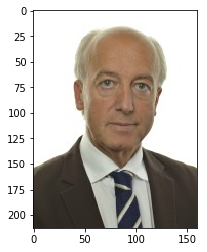

In [24]:
ppb = util.PPBFaceEvaluator(skip=4) # create the dataset handler

gender = "male" #@param ["male", "female"]
skin_color = "lighter" #@param ["lighter", "darker"]

img = ppb.get_sample_faces_from_demographic(gender, skin_color)
plt.imshow(img)
plt.grid(False)


Standard Classifier
-----------------------

In [0]:
n_outputs = 1 # number of outputs (i.e., face or not face)
n_filters = 12 # base number of convolutional filters

'''Function to define a standard CNN model'''
def make_standard_classifier():
    Conv2D = functools.partial(tf.keras.layers.Conv2D, padding='same', activation='relu')
    BatchNormalization = tf.keras.layers.BatchNormalization
    Flatten = tf.keras.layers.Flatten
    Dense = functools.partial(tf.keras.layers.Dense, activation='relu')

    model = tf.keras.Sequential([
    	# TODO: define a convolutional layer with n_filters 5x5 filters and 2x2 stride
        Conv2D(n_filters, 5, 2),
        BatchNormalization(),
        
        # TODO: define a convolutional layer with 2*n_filters 5x5 filters and 2x2 stride
        Conv2D(2*n_filters, 5, 2),
        BatchNormalization(),

        # TODO: define a convolutional layer with 4*n_filters 3x3 filters and 2x2 stride
        Conv2D(4*n_filters, 3, 2),
        BatchNormalization(),

        # TODO: define a convolutional layer with 6*n_filters 3x3 filters and 1x1 stride
        Conv2D(6*n_filters, 3, 1),
        BatchNormalization(),

        Flatten(),
        Dense(1, activation=None),
        tf.keras.layers.Dropout(0.5)
    ])
    return model
  
standard_classifier = make_standard_classifier()

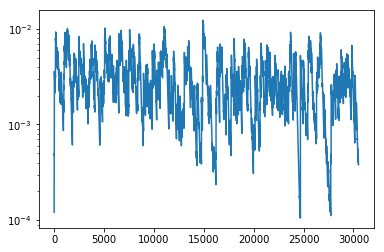

100%|######################################|Time:  0:01:21  Epoch: 9 Loss: 0.00


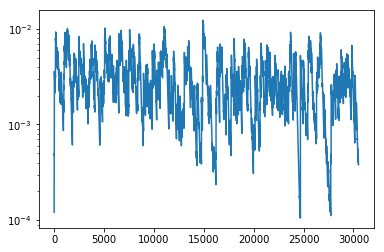

In [29]:
batch_size = 36
num_epochs = 10  # keep small to run faster
learning_rate = 1e-3

optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate) # define our optimizer
loss_history = util.LossHistory(smoothing_factor=0.99) # to record the evolution of the loss
plotter = util.PeriodicPlotter(sec=2, scale='semilogy')

# The training loop!
for epoch in range(num_epochs):
  
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)
  
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # First grab a batch of training data and convert the input images to tensors
    x, y = loader.get_batch(batch_size)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
    
    # GradientTape to record differentiation operations
    with tf.GradientTape() as tape:
      logits = standard_classifier(x) # feed the images into the model
      loss_value = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=logits) # compute the loss

    custom_msg.update_mapping(epoch=epoch, loss=loss_value.numpy().mean())
    # Backpropagation
    grads = tape.gradient(loss_value, standard_classifier.variables)
    optimizer.apply_gradients(zip(grads, standard_classifier.variables), global_step=tf.train.get_or_create_global_step())

    loss_history.append(loss_value.numpy().mean()) 
    plotter.plot(loss_history.get())

Evaluation of Standard Classifier
--------------------------------------

N/A% (0 of 97) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--

Standard CNN accuracy on (potentially biased) training set: 0.9990


100% (97 of 97) |########################| Elapsed Time: 0:01:11 Time:  0:01:11
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 1.0


100% (72 of 72) |########################| Elapsed Time: 0:00:50 Time:  0:00:50
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.958333333333


100% (78 of 78) |########################| Elapsed Time: 0:00:53 Time:  0:00:53
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.884615384615


100% (71 of 71) |########################| Elapsed Time: 0:00:48 Time:  0:00:48



female darker: 0.929577464789


Text(0,0.5,'Accuracy')

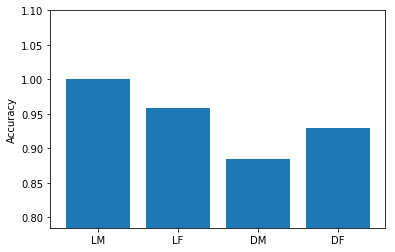

In [30]:
# Evaluate on a subset of CelebA+Imagenet
(batch_x, batch_y) = loader.get_batch(5000)
y_pred_standard = tf.round(tf.nn.sigmoid(standard_classifier.predict(batch_x)))
acc_standard = tf.reduce_mean(tf.cast(tf.equal(batch_y, y_pred_standard), tf.float32))
print "Standard CNN accuracy on (potentially biased) training set: {:.4f}".format(acc_standard.numpy())

# Evaluate on PPB dataset (takes ~3 minutes)
standard_cnn_accuracy = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    standard_cnn_accuracy.append( ppb.evaluate([standard_classifier], gender, skin_color, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, standard_cnn_accuracy[-1])
    
plt.bar(range(4), standard_cnn_accuracy)
plt.xticks(range(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min(standard_cnn_accuracy)-0.1,np.max(standard_cnn_accuracy)+0.1)
plt.ylabel('Accuracy')

Answer To Question
------------------------

as we see in graph  accuracies of male and female are nearer to each other, so we can say that model is biased as they should be nearer to each other.

VAE Functions
-----------------

In [0]:
# Function to calculate VAE loss given an input x, reconstructed output x_pred, 
#    encoded means mu, encoded log of standard deviation logsigma, and weight parameter for the latent loss
def vae_loss_function(x, x_pred, mu, logsigma, kl_weight=0.0005):
  '''TODO: Define the latent loss'''
  latent_loss = 0.5 * np.sum(np.exp(logsigma) + np.square(mu) - 1 - logsigma, axis = 1)
  '''TODO: Define the reconstruction loss. Hint: you'll need to use tf.reduce_mean'''
  reconstruction_loss = tf.reduce_mean(np.square(x - x_pred), axis = (1,2,3))
  '''TODO: Define the VAE loss'''
  vae_loss = kl_weight * latent_loss + reconstruction_loss
  return vae_loss


In [0]:
"""Reparameterization trick by sampling from an isotropic unit Gaussian.
# Arguments
    args (tensor): mean and log of standard deviation of latent distribution (Q(z|X))
# Returns
    z (tensor): sampled latent vector
"""
def sampling(args):
    z_mean, z_logsigma = args
    batch = z_mean.shape[0]
    dim = z_mean.shape[1]
    
    # by default, random_normal has mean=0 and std=1.0
    epsilon = tf.random_normal(tf.shape(z_mean))
    '''TODO: Define the reparameterization computation!'''
    reparameterization = z_mean + tf.exp(0.5 * z_logsigma) * epsilon
    return reparameterization

In [0]:
# Loss function for DB-VAE
def debiasing_loss_function(x, x_pred, y, y_logit, mu, logsigma):

  '''TODO: call the relevant function to obtain VAE loss'''
  vae_loss = vae_loss_function(x, x_pred,mu, logsigma)
  '''TODO: define the classification loss'''
  # binary classification means using sigmoid
  classification_loss = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=y_logit)
  # Use the training data labels to create variable face_mask
  face_mask = tf.cast(tf.equal(y, 1), tf.float32)
  
  '''TODO: define the DB-VAE total loss! Hint: think about the dimensionality of your output.'''
  total_loss = tf.reduce_mean(classification_loss + face_mask * vae_loss)
  return total_loss, classification_loss

  

In [0]:

'''Define the encoder network for the DB-VAE'''
def make_face_encoder_network():
    Conv2D = functools.partial(tf.keras.layers.Conv2D, padding='same', activation='relu')
    BatchNormalization = tf.keras.layers.BatchNormalization
    Flatten = tf.keras.layers.Flatten
    Dense = functools.partial(tf.keras.layers.Dense, activation='relu')

    inputs = tf.keras.layers.Input(shape=(64,64,3))
    
    hidden = Conv2D(filters=1*n_filters, kernel_size=[5,5],  strides=[2,2])(inputs)
    hidden = BatchNormalization()(hidden)
    hidden = Conv2D(filters=2*n_filters, kernel_size=[5,5],  strides=[2,2])(hidden)
    hidden = BatchNormalization()(hidden)
    hidden = Conv2D(filters=4*n_filters, kernel_size=[3,3],  strides=[2,2])(hidden)
    hidden = BatchNormalization()(hidden)
    hidden = Conv2D(filters=6*n_filters, kernel_size=[3,3],  strides=[1,1])(hidden)
    hidden = BatchNormalization()(hidden)

    hidden = Flatten(name='flatten')(hidden)
    
    '''Encoder outputs:
        y_logit: supervised class prediction
        z_mean: means in the latent space
        z_logsigma: standard deviations in the latent space'''
    y_logit = Dense(1, activation=None, name='y_logit')(hidden)
    z_mean = Dense(latent_dim, name='z_mean')(hidden)
    z_logsigma = Dense(latent_dim, name='z_logsigma')(hidden)

    # use reparameterization trick to sample from the latent space
    z = tf.keras.layers.Lambda(sampling, output_shape=(latent_dim,))([z_mean, z_logsigma])

    # define the outputs that the encoder model should return
    outputs = [y_logit, z_mean, z_logsigma, z]
    # finalize the encoder model
    encoder = tf.keras.Model(inputs=inputs, outputs=outputs, name='encoder')

    # get the shape of the final convolutional output (right before the flatten)
    flatten_layer_idx = encoder.layers.index(encoder.get_layer('flatten'))
    pre_flatten_shape = encoder.layers[flatten_layer_idx-1].get_output_at(0).shape[1:]
    
    return encoder, inputs, outputs, pre_flatten_shape


In [0]:
'''Define the decoder network for the DB-VAE'''
def make_face_decoder_network(pre_flatten_shape):
  Conv2DTranspose = functools.partial(tf.keras.layers.Conv2DTranspose, padding='same', activation='relu')
  BatchNormalization = tf.keras.layers.BatchNormalization
  Flatten = tf.keras.layers.Flatten
  Dense = functools.partial(tf.keras.layers.Dense, activation='relu')

  latent_inputs = tf.keras.layers.Input(shape=(latent_dim,))
  
  hidden = Dense(tf.reduce_prod(pre_flatten_shape))(latent_inputs)
  hidden = tf.keras.layers.Reshape(pre_flatten_shape)(hidden)
  
  # series of deconvolutional layers with batch normalization
  hidden = Conv2DTranspose(filters=4*n_filters, kernel_size=[3,3],  strides=[1,1])(hidden)
  hidden = BatchNormalization()(hidden)
  hidden = Conv2DTranspose(filters=2*n_filters, kernel_size=[3,3],  strides=[2,2])(hidden)
  hidden = BatchNormalization()(hidden)
  hidden = Conv2DTranspose(filters=1*n_filters, kernel_size=[5,5],  strides=[2,2])(hidden)
  hidden = BatchNormalization()(hidden)
  
  x_hat = Conv2DTranspose(filters=3, kernel_size=[5,5], strides=[2,2])(hidden)

  # instantiate decoder model
  decoder = tf.keras.Model(inputs=latent_inputs, outputs=x_hat, name='decoder')
  return decoder

 

Displaying Model
--------------------

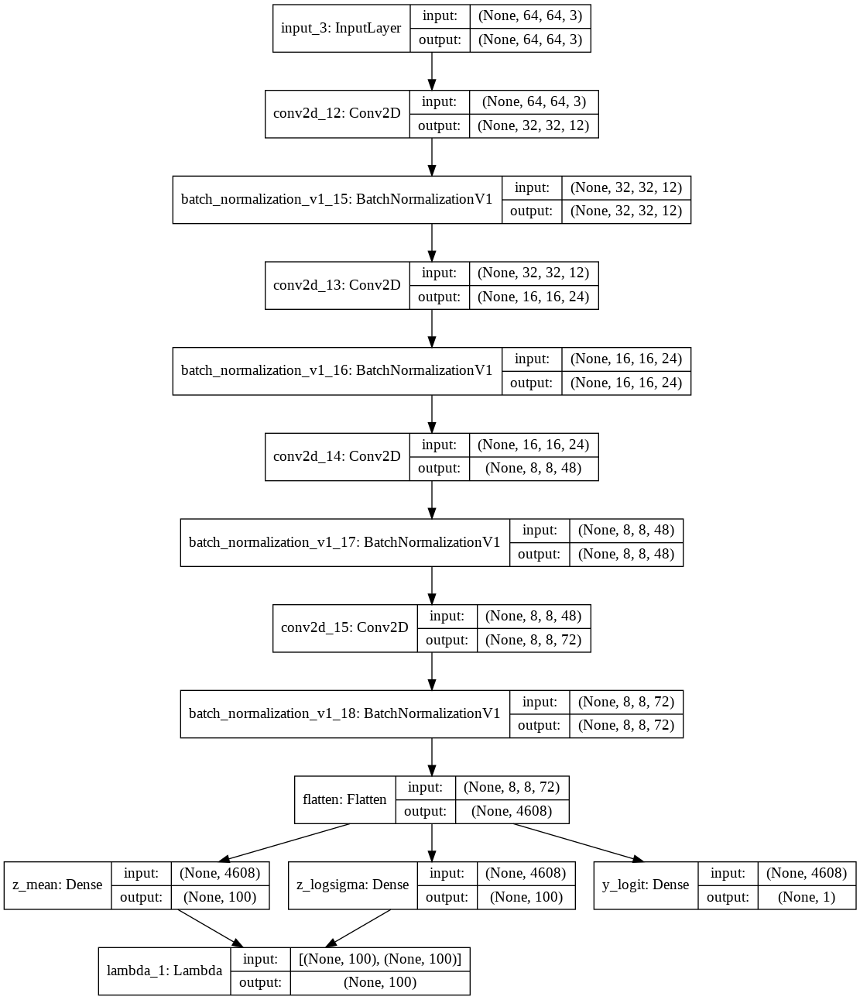

In [36]:
 latent_dim = 100
'''TODO: create the encoder and decoder networks'''
encoder, inputs, outputs, pre_flatten_shape =  make_face_encoder_network()
decoder = make_face_decoder_network(pre_flatten_shape)
# initialize the models
encoder_output = encoder(inputs)
y_logit, z_mean, z_logsigma, z = encoder_output
reconstructed_inputs = decoder(z)

vae = tf.keras.Model(inputs, reconstructed_inputs)
util.display_model(encoder)


In [0]:
# Function to return the means for an input image batch
def get_latent_mu(images, encoder, batch_size=1024):
    N = images.shape[0]
    mu = np.zeros((N, latent_dim))
    for start_ind in xrange(0, N, batch_size):
        end_ind = min(start_ind+batch_size, N+1)
        batch = images[start_ind:end_ind]
        batch = tf.convert_to_tensor(batch, dtype=tf.float32)/255.
        _, batch_mu, _, _ = encoder(batch)
        mu[start_ind:end_ind] = batch_mu
    return mu
  
'''Function that recomputes the sampling probabilities for images within a batch
    based on how they distribute across the '''
def get_training_sample_probabilities(images, encoder, bins=10, smoothing_fac=0.0): 
    print "Recomputing the sampling probabilities"
    
    mu = get_latent_mu(images, encoder)
    # sampling probabilities for the images
    training_sample_p = np.zeros(mu.shape[0])
    
    # consider the distribution for each latent variable 
    for i in range(latent_dim):
      
        latent_distribution = mu[:,i]
        # generate a histogram of the latent distribution
        hist_density, bin_edges =  np.histogram(latent_distribution, density=True, bins=bins)

        # find which latent bin every data sample falls in 
        # https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.digitize.html
        bin_edges[0] = -float('inf')
        bin_edges[-1] = float('inf')
        '''TODO: call the digitize function to find which bins in the latent distribution 
            every data sample falls in to'''
        bin_indices = np.digitize(latent_distribution,bin_edges)

        # smooth the density function [Eq. #]
        hist_smoothed_density = hist_density + smoothing_fac
        hist_smoothed_density = hist_smoothed_density / np.sum(hist_smoothed_density)

        '''TODO: invert the density function to compute the sampling probability!
            HINT: think carefully about the indexing of the bins! What is the length of bin_edges?'''
        p = 1 / (hist_smoothed_density[bin_indices - 1])
        # normalize all probabilities
        p = p / np.sum(p)
        
        # update sampling probabilities 
        training_sample_p = np.maximum(p, training_sample_p)
        
    # final normalization
    training_sample_p /= np.sum(training_sample_p)

    return training_sample_p



Training  and Evaluation of Debiased model (with changing smoothing factor)
--------------------------------------------------

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

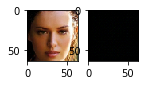

  3%|      |ETA:   0:01:50  Epoch: 0   Iter: 98   Class Loss: 0.16   Loss: 0.27

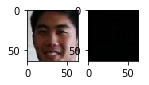

  6%|     |ETA:   0:01:35  Epoch: 0   Iter: 197   Class Loss: 0.14   Loss: 0.27

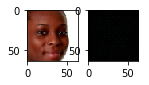

  9%|     |ETA:   0:01:46  Epoch: 0   Iter: 299   Class Loss: 0.16   Loss: 0.31

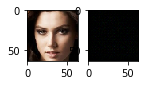

 13%|     |ETA:   0:01:38  Epoch: 0   Iter: 397   Class Loss: 0.00   Loss: 0.14

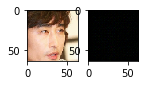

 16%|     |ETA:   0:01:24  Epoch: 0   Iter: 496   Class Loss: 0.03   Loss: 0.18

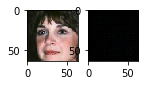

 19%|     |ETA:   0:01:20  Epoch: 0   Iter: 599   Class Loss: 0.02   Loss: 0.18

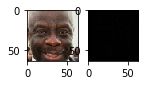

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 699   Class Loss: 0.16   Loss: 0.32

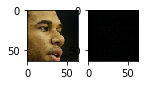

 26%|#    |ETA:   0:01:14  Epoch: 0   Iter: 797   Class Loss: 0.02   Loss: 0.18

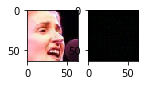

 29%|#    |ETA:   0:01:11  Epoch: 0   Iter: 899   Class Loss: 0.02   Loss: 0.17

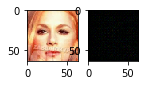

 32%|#    |ETA:   0:01:08  Epoch: 0   Iter: 999   Class Loss: 0.12   Loss: 0.26

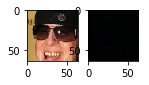

 35%|#   |ETA:   0:01:04  Epoch: 0   Iter: 1098   Class Loss: 0.02   Loss: 0.17

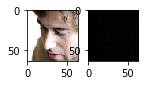

 39%|#   |ETA:   0:01:01  Epoch: 0   Iter: 1198   Class Loss: 0.03   Loss: 0.18

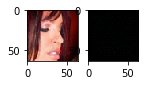

 42%|#   |ETA:   0:00:57  Epoch: 0   Iter: 1298   Class Loss: 0.00   Loss: 0.14

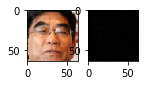

 45%|#   |ETA:   0:00:54  Epoch: 0   Iter: 1399   Class Loss: 0.00   Loss: 0.14

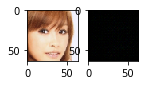

 49%|#   |ETA:   0:00:51  Epoch: 0   Iter: 1498   Class Loss: 0.00   Loss: 0.16

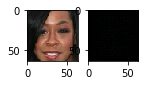

 52%|##  |ETA:   0:00:47  Epoch: 0   Iter: 1599   Class Loss: 0.00   Loss: 0.14

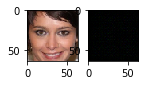

 55%|##  |ETA:   0:00:44  Epoch: 0   Iter: 1699   Class Loss: 0.01   Loss: 0.15

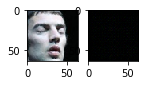

 58%|##  |ETA:   0:00:41  Epoch: 0   Iter: 1798   Class Loss: 0.00   Loss: 0.12

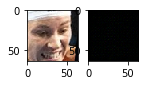

 62%|##  |ETA:   0:00:38  Epoch: 0   Iter: 1897   Class Loss: 0.00   Loss: 0.14

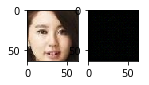

 65%|##  |ETA:   0:00:34  Epoch: 0   Iter: 1996   Class Loss: 0.00   Loss: 0.15

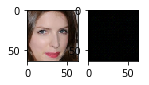

 68%|##  |ETA:   0:00:31  Epoch: 0   Iter: 2096   Class Loss: 0.03   Loss: 0.16

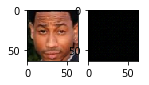

 71%|##  |ETA:   0:00:32  Epoch: 0   Iter: 2197   Class Loss: 0.00   Loss: 0.14

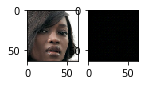

 75%|### |ETA:   0:00:28  Epoch: 0   Iter: 2298   Class Loss: 0.01   Loss: 0.14

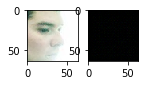

 78%|### |ETA:   0:00:24  Epoch: 0   Iter: 2398   Class Loss: 0.32   Loss: 0.47

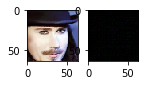

 81%|### |ETA:   0:00:18  Epoch: 0   Iter: 2496   Class Loss: 0.16   Loss: 0.26

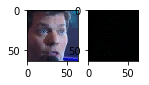

 85%|### |ETA:   0:00:14  Epoch: 0   Iter: 2599   Class Loss: 0.00   Loss: 0.15

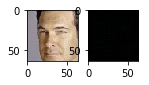

 88%|### |ETA:   0:00:11  Epoch: 0   Iter: 2699   Class Loss: 0.01   Loss: 0.15

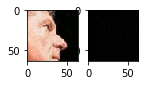

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2799   Class Loss: 0.00   Loss: 0.16

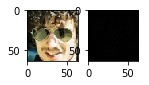

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2897   Class Loss: 0.00   Loss: 0.15

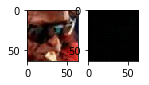

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2996   Class Loss: 0.01   Loss: 0.16

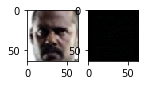

100%|####|Time:  0:01:48  Epoch: 0   Iter: 3052   Class Loss: 0.02   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

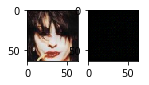

  3%|      |ETA:   0:01:37  Epoch: 1   Iter: 97   Class Loss: 0.01   Loss: 0.14

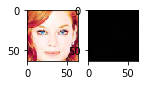

  6%|     |ETA:   0:01:44  Epoch: 1   Iter: 196   Class Loss: 0.00   Loss: 0.16

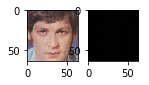

  9%|     |ETA:   0:01:31  Epoch: 1   Iter: 299   Class Loss: 0.01   Loss: 0.13

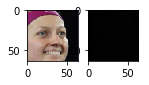

 13%|     |ETA:   0:01:28  Epoch: 1   Iter: 396   Class Loss: 0.00   Loss: 0.14

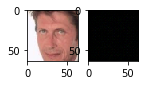

 16%|     |ETA:   0:01:24  Epoch: 1   Iter: 497   Class Loss: 0.00   Loss: 0.15

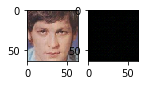

 19%|     |ETA:   0:01:21  Epoch: 1   Iter: 598   Class Loss: 0.00   Loss: 0.15

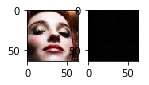

 22%|#    |ETA:   0:01:17  Epoch: 1   Iter: 699   Class Loss: 0.03   Loss: 0.18

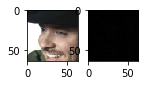

 26%|#    |ETA:   0:01:14  Epoch: 1   Iter: 798   Class Loss: 0.00   Loss: 0.15

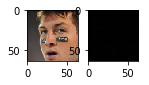

 29%|#    |ETA:   0:01:11  Epoch: 1   Iter: 897   Class Loss: 0.00   Loss: 0.13

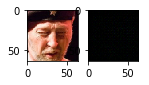

 32%|#    |ETA:   0:01:07  Epoch: 1   Iter: 998   Class Loss: 0.00   Loss: 0.16

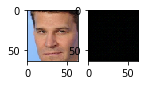

 35%|#   |ETA:   0:01:04  Epoch: 1   Iter: 1097   Class Loss: 0.00   Loss: 0.12

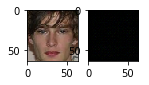

 39%|#   |ETA:   0:01:01  Epoch: 1   Iter: 1197   Class Loss: 0.00   Loss: 0.14

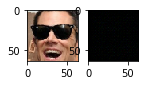

 42%|#   |ETA:   0:00:57  Epoch: 1   Iter: 1296   Class Loss: 0.00   Loss: 0.13

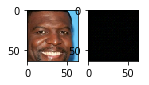

 45%|#   |ETA:   0:01:02  Epoch: 1   Iter: 1397   Class Loss: 0.00   Loss: 0.14

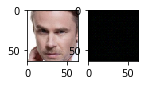

 49%|#   |ETA:   0:00:58  Epoch: 1   Iter: 1498   Class Loss: 0.01   Loss: 0.13

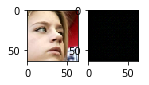

 52%|##  |ETA:   0:00:52  Epoch: 1   Iter: 1599   Class Loss: 0.05   Loss: 0.19

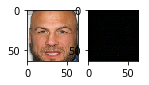

 55%|##  |ETA:   0:00:44  Epoch: 1   Iter: 1699   Class Loss: 0.01   Loss: 0.18

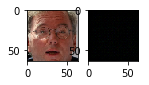

 58%|##  |ETA:   0:00:41  Epoch: 1   Iter: 1799   Class Loss: 0.00   Loss: 0.14

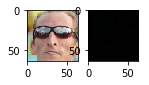

 62%|##  |ETA:   0:00:38  Epoch: 1   Iter: 1897   Class Loss: 0.01   Loss: 0.15

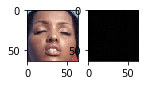

 65%|##  |ETA:   0:00:35  Epoch: 1   Iter: 1998   Class Loss: 0.00   Loss: 0.16

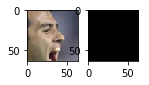

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2097   Class Loss: 0.00   Loss: 0.16

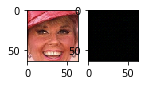

 72%|##  |ETA:   0:00:28  Epoch: 1   Iter: 2199   Class Loss: 0.00   Loss: 0.15

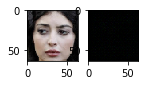

 75%|### |ETA:   0:00:24  Epoch: 1   Iter: 2297   Class Loss: 0.00   Loss: 0.16

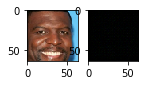

 78%|### |ETA:   0:00:21  Epoch: 1   Iter: 2396   Class Loss: 0.04   Loss: 0.21

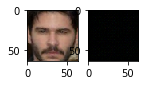

 81%|### |ETA:   0:00:18  Epoch: 1   Iter: 2497   Class Loss: 0.01   Loss: 0.17

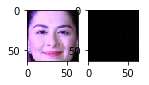

 85%|### |ETA:   0:00:14  Epoch: 1   Iter: 2599   Class Loss: 0.01   Loss: 0.17

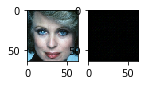

 88%|### |ETA:   0:00:11  Epoch: 1   Iter: 2699   Class Loss: 0.00   Loss: 0.16

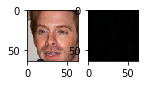

 91%|### |ETA:   0:00:08  Epoch: 1   Iter: 2799   Class Loss: 0.04   Loss: 0.19

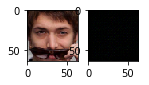

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2898   Class Loss: 0.00   Loss: 0.18

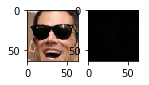

 98%|### |ETA:   0:00:01  Epoch: 1   Iter: 2997   Class Loss: 0.00   Loss: 0.15

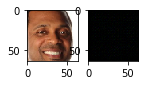

100%|####|Time:  0:01:46  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

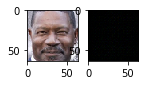

  3%|      |ETA:   0:01:39  Epoch: 2   Iter: 97   Class Loss: 0.03   Loss: 0.18

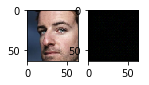

  6%|     |ETA:   0:01:37  Epoch: 2   Iter: 199   Class Loss: 0.00   Loss: 0.16

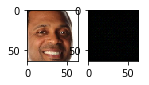

  9%|     |ETA:   0:01:31  Epoch: 2   Iter: 299   Class Loss: 0.00   Loss: 0.14

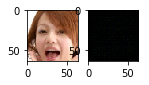

 13%|     |ETA:   0:01:27  Epoch: 2   Iter: 398   Class Loss: 0.00   Loss: 0.13

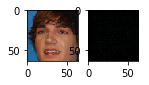

 16%|     |ETA:   0:01:30  Epoch: 2   Iter: 499   Class Loss: 0.00   Loss: 0.16

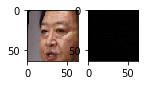

 19%|     |ETA:   0:01:36  Epoch: 2   Iter: 597   Class Loss: 0.00   Loss: 0.15

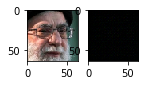

 22%|#    |ETA:   0:01:32  Epoch: 2   Iter: 698   Class Loss: 0.00   Loss: 0.16

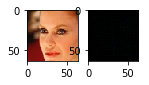

 26%|#    |ETA:   0:01:14  Epoch: 2   Iter: 799   Class Loss: 0.00   Loss: 0.14

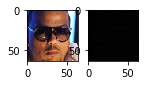

 29%|#    |ETA:   0:01:10  Epoch: 2   Iter: 898   Class Loss: 0.00   Loss: 0.16

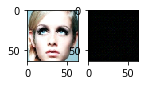

 32%|#    |ETA:   0:01:08  Epoch: 2   Iter: 998   Class Loss: 0.00   Loss: 0.16

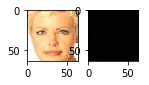

 36%|#   |ETA:   0:01:05  Epoch: 2   Iter: 1099   Class Loss: 0.00   Loss: 0.14

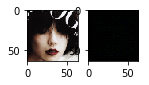

 39%|#   |ETA:   0:01:00  Epoch: 2   Iter: 1197   Class Loss: 0.00   Loss: 0.18

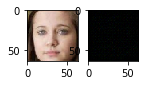

 42%|#   |ETA:   0:00:57  Epoch: 2   Iter: 1296   Class Loss: 0.00   Loss: 0.15

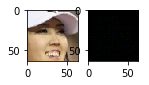

 45%|#   |ETA:   0:00:54  Epoch: 2   Iter: 1397   Class Loss: 0.00   Loss: 0.15

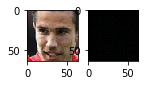

 49%|#   |ETA:   0:00:51  Epoch: 2   Iter: 1499   Class Loss: 0.00   Loss: 0.16

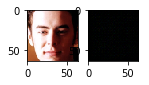

 52%|##  |ETA:   0:00:48  Epoch: 2   Iter: 1596   Class Loss: 0.00   Loss: 0.16

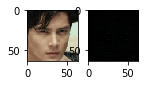

 55%|##  |ETA:   0:00:45  Epoch: 2   Iter: 1696   Class Loss: 0.00   Loss: 0.13

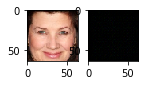

 58%|##  |ETA:   0:00:42  Epoch: 2   Iter: 1798   Class Loss: 0.00   Loss: 0.15

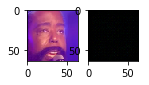

 62%|##  |ETA:   0:00:38  Epoch: 2   Iter: 1899   Class Loss: 0.00   Loss: 0.17

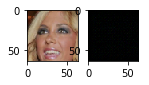

 65%|##  |ETA:   0:00:35  Epoch: 2   Iter: 1999   Class Loss: 0.02   Loss: 0.17

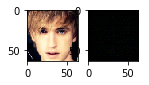

 68%|##  |ETA:   0:00:31  Epoch: 2   Iter: 2097   Class Loss: 0.00   Loss: 0.16

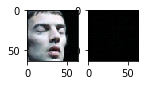

 72%|##  |ETA:   0:00:28  Epoch: 2   Iter: 2198   Class Loss: 0.00   Loss: 0.14

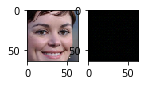

 75%|### |ETA:   0:00:25  Epoch: 2   Iter: 2297   Class Loss: 0.00   Loss: 0.17

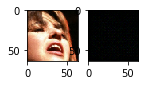

 78%|### |ETA:   0:00:21  Epoch: 2   Iter: 2396   Class Loss: 0.01   Loss: 0.15

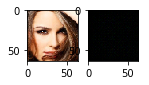

 81%|### |ETA:   0:00:18  Epoch: 2   Iter: 2496   Class Loss: 0.09   Loss: 0.25

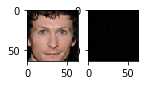

 85%|### |ETA:   0:00:15  Epoch: 2   Iter: 2596   Class Loss: 0.00   Loss: 0.17

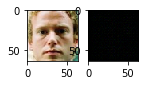

 88%|### |ETA:   0:00:13  Epoch: 2   Iter: 2698   Class Loss: 0.00   Loss: 0.16

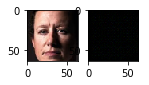

 91%|### |ETA:   0:00:09  Epoch: 2   Iter: 2797   Class Loss: 0.00   Loss: 0.15

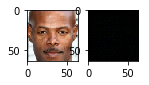

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2897   Class Loss: 0.00   Loss: 0.14

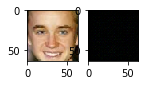

 98%|### |ETA:   0:00:02  Epoch: 2   Iter: 2999   Class Loss: 0.00   Loss: 0.16

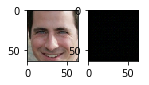

100%|####|Time:  0:01:49  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.16


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

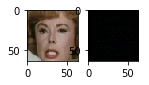

  3%|      |ETA:   0:01:37  Epoch: 3   Iter: 99   Class Loss: 0.00   Loss: 0.15

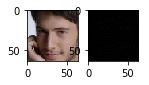

  6%|     |ETA:   0:01:33  Epoch: 3   Iter: 196   Class Loss: 0.00   Loss: 0.14

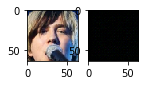

  9%|     |ETA:   0:01:31  Epoch: 3   Iter: 296   Class Loss: 0.02   Loss: 0.18

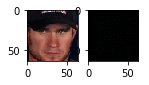

 13%|     |ETA:   0:01:27  Epoch: 3   Iter: 397   Class Loss: 0.01   Loss: 0.17

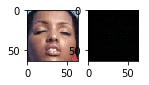

 16%|     |ETA:   0:01:24  Epoch: 3   Iter: 497   Class Loss: 0.00   Loss: 0.16

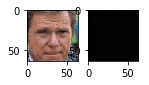

 19%|     |ETA:   0:01:21  Epoch: 3   Iter: 597   Class Loss: 0.00   Loss: 0.16

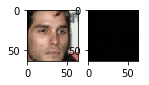

 22%|#    |ETA:   0:01:17  Epoch: 3   Iter: 699   Class Loss: 0.00   Loss: 0.15

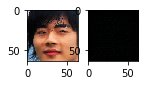

 26%|#    |ETA:   0:01:14  Epoch: 3   Iter: 798   Class Loss: 0.00   Loss: 0.15

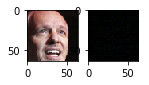

 29%|#    |ETA:   0:01:11  Epoch: 3   Iter: 898   Class Loss: 0.00   Loss: 0.16

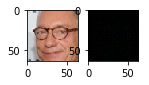

 32%|#    |ETA:   0:01:07  Epoch: 3   Iter: 997   Class Loss: 0.00   Loss: 0.14

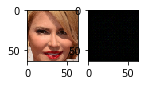

 35%|#   |ETA:   0:01:05  Epoch: 3   Iter: 1098   Class Loss: 0.00   Loss: 0.18

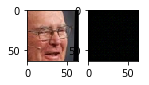

 39%|#   |ETA:   0:01:01  Epoch: 3   Iter: 1198   Class Loss: 0.00   Loss: 0.17

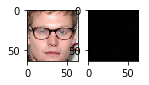

 42%|#   |ETA:   0:00:57  Epoch: 3   Iter: 1298   Class Loss: 0.08   Loss: 0.25

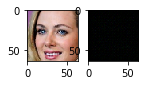

 45%|#   |ETA:   0:00:55  Epoch: 3   Iter: 1397   Class Loss: 0.00   Loss: 0.16

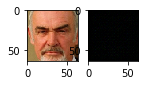

 49%|#   |ETA:   0:00:51  Epoch: 3   Iter: 1496   Class Loss: 0.00   Loss: 0.18

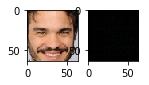

 52%|##  |ETA:   0:00:48  Epoch: 3   Iter: 1598   Class Loss: 0.00   Loss: 0.14

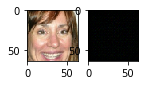

 55%|##  |ETA:   0:00:44  Epoch: 3   Iter: 1698   Class Loss: 0.00   Loss: 0.14

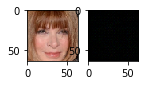

 58%|##  |ETA:   0:00:41  Epoch: 3   Iter: 1798   Class Loss: 0.00   Loss: 0.16

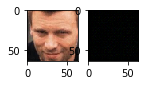

 62%|##  |ETA:   0:00:38  Epoch: 3   Iter: 1897   Class Loss: 0.00   Loss: 0.17

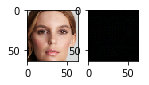

 65%|##  |ETA:   0:00:40  Epoch: 3   Iter: 1997   Class Loss: 0.00   Loss: 0.17

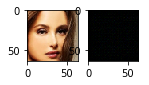

 68%|##  |ETA:   0:00:36  Epoch: 3   Iter: 2098   Class Loss: 0.00   Loss: 0.16

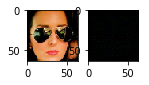

 72%|##  |ETA:   0:00:31  Epoch: 3   Iter: 2198   Class Loss: 0.00   Loss: 0.15

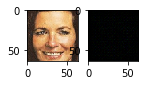

 75%|### |ETA:   0:00:24  Epoch: 3   Iter: 2296   Class Loss: 0.00   Loss: 0.15

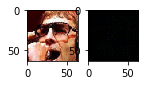

 78%|### |ETA:   0:00:21  Epoch: 3   Iter: 2399   Class Loss: 0.00   Loss: 0.17

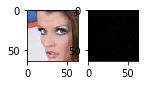

 81%|### |ETA:   0:00:18  Epoch: 3   Iter: 2498   Class Loss: 0.01   Loss: 0.19

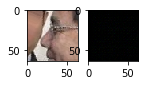

 85%|### |ETA:   0:00:15  Epoch: 3   Iter: 2596   Class Loss: 0.00   Loss: 0.15

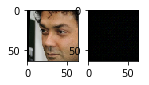

 88%|### |ETA:   0:00:13  Epoch: 3   Iter: 2697   Class Loss: 0.00   Loss: 0.15

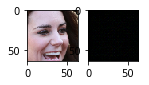

 91%|### |ETA:   0:00:08  Epoch: 3   Iter: 2798   Class Loss: 0.00   Loss: 0.17

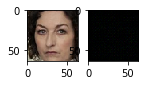

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2897   Class Loss: 0.00   Loss: 0.16

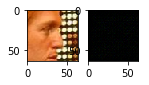

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2997   Class Loss: 0.00   Loss: 0.15

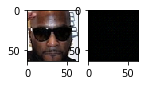

100%|####|Time:  0:01:46  Epoch: 3   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

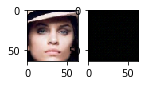

  3%|      |ETA:   0:01:37  Epoch: 4   Iter: 96   Class Loss: 0.00   Loss: 0.17

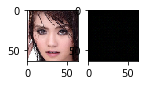

  6%|     |ETA:   0:01:34  Epoch: 4   Iter: 196   Class Loss: 0.00   Loss: 0.15

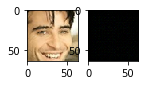

  9%|     |ETA:   0:01:30  Epoch: 4   Iter: 297   Class Loss: 0.00   Loss: 0.18

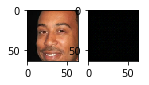

 13%|     |ETA:   0:01:28  Epoch: 4   Iter: 396   Class Loss: 0.00   Loss: 0.16

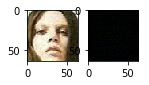

 16%|     |ETA:   0:01:25  Epoch: 4   Iter: 496   Class Loss: 0.00   Loss: 0.17

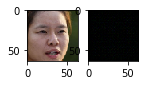

 19%|     |ETA:   0:01:21  Epoch: 4   Iter: 598   Class Loss: 0.00   Loss: 0.14

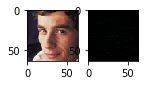

 22%|#    |ETA:   0:01:17  Epoch: 4   Iter: 699   Class Loss: 0.01   Loss: 0.17

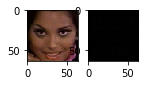

 26%|#    |ETA:   0:01:15  Epoch: 4   Iter: 799   Class Loss: 0.00   Loss: 0.17

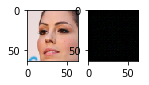

 29%|#    |ETA:   0:01:11  Epoch: 4   Iter: 896   Class Loss: 0.00   Loss: 0.17

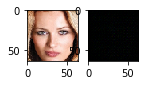

 32%|#    |ETA:   0:01:07  Epoch: 4   Iter: 999   Class Loss: 0.00   Loss: 0.15

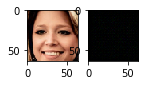

 35%|#   |ETA:   0:01:05  Epoch: 4   Iter: 1097   Class Loss: 0.00   Loss: 0.16

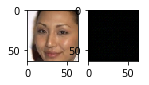

 39%|#   |ETA:   0:01:09  Epoch: 4   Iter: 1198   Class Loss: 0.03   Loss: 0.18

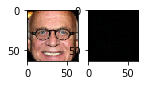

 42%|#   |ETA:   0:01:06  Epoch: 4   Iter: 1298   Class Loss: 0.00   Loss: 0.15

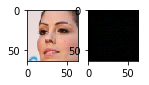

 45%|#   |ETA:   0:00:56  Epoch: 4   Iter: 1399   Class Loss: 0.00   Loss: 0.17

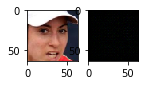

 49%|#   |ETA:   0:00:50  Epoch: 4   Iter: 1498   Class Loss: 0.00   Loss: 0.16

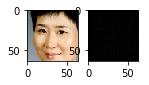

 52%|##  |ETA:   0:00:48  Epoch: 4   Iter: 1597   Class Loss: 0.00   Loss: 0.15

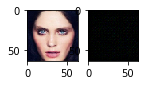

 55%|##  |ETA:   0:00:44  Epoch: 4   Iter: 1697   Class Loss: 0.00   Loss: 0.14

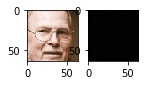

 58%|##  |ETA:   0:00:41  Epoch: 4   Iter: 1799   Class Loss: 0.00   Loss: 0.14

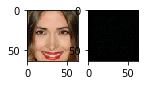

 62%|##  |ETA:   0:00:38  Epoch: 4   Iter: 1897   Class Loss: 0.00   Loss: 0.15

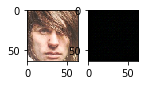

 65%|##  |ETA:   0:00:34  Epoch: 4   Iter: 1998   Class Loss: 0.00   Loss: 0.13

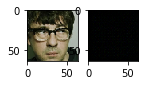

 68%|##  |ETA:   0:00:31  Epoch: 4   Iter: 2096   Class Loss: 0.01   Loss: 0.15

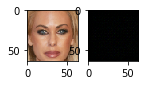

 71%|##  |ETA:   0:00:28  Epoch: 4   Iter: 2197   Class Loss: 0.00   Loss: 0.15

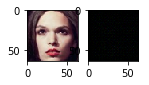

 75%|### |ETA:   0:00:24  Epoch: 4   Iter: 2298   Class Loss: 0.00   Loss: 0.15

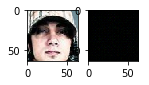

 78%|### |ETA:   0:00:21  Epoch: 4   Iter: 2399   Class Loss: 0.00   Loss: 0.16

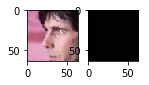

 81%|### |ETA:   0:00:20  Epoch: 4   Iter: 2498   Class Loss: 0.00   Loss: 0.16

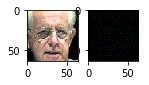

 85%|### |ETA:   0:00:15  Epoch: 4   Iter: 2596   Class Loss: 0.00   Loss: 0.16

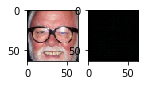

 88%|### |ETA:   0:00:11  Epoch: 4   Iter: 2696   Class Loss: 0.00   Loss: 0.17

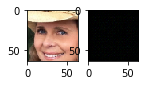

 91%|### |ETA:   0:00:08  Epoch: 4   Iter: 2797   Class Loss: 0.00   Loss: 0.17

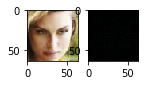

 94%|### |ETA:   0:00:05  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.16

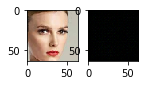

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2997   Class Loss: 0.00   Loss: 0.16

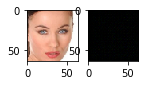

100%|####|Time:  0:01:46  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

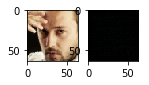

  3%|      |ETA:   0:01:55  Epoch: 5   Iter: 98   Class Loss: 0.01   Loss: 0.18

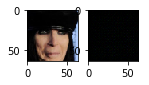

  6%|     |ETA:   0:01:48  Epoch: 5   Iter: 196   Class Loss: 0.05   Loss: 0.19

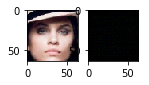

  9%|     |ETA:   0:01:43  Epoch: 5   Iter: 299   Class Loss: 0.00   Loss: 0.14

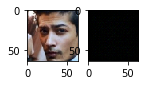

 13%|     |ETA:   0:01:40  Epoch: 5   Iter: 398   Class Loss: 0.00   Loss: 0.16

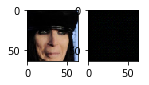

 16%|     |ETA:   0:01:33  Epoch: 5   Iter: 498   Class Loss: 0.00   Loss: 0.15

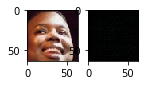

 19%|     |ETA:   0:01:21  Epoch: 5   Iter: 598   Class Loss: 0.00   Loss: 0.14

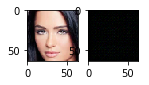

 22%|#    |ETA:   0:01:18  Epoch: 5   Iter: 698   Class Loss: 0.00   Loss: 0.15

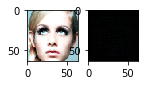

 26%|#    |ETA:   0:01:13  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.17

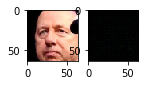

 29%|#    |ETA:   0:01:10  Epoch: 5   Iter: 898   Class Loss: 0.00   Loss: 0.15

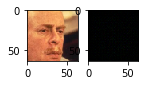

 32%|#    |ETA:   0:01:08  Epoch: 5   Iter: 999   Class Loss: 0.00   Loss: 0.16

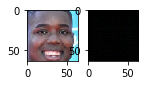

 35%|#   |ETA:   0:01:04  Epoch: 5   Iter: 1096   Class Loss: 0.00   Loss: 0.15

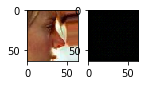

 39%|#   |ETA:   0:01:01  Epoch: 5   Iter: 1198   Class Loss: 0.00   Loss: 0.15

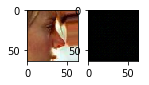

 42%|#   |ETA:   0:00:58  Epoch: 5   Iter: 1297   Class Loss: 0.00   Loss: 0.16

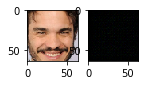

 45%|#   |ETA:   0:00:54  Epoch: 5   Iter: 1398   Class Loss: 0.00   Loss: 0.15

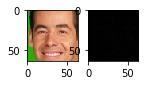

 49%|#   |ETA:   0:00:51  Epoch: 5   Iter: 1499   Class Loss: 0.00   Loss: 0.16

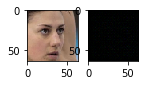

 52%|##  |ETA:   0:00:47  Epoch: 5   Iter: 1596   Class Loss: 0.00   Loss: 0.14

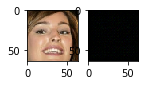

 55%|##  |ETA:   0:00:45  Epoch: 5   Iter: 1697   Class Loss: 0.00   Loss: 0.17

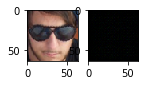

 58%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1799   Class Loss: 0.00   Loss: 0.16

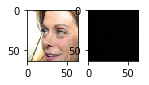

 62%|##  |ETA:   0:00:38  Epoch: 5   Iter: 1897   Class Loss: 0.00   Loss: 0.16

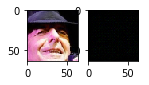

 65%|##  |ETA:   0:00:40  Epoch: 5   Iter: 1997   Class Loss: 0.06   Loss: 0.20

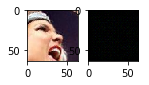

 68%|##  |ETA:   0:00:33  Epoch: 5   Iter: 2097   Class Loss: 0.00   Loss: 0.17

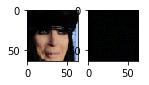

 71%|##  |ETA:   0:00:28  Epoch: 5   Iter: 2196   Class Loss: 0.00   Loss: 0.15

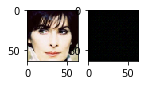

 75%|### |ETA:   0:00:27  Epoch: 5   Iter: 2299   Class Loss: 0.00   Loss: 0.15

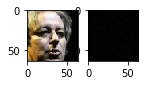

 78%|### |ETA:   0:00:21  Epoch: 5   Iter: 2396   Class Loss: 0.00   Loss: 0.14

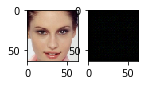

 81%|### |ETA:   0:00:18  Epoch: 5   Iter: 2496   Class Loss: 0.00   Loss: 0.15

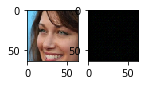

 85%|### |ETA:   0:00:17  Epoch: 5   Iter: 2598   Class Loss: 0.00   Loss: 0.16

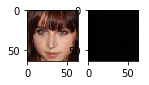

 88%|### |ETA:   0:00:13  Epoch: 5   Iter: 2699   Class Loss: 0.00   Loss: 0.16

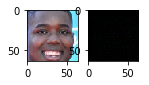

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2798   Class Loss: 0.00   Loss: 0.18

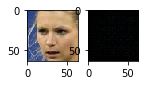

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2898   Class Loss: 0.00   Loss: 0.18

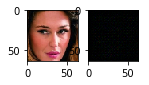

 98%|### |ETA:   0:00:01  Epoch: 5   Iter: 2998   Class Loss: 0.00   Loss: 0.16

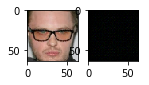

100%|####|Time:  0:01:49  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

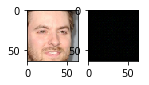

  3%|      |ETA:   0:01:37  Epoch: 6   Iter: 96   Class Loss: 0.00   Loss: 0.17

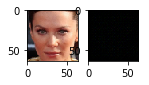

  6%|     |ETA:   0:01:34  Epoch: 6   Iter: 197   Class Loss: 0.00   Loss: 0.14

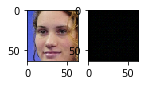

  9%|     |ETA:   0:01:31  Epoch: 6   Iter: 298   Class Loss: 0.30   Loss: 0.45

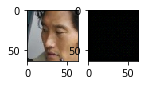

 13%|     |ETA:   0:01:27  Epoch: 6   Iter: 396   Class Loss: 0.03   Loss: 0.18

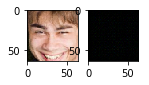

 16%|     |ETA:   0:01:24  Epoch: 6   Iter: 499   Class Loss: 0.00   Loss: 0.15

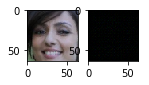

 19%|     |ETA:   0:01:21  Epoch: 6   Iter: 598   Class Loss: 0.00   Loss: 0.17

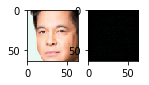

 22%|#    |ETA:   0:01:17  Epoch: 6   Iter: 699   Class Loss: 0.00   Loss: 0.15

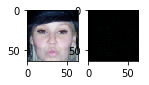

 26%|#    |ETA:   0:01:14  Epoch: 6   Iter: 798   Class Loss: 0.00   Loss: 0.16

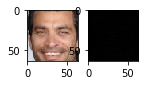

 29%|#    |ETA:   0:01:10  Epoch: 6   Iter: 899   Class Loss: 0.01   Loss: 0.16

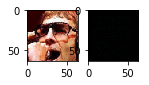

 32%|#    |ETA:   0:01:07  Epoch: 6   Iter: 999   Class Loss: 0.00   Loss: 0.17

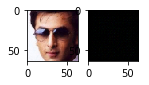

 35%|#   |ETA:   0:01:04  Epoch: 6   Iter: 1097   Class Loss: 0.00   Loss: 0.16

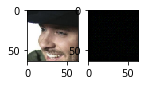

 39%|#   |ETA:   0:01:01  Epoch: 6   Iter: 1198   Class Loss: 0.00   Loss: 0.15

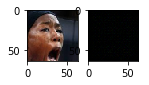

 42%|#   |ETA:   0:00:58  Epoch: 6   Iter: 1299   Class Loss: 0.00   Loss: 0.16

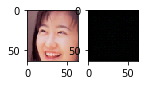

 45%|#   |ETA:   0:00:55  Epoch: 6   Iter: 1398   Class Loss: 0.00   Loss: 0.17

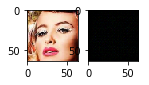

 49%|#   |ETA:   0:00:51  Epoch: 6   Iter: 1497   Class Loss: 0.00   Loss: 0.15

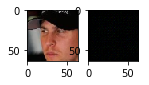

 52%|##  |ETA:   0:00:48  Epoch: 6   Iter: 1597   Class Loss: 0.00   Loss: 0.16

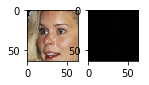

 55%|##  |ETA:   0:00:47  Epoch: 6   Iter: 1697   Class Loss: 0.00   Loss: 0.16

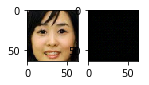

 58%|##  |ETA:   0:00:47  Epoch: 6   Iter: 1798   Class Loss: 0.00   Loss: 0.17

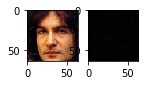

 62%|##  |ETA:   0:00:43  Epoch: 6   Iter: 1899   Class Loss: 0.00   Loss: 0.20

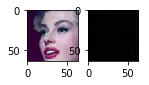

 65%|##  |ETA:   0:00:34  Epoch: 6   Iter: 1996   Class Loss: 0.00   Loss: 0.15

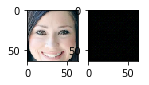

 68%|##  |ETA:   0:00:35  Epoch: 6   Iter: 2096   Class Loss: 0.00   Loss: 0.15

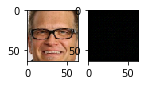

 72%|##  |ETA:   0:00:28  Epoch: 6   Iter: 2198   Class Loss: 0.00   Loss: 0.15

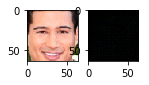

 75%|### |ETA:   0:00:24  Epoch: 6   Iter: 2298   Class Loss: 0.00   Loss: 0.17

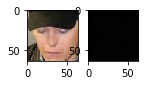

 78%|### |ETA:   0:00:21  Epoch: 6   Iter: 2396   Class Loss: 0.00   Loss: 0.16

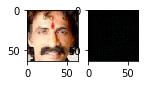

 81%|### |ETA:   0:00:18  Epoch: 6   Iter: 2498   Class Loss: 0.00   Loss: 0.18

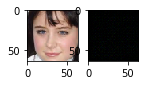

 85%|### |ETA:   0:00:15  Epoch: 6   Iter: 2598   Class Loss: 0.00   Loss: 0.15

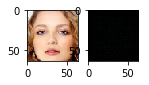

 88%|### |ETA:   0:00:11  Epoch: 6   Iter: 2697   Class Loss: 0.00   Loss: 0.14

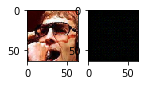

 91%|### |ETA:   0:00:08  Epoch: 6   Iter: 2797   Class Loss: 0.00   Loss: 0.17

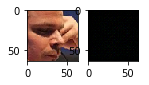

 94%|### |ETA:   0:00:05  Epoch: 6   Iter: 2898   Class Loss: 0.00   Loss: 0.15

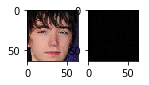

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2998   Class Loss: 0.00   Loss: 0.16

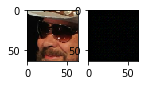

100%|####|Time:  0:01:46  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

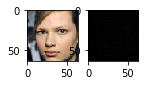

  3%|      |ETA:   0:01:36  Epoch: 7   Iter: 96   Class Loss: 0.00   Loss: 0.14

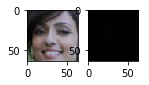

  6%|     |ETA:   0:01:35  Epoch: 7   Iter: 197   Class Loss: 0.00   Loss: 0.14

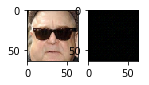

  9%|     |ETA:   0:01:32  Epoch: 7   Iter: 296   Class Loss: 0.00   Loss: 0.14

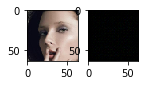

 13%|     |ETA:   0:01:28  Epoch: 7   Iter: 397   Class Loss: 0.00   Loss: 0.16

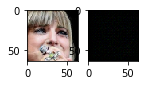

 16%|     |ETA:   0:01:24  Epoch: 7   Iter: 498   Class Loss: 0.00   Loss: 0.17

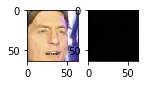

 19%|     |ETA:   0:01:21  Epoch: 7   Iter: 597   Class Loss: 0.00   Loss: 0.14

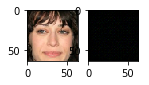

 22%|#    |ETA:   0:01:17  Epoch: 7   Iter: 699   Class Loss: 0.00   Loss: 0.17

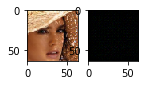

 26%|#    |ETA:   0:01:14  Epoch: 7   Iter: 799   Class Loss: 0.00   Loss: 0.14

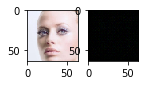

 29%|#    |ETA:   0:01:20  Epoch: 7   Iter: 897   Class Loss: 0.00   Loss: 0.15

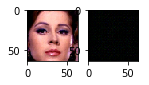

 32%|#    |ETA:   0:01:17  Epoch: 7   Iter: 999   Class Loss: 0.00   Loss: 0.14

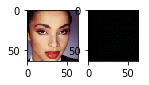

 36%|#   |ETA:   0:01:13  Epoch: 7   Iter: 1099   Class Loss: 0.00   Loss: 0.18

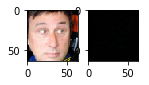

 39%|#   |ETA:   0:01:00  Epoch: 7   Iter: 1197   Class Loss: 0.00   Loss: 0.14

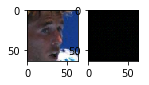

 42%|#   |ETA:   0:00:58  Epoch: 7   Iter: 1297   Class Loss: 0.00   Loss: 0.16

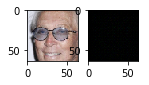

 45%|#   |ETA:   0:00:54  Epoch: 7   Iter: 1399   Class Loss: 0.12   Loss: 0.27

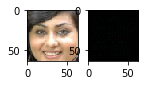

 49%|#   |ETA:   0:00:51  Epoch: 7   Iter: 1498   Class Loss: 0.00   Loss: 0.16

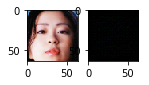

 52%|##  |ETA:   0:00:48  Epoch: 7   Iter: 1599   Class Loss: 0.00   Loss: 0.13

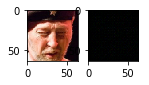

 55%|##  |ETA:   0:00:44  Epoch: 7   Iter: 1697   Class Loss: 0.00   Loss: 0.16

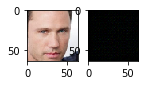

 58%|##  |ETA:   0:00:41  Epoch: 7   Iter: 1797   Class Loss: 0.01   Loss: 0.18

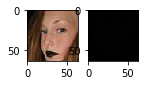

 62%|##  |ETA:   0:00:42  Epoch: 7   Iter: 1896   Class Loss: 0.00   Loss: 0.17

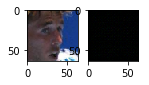

 65%|##  |ETA:   0:00:35  Epoch: 7   Iter: 1998   Class Loss: 0.00   Loss: 0.16

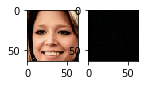

 68%|##  |ETA:   0:00:31  Epoch: 7   Iter: 2096   Class Loss: 0.00   Loss: 0.15

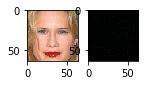

 72%|##  |ETA:   0:00:28  Epoch: 7   Iter: 2199   Class Loss: 0.00   Loss: 0.16

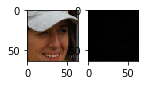

 75%|### |ETA:   0:00:25  Epoch: 7   Iter: 2298   Class Loss: 0.00   Loss: 0.15

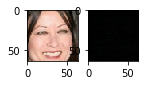

 78%|### |ETA:   0:00:21  Epoch: 7   Iter: 2399   Class Loss: 0.00   Loss: 0.18

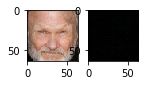

 81%|### |ETA:   0:00:20  Epoch: 7   Iter: 2499   Class Loss: 0.00   Loss: 0.14

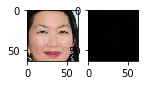

 85%|### |ETA:   0:00:17  Epoch: 7   Iter: 2598   Class Loss: 0.01   Loss: 0.16

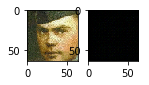

 88%|### |ETA:   0:00:13  Epoch: 7   Iter: 2699   Class Loss: 0.00   Loss: 0.17

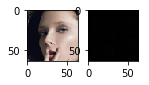

 91%|### |ETA:   0:00:08  Epoch: 7   Iter: 2796   Class Loss: 0.00   Loss: 0.16

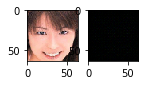

 94%|### |ETA:   0:00:05  Epoch: 7   Iter: 2898   Class Loss: 0.00   Loss: 0.16

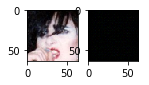

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2999   Class Loss: 0.00   Loss: 0.18

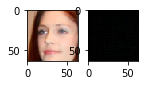

100%|####|Time:  0:01:48  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

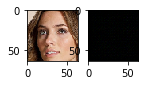

  3%|      |ETA:   0:01:52  Epoch: 8   Iter: 98   Class Loss: 0.00   Loss: 0.16

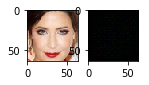

  6%|     |ETA:   0:01:48  Epoch: 8   Iter: 199   Class Loss: 0.00   Loss: 0.17

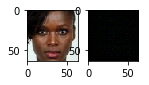

  9%|     |ETA:   0:01:31  Epoch: 8   Iter: 297   Class Loss: 0.00   Loss: 0.16

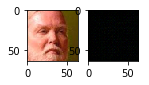

 13%|     |ETA:   0:01:28  Epoch: 8   Iter: 397   Class Loss: 0.00   Loss: 0.15

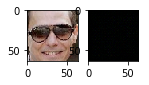

 16%|     |ETA:   0:01:24  Epoch: 8   Iter: 497   Class Loss: 0.00   Loss: 0.16

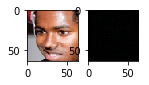

 19%|     |ETA:   0:01:21  Epoch: 8   Iter: 599   Class Loss: 0.00   Loss: 0.14

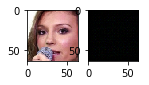

 22%|#    |ETA:   0:01:18  Epoch: 8   Iter: 699   Class Loss: 0.00   Loss: 0.15

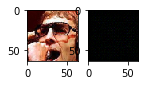

 26%|#    |ETA:   0:01:13  Epoch: 8   Iter: 798   Class Loss: 0.00   Loss: 0.16

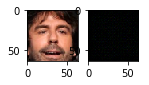

 29%|#    |ETA:   0:01:10  Epoch: 8   Iter: 899   Class Loss: 0.00   Loss: 0.15

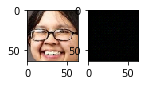

 32%|#    |ETA:   0:01:07  Epoch: 8   Iter: 997   Class Loss: 0.00   Loss: 0.17

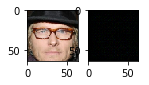

 35%|#   |ETA:   0:01:04  Epoch: 8   Iter: 1097   Class Loss: 0.00   Loss: 0.17

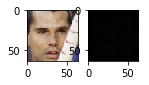

 39%|#   |ETA:   0:01:03  Epoch: 8   Iter: 1198   Class Loss: 0.00   Loss: 0.16

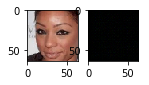

 42%|#   |ETA:   0:01:08  Epoch: 8   Iter: 1298   Class Loss: 0.00   Loss: 0.16

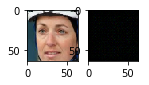

 45%|#   |ETA:   0:00:54  Epoch: 8   Iter: 1398   Class Loss: 0.00   Loss: 0.15

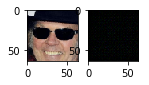

 49%|#   |ETA:   0:00:51  Epoch: 8   Iter: 1499   Class Loss: 0.00   Loss: 0.15

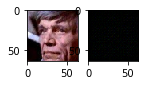

 52%|##  |ETA:   0:00:48  Epoch: 8   Iter: 1598   Class Loss: 0.00   Loss: 0.15

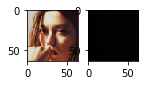

 55%|##  |ETA:   0:00:49  Epoch: 8   Iter: 1699   Class Loss: 0.00   Loss: 0.14

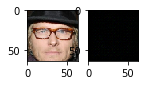

 58%|##  |ETA:   0:00:41  Epoch: 8   Iter: 1798   Class Loss: 0.00   Loss: 0.14

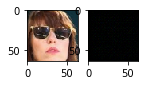

 62%|##  |ETA:   0:00:38  Epoch: 8   Iter: 1897   Class Loss: 0.00   Loss: 0.14

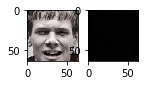

 65%|##  |ETA:   0:00:35  Epoch: 8   Iter: 1997   Class Loss: 0.00   Loss: 0.17

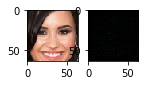

 68%|##  |ETA:   0:00:31  Epoch: 8   Iter: 2097   Class Loss: 0.00   Loss: 0.18

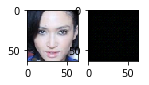

 71%|##  |ETA:   0:00:28  Epoch: 8   Iter: 2197   Class Loss: 0.00   Loss: 0.15

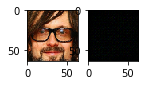

 75%|### |ETA:   0:00:28  Epoch: 8   Iter: 2297   Class Loss: 0.00   Loss: 0.17

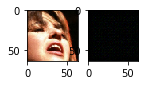

 78%|### |ETA:   0:00:24  Epoch: 8   Iter: 2399   Class Loss: 0.00   Loss: 0.17

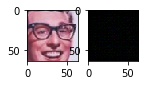

 81%|### |ETA:   0:00:20  Epoch: 8   Iter: 2496   Class Loss: 0.00   Loss: 0.16

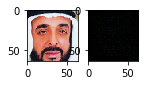

 85%|### |ETA:   0:00:15  Epoch: 8   Iter: 2599   Class Loss: 0.03   Loss: 0.17

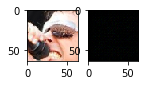

 88%|### |ETA:   0:00:11  Epoch: 8   Iter: 2698   Class Loss: 0.00   Loss: 0.16

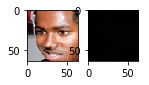

 91%|### |ETA:   0:00:08  Epoch: 8   Iter: 2797   Class Loss: 0.00   Loss: 0.16

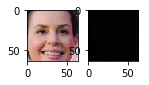

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2898   Class Loss: 0.00   Loss: 0.15

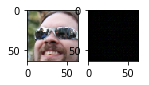

 98%|### |ETA:   0:00:01  Epoch: 8   Iter: 2998   Class Loss: 0.00   Loss: 0.17

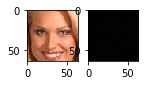

100%|####|Time:  0:01:48  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

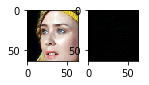

  3%|      |ETA:   0:01:37  Epoch: 9   Iter: 96   Class Loss: 0.00   Loss: 0.15

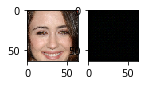

  6%|     |ETA:   0:01:34  Epoch: 9   Iter: 196   Class Loss: 0.00   Loss: 0.17

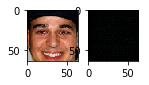

  9%|     |ETA:   0:01:30  Epoch: 9   Iter: 296   Class Loss: 0.00   Loss: 0.15

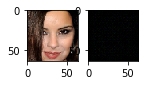

 13%|     |ETA:   0:01:28  Epoch: 9   Iter: 397   Class Loss: 0.00   Loss: 0.15

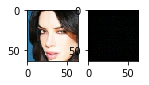

 16%|     |ETA:   0:01:23  Epoch: 9   Iter: 498   Class Loss: 0.00   Loss: 0.14

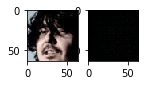

 19%|     |ETA:   0:01:21  Epoch: 9   Iter: 598   Class Loss: 0.00   Loss: 0.15

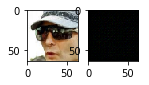

 22%|#    |ETA:   0:01:17  Epoch: 9   Iter: 699   Class Loss: 0.00   Loss: 0.15

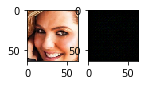

 26%|#    |ETA:   0:01:14  Epoch: 9   Iter: 798   Class Loss: 0.00   Loss: 0.15

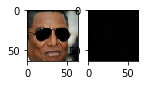

 29%|#    |ETA:   0:01:11  Epoch: 9   Iter: 898   Class Loss: 0.00   Loss: 0.15

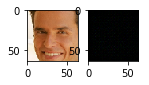

 32%|#    |ETA:   0:01:08  Epoch: 9   Iter: 999   Class Loss: 0.00   Loss: 0.16

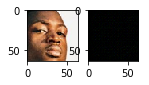

 35%|#   |ETA:   0:01:04  Epoch: 9   Iter: 1097   Class Loss: 0.00   Loss: 0.16

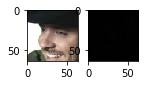

 39%|#   |ETA:   0:01:01  Epoch: 9   Iter: 1198   Class Loss: 0.00   Loss: 0.15

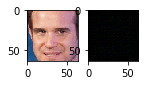

 42%|#   |ETA:   0:00:58  Epoch: 9   Iter: 1299   Class Loss: 0.00   Loss: 0.13

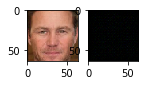

 45%|#   |ETA:   0:00:54  Epoch: 9   Iter: 1399   Class Loss: 0.00   Loss: 0.16

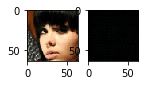

 49%|#   |ETA:   0:00:58  Epoch: 9   Iter: 1498   Class Loss: 0.00   Loss: 0.17

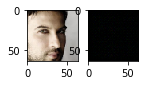

 52%|##  |ETA:   0:00:55  Epoch: 9   Iter: 1599   Class Loss: 0.11   Loss: 0.27

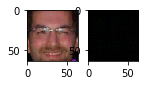

 55%|##  |ETA:   0:00:48  Epoch: 9   Iter: 1697   Class Loss: 0.00   Loss: 0.15

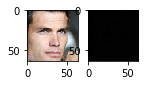

 58%|##  |ETA:   0:00:41  Epoch: 9   Iter: 1799   Class Loss: 0.00   Loss: 0.14

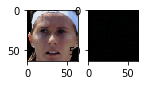

 62%|##  |ETA:   0:00:38  Epoch: 9   Iter: 1896   Class Loss: 0.00   Loss: 0.16

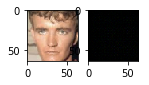

 65%|##  |ETA:   0:00:34  Epoch: 9   Iter: 1996   Class Loss: 0.00   Loss: 0.17

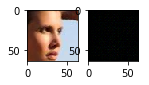

 68%|##  |ETA:   0:00:31  Epoch: 9   Iter: 2096   Class Loss: 0.00   Loss: 0.15

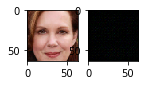

 72%|##  |ETA:   0:00:28  Epoch: 9   Iter: 2199   Class Loss: 0.00   Loss: 0.17

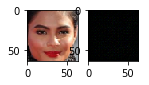

 75%|### |ETA:   0:00:24  Epoch: 9   Iter: 2296   Class Loss: 0.08   Loss: 0.24

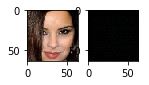

 78%|### |ETA:   0:00:21  Epoch: 9   Iter: 2396   Class Loss: 0.00   Loss: 0.15

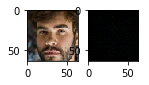

 81%|### |ETA:   0:00:18  Epoch: 9   Iter: 2499   Class Loss: 0.00   Loss: 0.16

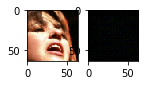

 85%|### |ETA:   0:00:14  Epoch: 9   Iter: 2596   Class Loss: 0.00   Loss: 0.16

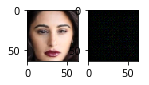

 88%|### |ETA:   0:00:11  Epoch: 9   Iter: 2696   Class Loss: 0.00   Loss: 0.17

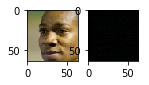

 91%|### |ETA:   0:00:08  Epoch: 9   Iter: 2798   Class Loss: 0.00   Loss: 0.15

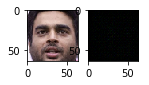

 94%|### |ETA:   0:00:05  Epoch: 9   Iter: 2897   Class Loss: 0.00   Loss: 0.15

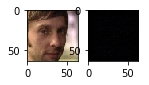

 98%|### |ETA:   0:00:01  Epoch: 9   Iter: 2998   Class Loss: 0.00   Loss: 0.15

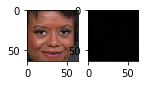

100%|####|Time:  0:01:46  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.16


In [38]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.0)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)



100% (97 of 97) |########################| Elapsed Time: 0:01:09 Time:  0:01:09
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 1.0


100% (72 of 72) |########################| Elapsed Time: 0:00:52 Time:  0:00:52
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.972222222222


100% (78 of 78) |########################| Elapsed Time: 0:00:52 Time:  0:00:52
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.884615384615


100% (71 of 71) |########################| Elapsed Time: 0:00:49 Time:  0:00:49



female darker: 0.943661971831


Text(0,0.5,'Accuracy')

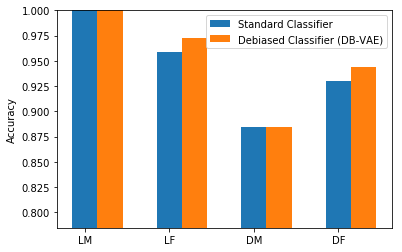

In [39]:
# Evaluate on PPB dataset (takes ~4 minutes)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

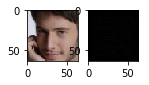

  3%|      |ETA:   0:01:36  Epoch: 0   Iter: 96   Class Loss: 0.00   Loss: 0.14

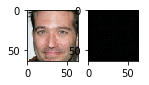

  6%|     |ETA:   0:01:33  Epoch: 0   Iter: 196   Class Loss: 0.00   Loss: 0.17

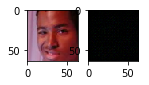

  9%|     |ETA:   0:01:31  Epoch: 0   Iter: 298   Class Loss: 0.00   Loss: 0.16

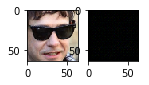

 13%|     |ETA:   0:01:27  Epoch: 0   Iter: 397   Class Loss: 0.00   Loss: 0.14

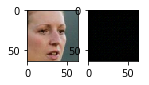

 16%|     |ETA:   0:01:23  Epoch: 0   Iter: 498   Class Loss: 0.00   Loss: 0.16

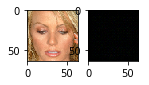

 19%|     |ETA:   0:01:20  Epoch: 0   Iter: 597   Class Loss: 0.00   Loss: 0.16

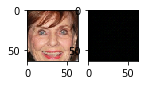

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 699   Class Loss: 0.00   Loss: 0.16

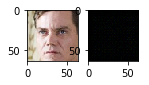

 26%|#    |ETA:   0:01:14  Epoch: 0   Iter: 798   Class Loss: 0.00   Loss: 0.14

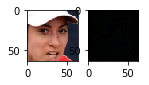

 29%|#    |ETA:   0:01:10  Epoch: 0   Iter: 899   Class Loss: 0.00   Loss: 0.17

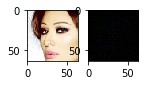

 32%|#    |ETA:   0:01:07  Epoch: 0   Iter: 996   Class Loss: 0.00   Loss: 0.16

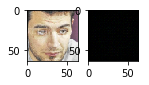

 35%|#   |ETA:   0:01:18  Epoch: 0   Iter: 1097   Class Loss: 0.00   Loss: 0.15

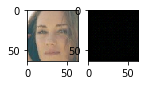

 39%|#   |ETA:   0:01:10  Epoch: 0   Iter: 1198   Class Loss: 0.18   Loss: 0.33

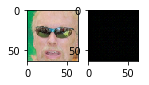

 42%|#   |ETA:   0:01:05  Epoch: 0   Iter: 1298   Class Loss: 0.01   Loss: 0.15

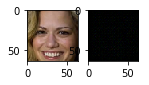

 45%|#   |ETA:   0:00:54  Epoch: 0   Iter: 1397   Class Loss: 0.00   Loss: 0.15

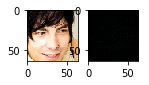

 49%|#   |ETA:   0:00:51  Epoch: 0   Iter: 1498   Class Loss: 0.00   Loss: 0.18

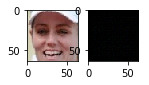

 52%|##  |ETA:   0:00:47  Epoch: 0   Iter: 1596   Class Loss: 0.00   Loss: 0.14

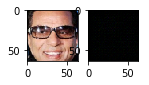

 55%|##  |ETA:   0:00:44  Epoch: 0   Iter: 1698   Class Loss: 0.00   Loss: 0.15

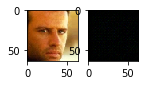

 58%|##  |ETA:   0:00:41  Epoch: 0   Iter: 1799   Class Loss: 0.00   Loss: 0.17

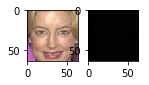

 62%|##  |ETA:   0:00:37  Epoch: 0   Iter: 1897   Class Loss: 0.00   Loss: 0.15

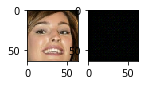

 65%|##  |ETA:   0:00:34  Epoch: 0   Iter: 1999   Class Loss: 0.00   Loss: 0.14

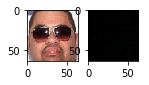

 68%|##  |ETA:   0:00:31  Epoch: 0   Iter: 2098   Class Loss: 0.00   Loss: 0.15

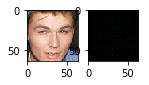

 72%|##  |ETA:   0:00:28  Epoch: 0   Iter: 2198   Class Loss: 0.00   Loss: 0.16

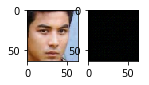

 75%|### |ETA:   0:00:24  Epoch: 0   Iter: 2297   Class Loss: 0.00   Loss: 0.13

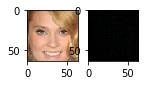

 78%|### |ETA:   0:00:21  Epoch: 0   Iter: 2396   Class Loss: 0.00   Loss: 0.15

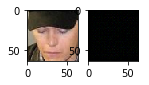

 81%|### |ETA:   0:00:18  Epoch: 0   Iter: 2497   Class Loss: 0.00   Loss: 0.15

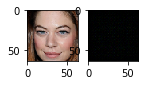

 85%|### |ETA:   0:00:14  Epoch: 0   Iter: 2599   Class Loss: 0.00   Loss: 0.13

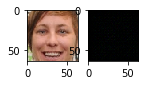

 88%|### |ETA:   0:00:11  Epoch: 0   Iter: 2696   Class Loss: 0.00   Loss: 0.15

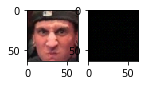

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2797   Class Loss: 0.00   Loss: 0.16

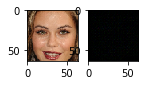

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2897   Class Loss: 0.00   Loss: 0.16

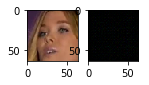

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2998   Class Loss: 0.00   Loss: 0.15

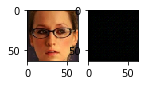

100%|####|Time:  0:01:46  Epoch: 0   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

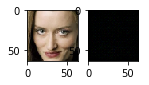

  3%|      |ETA:   0:01:37  Epoch: 1   Iter: 97   Class Loss: 0.00   Loss: 0.15

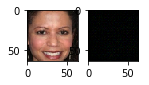

  6%|     |ETA:   0:01:34  Epoch: 1   Iter: 196   Class Loss: 0.00   Loss: 0.15

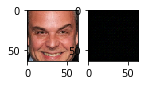

  9%|     |ETA:   0:01:42  Epoch: 1   Iter: 297   Class Loss: 0.00   Loss: 0.16

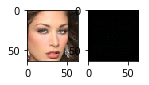

 13%|     |ETA:   0:01:39  Epoch: 1   Iter: 398   Class Loss: 0.00   Loss: 0.14

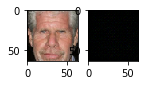

 16%|     |ETA:   0:01:36  Epoch: 1   Iter: 499   Class Loss: 0.00   Loss: 0.16

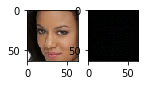

 19%|     |ETA:   0:01:20  Epoch: 1   Iter: 599   Class Loss: 0.00   Loss: 0.17

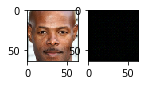

 22%|#    |ETA:   0:01:18  Epoch: 1   Iter: 699   Class Loss: 0.00   Loss: 0.16

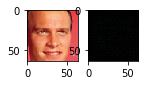

 26%|#    |ETA:   0:01:14  Epoch: 1   Iter: 799   Class Loss: 0.00   Loss: 0.18

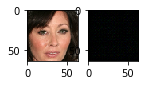

 29%|#    |ETA:   0:01:20  Epoch: 1   Iter: 898   Class Loss: 0.00   Loss: 0.16

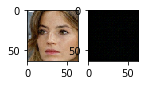

 32%|#    |ETA:   0:01:07  Epoch: 1   Iter: 997   Class Loss: 0.00   Loss: 0.16

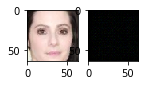

 35%|#   |ETA:   0:01:04  Epoch: 1   Iter: 1098   Class Loss: 0.00   Loss: 0.18

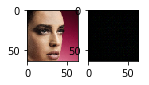

 39%|#   |ETA:   0:01:01  Epoch: 1   Iter: 1198   Class Loss: 0.00   Loss: 0.16

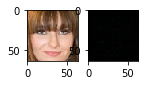

 42%|#   |ETA:   0:01:09  Epoch: 1   Iter: 1299   Class Loss: 0.00   Loss: 0.18

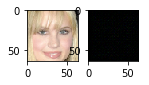

 45%|#   |ETA:   0:01:05  Epoch: 1   Iter: 1399   Class Loss: 0.00   Loss: 0.14

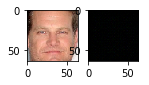

 49%|#   |ETA:   0:00:52  Epoch: 1   Iter: 1498   Class Loss: 0.00   Loss: 0.14

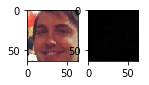

 52%|##  |ETA:   0:00:48  Epoch: 1   Iter: 1598   Class Loss: 0.00   Loss: 0.15

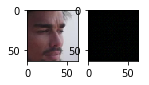

 55%|##  |ETA:   0:00:44  Epoch: 1   Iter: 1698   Class Loss: 0.00   Loss: 0.14

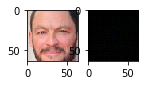

 58%|##  |ETA:   0:00:41  Epoch: 1   Iter: 1797   Class Loss: 0.00   Loss: 0.15

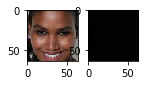

 62%|##  |ETA:   0:00:38  Epoch: 1   Iter: 1897   Class Loss: 0.00   Loss: 0.17

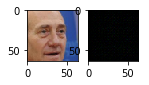

 65%|##  |ETA:   0:00:35  Epoch: 1   Iter: 1997   Class Loss: 0.00   Loss: 0.17

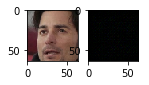

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2096   Class Loss: 0.02   Loss: 0.20

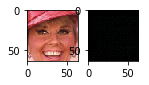

 71%|##  |ETA:   0:00:28  Epoch: 1   Iter: 2197   Class Loss: 0.00   Loss: 0.16

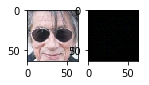

 75%|### |ETA:   0:00:24  Epoch: 1   Iter: 2298   Class Loss: 0.00   Loss: 0.16

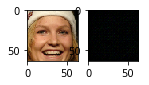

 78%|### |ETA:   0:00:21  Epoch: 1   Iter: 2399   Class Loss: 0.00   Loss: 0.17

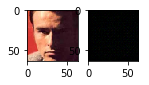

 81%|### |ETA:   0:00:18  Epoch: 1   Iter: 2498   Class Loss: 0.00   Loss: 0.15

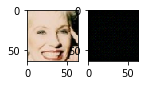

 85%|### |ETA:   0:00:17  Epoch: 1   Iter: 2598   Class Loss: 0.00   Loss: 0.16

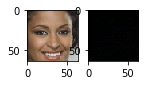

 88%|### |ETA:   0:00:13  Epoch: 1   Iter: 2698   Class Loss: 0.00   Loss: 0.16

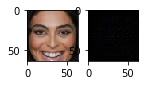

 91%|### |ETA:   0:00:09  Epoch: 1   Iter: 2797   Class Loss: 0.00   Loss: 0.14

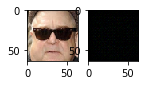

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2898   Class Loss: 0.00   Loss: 0.15

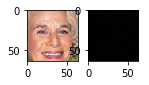

 98%|### |ETA:   0:00:01  Epoch: 1   Iter: 2998   Class Loss: 0.00   Loss: 0.15

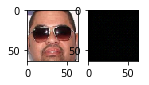

100%|####|Time:  0:01:49  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

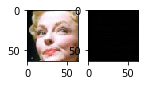

  3%|      |ETA:   0:01:36  Epoch: 2   Iter: 99   Class Loss: 0.00   Loss: 0.16

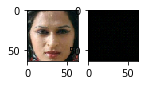

  6%|     |ETA:   0:01:34  Epoch: 2   Iter: 196   Class Loss: 0.00   Loss: 0.16

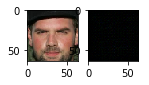

  9%|     |ETA:   0:01:31  Epoch: 2   Iter: 299   Class Loss: 0.00   Loss: 0.15

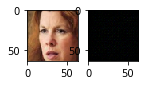

 13%|     |ETA:   0:01:27  Epoch: 2   Iter: 396   Class Loss: 0.00   Loss: 0.15

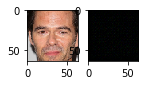

 16%|     |ETA:   0:01:23  Epoch: 2   Iter: 497   Class Loss: 0.00   Loss: 0.16

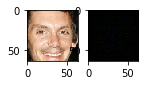

 19%|     |ETA:   0:01:21  Epoch: 2   Iter: 599   Class Loss: 0.00   Loss: 0.17

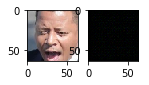

 22%|#    |ETA:   0:01:27  Epoch: 2   Iter: 699   Class Loss: 0.00   Loss: 0.15

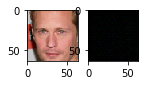

 26%|#    |ETA:   0:01:13  Epoch: 2   Iter: 799   Class Loss: 0.00   Loss: 0.17

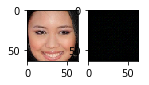

 29%|#    |ETA:   0:01:10  Epoch: 2   Iter: 899   Class Loss: 0.00   Loss: 0.19

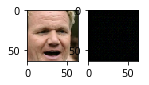

 32%|#    |ETA:   0:01:07  Epoch: 2   Iter: 997   Class Loss: 0.00   Loss: 0.17

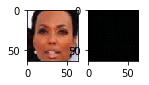

 35%|#   |ETA:   0:01:04  Epoch: 2   Iter: 1097   Class Loss: 0.00   Loss: 0.18

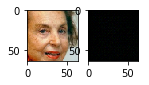

 39%|#   |ETA:   0:01:01  Epoch: 2   Iter: 1198   Class Loss: 0.00   Loss: 0.14

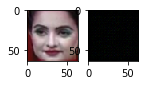

 42%|#   |ETA:   0:00:57  Epoch: 2   Iter: 1297   Class Loss: 0.00   Loss: 0.14

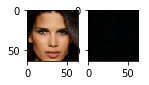

 45%|#   |ETA:   0:00:54  Epoch: 2   Iter: 1398   Class Loss: 0.00   Loss: 0.13

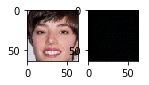

 49%|#   |ETA:   0:00:51  Epoch: 2   Iter: 1498   Class Loss: 0.00   Loss: 0.16

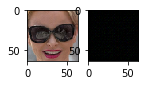

 52%|##  |ETA:   0:00:47  Epoch: 2   Iter: 1598   Class Loss: 0.00   Loss: 0.15

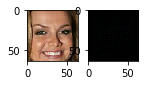

 55%|##  |ETA:   0:00:48  Epoch: 2   Iter: 1699   Class Loss: 0.00   Loss: 0.14

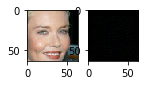

 58%|##  |ETA:   0:00:47  Epoch: 2   Iter: 1798   Class Loss: 0.00   Loss: 0.14

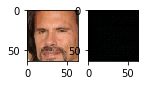

 62%|##  |ETA:   0:00:43  Epoch: 2   Iter: 1899   Class Loss: 0.00   Loss: 0.15

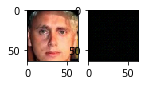

 65%|##  |ETA:   0:00:35  Epoch: 2   Iter: 1996   Class Loss: 0.00   Loss: 0.16

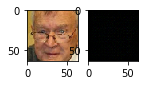

 68%|##  |ETA:   0:00:31  Epoch: 2   Iter: 2096   Class Loss: 0.00   Loss: 0.14

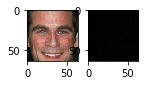

 71%|##  |ETA:   0:00:28  Epoch: 2   Iter: 2197   Class Loss: 0.00   Loss: 0.15

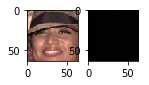

 75%|### |ETA:   0:00:24  Epoch: 2   Iter: 2299   Class Loss: 0.00   Loss: 0.16

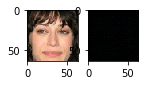

 78%|### |ETA:   0:00:21  Epoch: 2   Iter: 2399   Class Loss: 0.00   Loss: 0.13

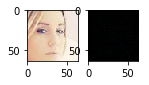

 81%|### |ETA:   0:00:18  Epoch: 2   Iter: 2499   Class Loss: 0.00   Loss: 0.15

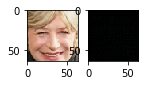

 85%|### |ETA:   0:00:14  Epoch: 2   Iter: 2599   Class Loss: 0.00   Loss: 0.16

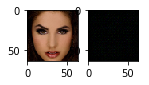

 88%|### |ETA:   0:00:11  Epoch: 2   Iter: 2697   Class Loss: 0.00   Loss: 0.16

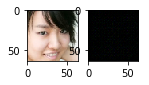

 91%|### |ETA:   0:00:08  Epoch: 2   Iter: 2797   Class Loss: 0.00   Loss: 0.14

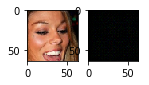

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2898   Class Loss: 0.00   Loss: 0.16

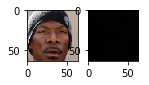

 98%|### |ETA:   0:00:01  Epoch: 2   Iter: 2997   Class Loss: 0.00   Loss: 0.17

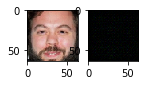

100%|####|Time:  0:01:45  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

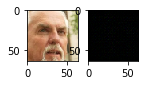

  3%|      |ETA:   0:01:36  Epoch: 3   Iter: 99   Class Loss: 0.00   Loss: 0.14

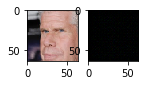

  6%|     |ETA:   0:01:33  Epoch: 3   Iter: 196   Class Loss: 0.00   Loss: 0.15

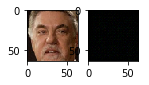

  9%|     |ETA:   0:01:30  Epoch: 3   Iter: 297   Class Loss: 0.00   Loss: 0.13

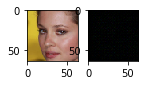

 13%|     |ETA:   0:01:26  Epoch: 3   Iter: 398   Class Loss: 0.00   Loss: 0.15

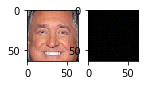

 16%|     |ETA:   0:01:33  Epoch: 3   Iter: 498   Class Loss: 0.00   Loss: 0.13

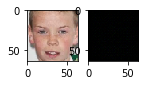

 19%|     |ETA:   0:01:21  Epoch: 3   Iter: 599   Class Loss: 0.00   Loss: 0.14

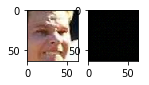

 22%|#    |ETA:   0:01:17  Epoch: 3   Iter: 698   Class Loss: 0.00   Loss: 0.16

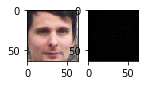

 26%|#    |ETA:   0:01:14  Epoch: 3   Iter: 797   Class Loss: 0.00   Loss: 0.13

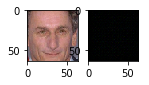

 29%|#    |ETA:   0:01:20  Epoch: 3   Iter: 897   Class Loss: 0.04   Loss: 0.17

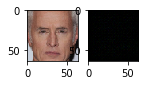

 32%|#    |ETA:   0:01:17  Epoch: 3   Iter: 998   Class Loss: 0.00   Loss: 0.17

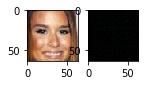

 36%|#   |ETA:   0:01:13  Epoch: 3   Iter: 1099   Class Loss: 0.00   Loss: 0.16

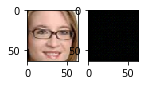

 39%|#   |ETA:   0:01:00  Epoch: 3   Iter: 1197   Class Loss: 0.00   Loss: 0.17

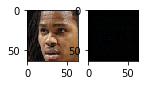

 42%|#   |ETA:   0:00:57  Epoch: 3   Iter: 1297   Class Loss: 0.00   Loss: 0.13

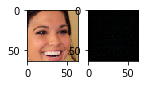

 45%|#   |ETA:   0:00:54  Epoch: 3   Iter: 1398   Class Loss: 0.00   Loss: 0.17

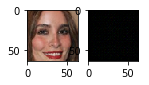

 49%|#   |ETA:   0:00:51  Epoch: 3   Iter: 1497   Class Loss: 0.00   Loss: 0.15

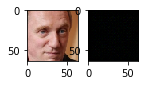

 52%|##  |ETA:   0:00:47  Epoch: 3   Iter: 1599   Class Loss: 0.00   Loss: 0.15

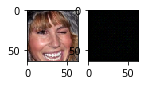

 55%|##  |ETA:   0:00:44  Epoch: 3   Iter: 1699   Class Loss: 0.00   Loss: 0.14

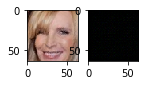

 58%|##  |ETA:   0:00:41  Epoch: 3   Iter: 1797   Class Loss: 0.00   Loss: 0.15

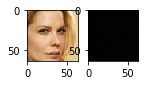

 62%|##  |ETA:   0:00:38  Epoch: 3   Iter: 1897   Class Loss: 0.00   Loss: 0.16

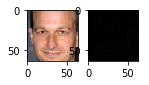

 65%|##  |ETA:   0:00:34  Epoch: 3   Iter: 1996   Class Loss: 0.00   Loss: 0.13

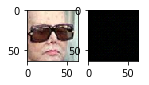

 68%|##  |ETA:   0:00:31  Epoch: 3   Iter: 2097   Class Loss: 0.00   Loss: 0.16

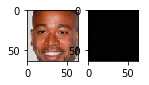

 71%|##  |ETA:   0:00:27  Epoch: 3   Iter: 2196   Class Loss: 0.00   Loss: 0.14

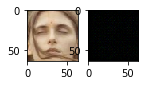

 75%|### |ETA:   0:00:24  Epoch: 3   Iter: 2296   Class Loss: 0.00   Loss: 0.15

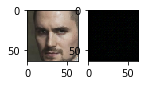

 78%|### |ETA:   0:00:21  Epoch: 3   Iter: 2399   Class Loss: 0.00   Loss: 0.14

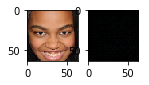

 81%|### |ETA:   0:00:18  Epoch: 3   Iter: 2499   Class Loss: 0.00   Loss: 0.17

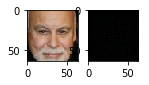

 85%|### |ETA:   0:00:15  Epoch: 3   Iter: 2597   Class Loss: 0.06   Loss: 0.21

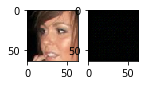

 88%|### |ETA:   0:00:11  Epoch: 3   Iter: 2696   Class Loss: 0.00   Loss: 0.14

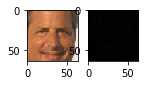

 91%|### |ETA:   0:00:08  Epoch: 3   Iter: 2796   Class Loss: 0.02   Loss: 0.19

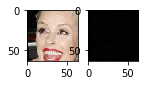

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2898   Class Loss: 0.00   Loss: 0.15

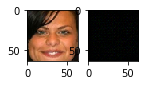

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2998   Class Loss: 0.00   Loss: 0.18

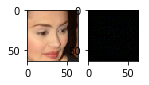

100%|####|Time:  0:01:46  Epoch: 3   Iter: 3052   Class Loss: 0.03   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

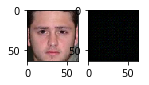

  3%|      |ETA:   0:01:50  Epoch: 4   Iter: 98   Class Loss: 0.00   Loss: 0.17

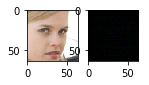

  6%|     |ETA:   0:01:48  Epoch: 4   Iter: 199   Class Loss: 0.00   Loss: 0.15

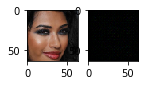

  9%|     |ETA:   0:01:42  Epoch: 4   Iter: 299   Class Loss: 0.00   Loss: 0.15

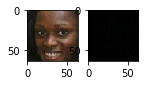

 13%|     |ETA:   0:01:27  Epoch: 4   Iter: 397   Class Loss: 0.00   Loss: 0.18

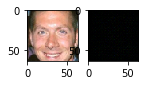

 16%|     |ETA:   0:01:23  Epoch: 4   Iter: 497   Class Loss: 0.00   Loss: 0.16

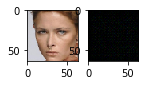

 19%|     |ETA:   0:01:20  Epoch: 4   Iter: 597   Class Loss: 0.00   Loss: 0.15

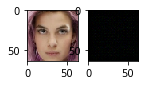

 22%|#    |ETA:   0:01:26  Epoch: 4   Iter: 698   Class Loss: 0.00   Loss: 0.15

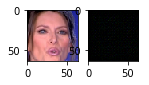

 26%|#    |ETA:   0:01:27  Epoch: 4   Iter: 799   Class Loss: 0.00   Loss: 0.17

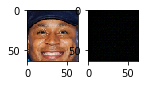

 29%|#    |ETA:   0:01:24  Epoch: 4   Iter: 897   Class Loss: 0.00   Loss: 0.16

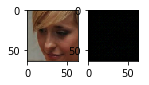

 32%|#    |ETA:   0:01:08  Epoch: 4   Iter: 997   Class Loss: 0.00   Loss: 0.15

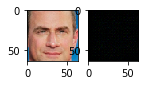

 35%|#   |ETA:   0:01:04  Epoch: 4   Iter: 1097   Class Loss: 0.00   Loss: 0.15

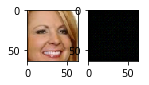

 39%|#   |ETA:   0:01:00  Epoch: 4   Iter: 1198   Class Loss: 0.00   Loss: 0.14

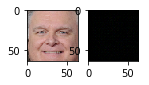

 42%|#   |ETA:   0:00:57  Epoch: 4   Iter: 1298   Class Loss: 0.00   Loss: 0.15

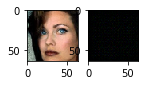

 45%|#   |ETA:   0:00:54  Epoch: 4   Iter: 1398   Class Loss: 0.00   Loss: 0.16

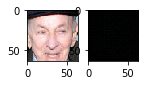

 49%|#   |ETA:   0:00:51  Epoch: 4   Iter: 1497   Class Loss: 0.00   Loss: 0.16

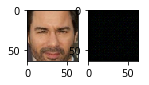

 52%|##  |ETA:   0:00:47  Epoch: 4   Iter: 1598   Class Loss: 0.00   Loss: 0.16

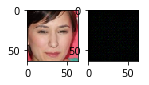

 55%|##  |ETA:   0:00:44  Epoch: 4   Iter: 1696   Class Loss: 0.00   Loss: 0.17

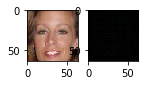

 58%|##  |ETA:   0:00:41  Epoch: 4   Iter: 1799   Class Loss: 0.00   Loss: 0.19

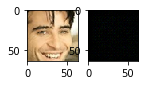

 62%|##  |ETA:   0:00:38  Epoch: 4   Iter: 1897   Class Loss: 0.00   Loss: 0.17

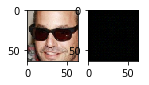

 65%|##  |ETA:   0:00:34  Epoch: 4   Iter: 1999   Class Loss: 0.00   Loss: 0.17

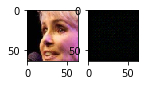

 68%|##  |ETA:   0:00:32  Epoch: 4   Iter: 2098   Class Loss: 0.00   Loss: 0.17

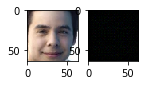

 72%|##  |ETA:   0:00:32  Epoch: 4   Iter: 2199   Class Loss: 0.00   Loss: 0.15

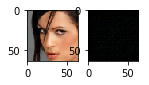

 75%|### |ETA:   0:00:26  Epoch: 4   Iter: 2297   Class Loss: 0.00   Loss: 0.15

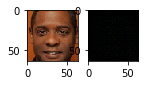

 78%|### |ETA:   0:00:24  Epoch: 4   Iter: 2399   Class Loss: 0.00   Loss: 0.16

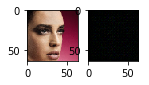

 81%|### |ETA:   0:00:20  Epoch: 4   Iter: 2499   Class Loss: 0.00   Loss: 0.16

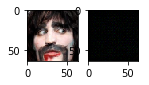

 85%|### |ETA:   0:00:15  Epoch: 4   Iter: 2597   Class Loss: 0.00   Loss: 0.16

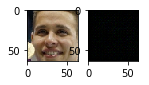

 88%|### |ETA:   0:00:11  Epoch: 4   Iter: 2696   Class Loss: 0.00   Loss: 0.15

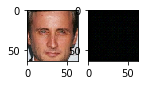

 91%|### |ETA:   0:00:08  Epoch: 4   Iter: 2796   Class Loss: 0.00   Loss: 0.16

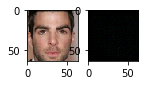

 94%|### |ETA:   0:00:05  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.15

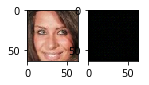

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2998   Class Loss: 0.00   Loss: 0.14

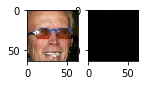

100%|####|Time:  0:01:49  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.16


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

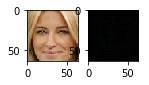

  3%|      |ETA:   0:01:48  Epoch: 5   Iter: 99   Class Loss: 0.00   Loss: 0.16

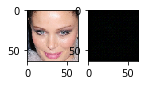

  6%|     |ETA:   0:01:33  Epoch: 5   Iter: 199   Class Loss: 0.00   Loss: 0.16

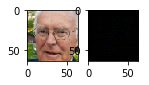

  9%|     |ETA:   0:01:30  Epoch: 5   Iter: 298   Class Loss: 0.00   Loss: 0.15

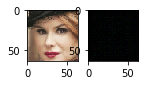

 13%|     |ETA:   0:01:26  Epoch: 5   Iter: 397   Class Loss: 0.00   Loss: 0.17

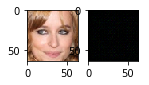

 16%|     |ETA:   0:01:25  Epoch: 5   Iter: 497   Class Loss: 0.04   Loss: 0.20

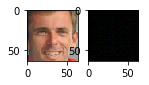

 19%|     |ETA:   0:01:20  Epoch: 5   Iter: 598   Class Loss: 0.00   Loss: 0.18

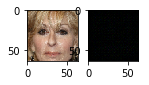

 22%|#    |ETA:   0:01:17  Epoch: 5   Iter: 699   Class Loss: 0.00   Loss: 0.16

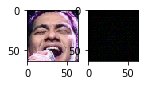

 26%|#    |ETA:   0:01:14  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.17

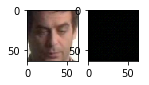

 29%|#    |ETA:   0:01:11  Epoch: 5   Iter: 899   Class Loss: 0.00   Loss: 0.15

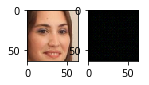

 32%|#    |ETA:   0:01:07  Epoch: 5   Iter: 999   Class Loss: 0.00   Loss: 0.15

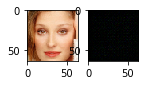

 35%|#   |ETA:   0:01:03  Epoch: 5   Iter: 1097   Class Loss: 0.00   Loss: 0.15

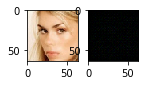

 39%|#   |ETA:   0:01:00  Epoch: 5   Iter: 1198   Class Loss: 0.00   Loss: 0.15

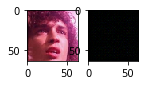

 42%|#   |ETA:   0:00:57  Epoch: 5   Iter: 1298   Class Loss: 0.00   Loss: 0.15

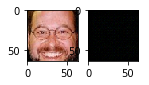

 45%|#   |ETA:   0:00:53  Epoch: 5   Iter: 1398   Class Loss: 0.00   Loss: 0.15

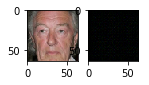

 49%|#   |ETA:   0:00:55  Epoch: 5   Iter: 1498   Class Loss: 0.00   Loss: 0.15

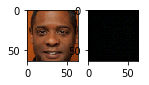

 52%|##  |ETA:   0:00:54  Epoch: 5   Iter: 1599   Class Loss: 0.00   Loss: 0.14

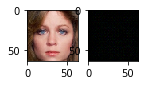

 55%|##  |ETA:   0:00:50  Epoch: 5   Iter: 1697   Class Loss: 0.00   Loss: 0.14

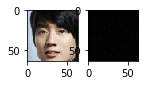

 58%|##  |ETA:   0:00:40  Epoch: 5   Iter: 1796   Class Loss: 0.00   Loss: 0.15

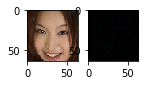

 62%|##  |ETA:   0:00:37  Epoch: 5   Iter: 1897   Class Loss: 0.00   Loss: 0.16

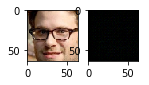

 65%|##  |ETA:   0:00:34  Epoch: 5   Iter: 1997   Class Loss: 0.00   Loss: 0.15

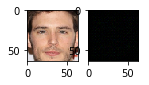

 68%|##  |ETA:   0:00:31  Epoch: 5   Iter: 2098   Class Loss: 0.00   Loss: 0.14

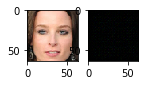

 71%|##  |ETA:   0:00:27  Epoch: 5   Iter: 2197   Class Loss: 0.00   Loss: 0.17

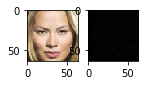

 75%|### |ETA:   0:00:25  Epoch: 5   Iter: 2297   Class Loss: 0.00   Loss: 0.16

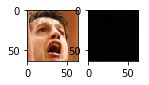

 78%|### |ETA:   0:00:21  Epoch: 5   Iter: 2396   Class Loss: 0.00   Loss: 0.17

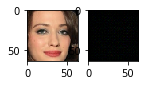

 81%|### |ETA:   0:00:18  Epoch: 5   Iter: 2497   Class Loss: 0.01   Loss: 0.17

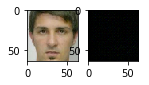

 85%|### |ETA:   0:00:14  Epoch: 5   Iter: 2597   Class Loss: 0.00   Loss: 0.15

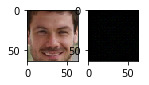

 88%|### |ETA:   0:00:11  Epoch: 5   Iter: 2697   Class Loss: 0.00   Loss: 0.17

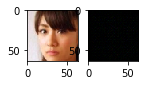

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2796   Class Loss: 0.00   Loss: 0.15

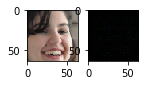

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2898   Class Loss: 0.00   Loss: 0.14

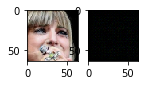

 98%|### |ETA:   0:00:02  Epoch: 5   Iter: 2997   Class Loss: 0.00   Loss: 0.16

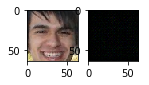

100%|####|Time:  0:01:45  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.13


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

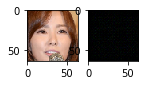

  3%|      |ETA:   0:01:37  Epoch: 6   Iter: 99   Class Loss: 0.00   Loss: 0.15

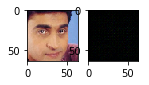

  6%|     |ETA:   0:01:33  Epoch: 6   Iter: 197   Class Loss: 0.00   Loss: 0.13

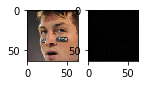

  9%|     |ETA:   0:01:30  Epoch: 6   Iter: 296   Class Loss: 0.00   Loss: 0.15

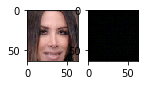

 13%|     |ETA:   0:01:27  Epoch: 6   Iter: 397   Class Loss: 0.00   Loss: 0.15

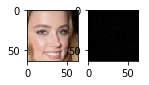

 16%|     |ETA:   0:01:23  Epoch: 6   Iter: 499   Class Loss: 0.00   Loss: 0.16

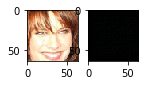

 19%|     |ETA:   0:01:20  Epoch: 6   Iter: 598   Class Loss: 0.00   Loss: 0.14

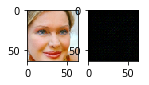

 22%|#    |ETA:   0:01:24  Epoch: 6   Iter: 698   Class Loss: 0.00   Loss: 0.14

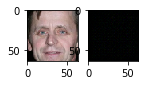

 26%|#    |ETA:   0:01:23  Epoch: 6   Iter: 799   Class Loss: 0.00   Loss: 0.14

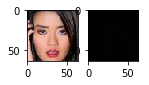

 29%|#    |ETA:   0:01:21  Epoch: 6   Iter: 897   Class Loss: 0.00   Loss: 0.15

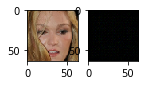

 32%|#    |ETA:   0:01:07  Epoch: 6   Iter: 997   Class Loss: 0.01   Loss: 0.18

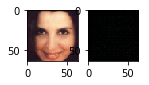

 35%|#   |ETA:   0:01:04  Epoch: 6   Iter: 1096   Class Loss: 0.00   Loss: 0.14

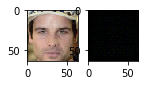

 39%|#   |ETA:   0:01:01  Epoch: 6   Iter: 1198   Class Loss: 0.00   Loss: 0.16

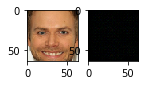

 42%|#   |ETA:   0:00:57  Epoch: 6   Iter: 1298   Class Loss: 0.00   Loss: 0.13

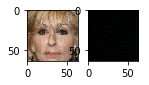

 45%|#   |ETA:   0:00:54  Epoch: 6   Iter: 1398   Class Loss: 0.00   Loss: 0.17

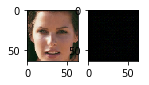

 49%|#   |ETA:   0:00:51  Epoch: 6   Iter: 1498   Class Loss: 0.00   Loss: 0.17

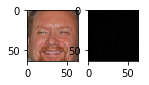

 52%|##  |ETA:   0:00:47  Epoch: 6   Iter: 1597   Class Loss: 0.00   Loss: 0.17

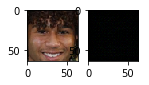

 55%|##  |ETA:   0:00:44  Epoch: 6   Iter: 1699   Class Loss: 0.00   Loss: 0.16

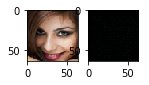

 58%|##  |ETA:   0:00:41  Epoch: 6   Iter: 1799   Class Loss: 0.00   Loss: 0.15

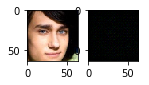

 62%|##  |ETA:   0:00:38  Epoch: 6   Iter: 1896   Class Loss: 0.00   Loss: 0.17

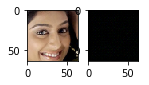

 65%|##  |ETA:   0:00:34  Epoch: 6   Iter: 1996   Class Loss: 0.00   Loss: 0.16

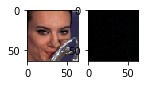

 68%|##  |ETA:   0:00:31  Epoch: 6   Iter: 2097   Class Loss: 0.00   Loss: 0.17

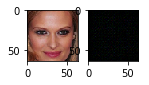

 71%|##  |ETA:   0:00:28  Epoch: 6   Iter: 2197   Class Loss: 0.00   Loss: 0.14

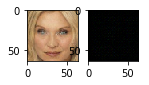

 75%|### |ETA:   0:00:24  Epoch: 6   Iter: 2298   Class Loss: 0.00   Loss: 0.16

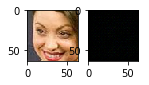

 78%|### |ETA:   0:00:21  Epoch: 6   Iter: 2396   Class Loss: 0.00   Loss: 0.16

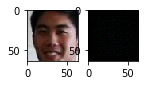

 81%|### |ETA:   0:00:18  Epoch: 6   Iter: 2499   Class Loss: 0.00   Loss: 0.15

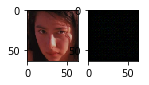

 85%|### |ETA:   0:00:14  Epoch: 6   Iter: 2597   Class Loss: 0.00   Loss: 0.13

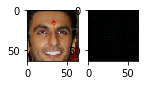

 88%|### |ETA:   0:00:11  Epoch: 6   Iter: 2696   Class Loss: 0.00   Loss: 0.15

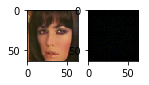

 91%|### |ETA:   0:00:09  Epoch: 6   Iter: 2797   Class Loss: 0.00   Loss: 0.17

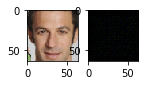

 94%|### |ETA:   0:00:05  Epoch: 6   Iter: 2898   Class Loss: 0.00   Loss: 0.18

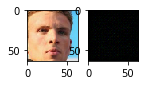

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2998   Class Loss: 0.00   Loss: 0.14

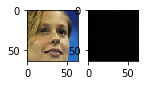

100%|####|Time:  0:01:46  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

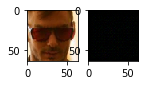

  3%|      |ETA:   0:01:50  Epoch: 7   Iter: 98   Class Loss: 0.00   Loss: 0.17

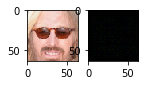

  6%|     |ETA:   0:01:51  Epoch: 7   Iter: 199   Class Loss: 0.00   Loss: 0.16

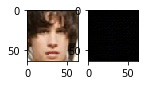

  9%|     |ETA:   0:01:47  Epoch: 7   Iter: 299   Class Loss: 0.00   Loss: 0.16

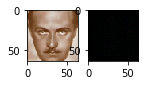

 13%|     |ETA:   0:01:40  Epoch: 7   Iter: 397   Class Loss: 0.00   Loss: 0.15

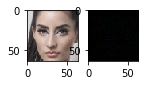

 16%|     |ETA:   0:01:24  Epoch: 7   Iter: 499   Class Loss: 0.00   Loss: 0.17

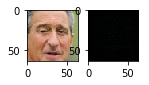

 19%|     |ETA:   0:01:20  Epoch: 7   Iter: 598   Class Loss: 0.00   Loss: 0.15

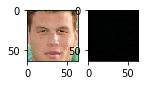

 22%|#    |ETA:   0:01:17  Epoch: 7   Iter: 699   Class Loss: 0.00   Loss: 0.17

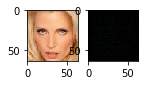

 26%|#    |ETA:   0:01:13  Epoch: 7   Iter: 798   Class Loss: 0.00   Loss: 0.16

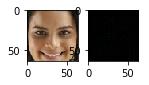

 29%|#    |ETA:   0:01:11  Epoch: 7   Iter: 896   Class Loss: 0.00   Loss: 0.14

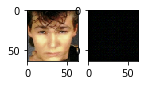

 32%|#    |ETA:   0:01:07  Epoch: 7   Iter: 998   Class Loss: 0.00   Loss: 0.16

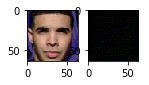

 35%|#   |ETA:   0:01:04  Epoch: 7   Iter: 1096   Class Loss: 0.00   Loss: 0.15

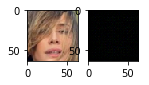

 39%|#   |ETA:   0:01:01  Epoch: 7   Iter: 1198   Class Loss: 0.00   Loss: 0.14

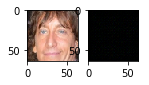

 42%|#   |ETA:   0:00:57  Epoch: 7   Iter: 1297   Class Loss: 0.00   Loss: 0.14

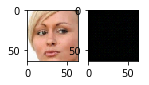

 45%|#   |ETA:   0:00:54  Epoch: 7   Iter: 1398   Class Loss: 0.00   Loss: 0.15

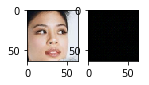

 49%|#   |ETA:   0:01:00  Epoch: 7   Iter: 1497   Class Loss: 0.00   Loss: 0.16

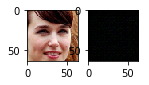

 52%|##  |ETA:   0:00:48  Epoch: 7   Iter: 1596   Class Loss: 0.00   Loss: 0.14

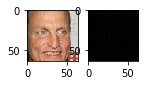

 55%|##  |ETA:   0:00:44  Epoch: 7   Iter: 1698   Class Loss: 0.00   Loss: 0.15

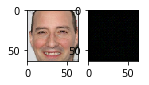

 58%|##  |ETA:   0:00:41  Epoch: 7   Iter: 1799   Class Loss: 0.00   Loss: 0.17

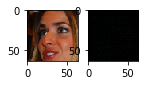

 62%|##  |ETA:   0:00:38  Epoch: 7   Iter: 1897   Class Loss: 0.00   Loss: 0.14

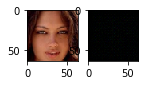

 65%|##  |ETA:   0:00:34  Epoch: 7   Iter: 1996   Class Loss: 0.00   Loss: 0.16

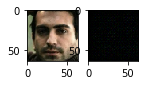

 68%|##  |ETA:   0:00:31  Epoch: 7   Iter: 2099   Class Loss: 0.00   Loss: 0.15

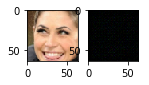

 72%|##  |ETA:   0:00:32  Epoch: 7   Iter: 2199   Class Loss: 0.00   Loss: 0.15

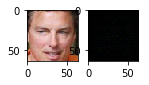

 75%|### |ETA:   0:00:28  Epoch: 7   Iter: 2298   Class Loss: 0.00   Loss: 0.15

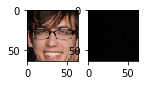

 78%|### |ETA:   0:00:21  Epoch: 7   Iter: 2399   Class Loss: 0.00   Loss: 0.15

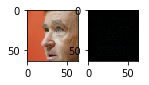

 81%|### |ETA:   0:00:18  Epoch: 7   Iter: 2497   Class Loss: 0.00   Loss: 0.16

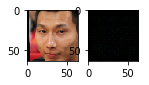

 85%|### |ETA:   0:00:16  Epoch: 7   Iter: 2597   Class Loss: 0.00   Loss: 0.15

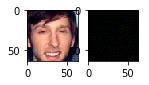

 88%|### |ETA:   0:00:11  Epoch: 7   Iter: 2697   Class Loss: 0.00   Loss: 0.17

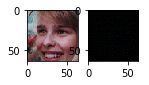

 91%|### |ETA:   0:00:08  Epoch: 7   Iter: 2797   Class Loss: 0.00   Loss: 0.15

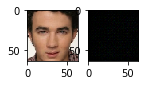

 94%|### |ETA:   0:00:05  Epoch: 7   Iter: 2897   Class Loss: 0.00   Loss: 0.15

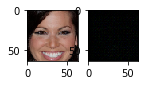

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2998   Class Loss: 0.00   Loss: 0.19

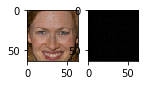

100%|####|Time:  0:01:49  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.14


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

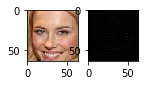

  3%|      |ETA:   0:01:36  Epoch: 8   Iter: 99   Class Loss: 0.00   Loss: 0.14

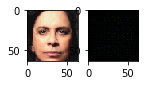

  6%|     |ETA:   0:01:35  Epoch: 8   Iter: 199   Class Loss: 0.00   Loss: 0.16

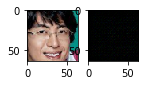

  9%|     |ETA:   0:01:31  Epoch: 8   Iter: 297   Class Loss: 0.00   Loss: 0.15

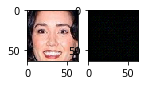

 13%|     |ETA:   0:01:27  Epoch: 8   Iter: 396   Class Loss: 0.00   Loss: 0.17

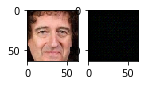

 16%|     |ETA:   0:01:23  Epoch: 8   Iter: 498   Class Loss: 0.00   Loss: 0.15

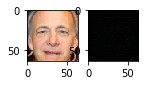

 19%|     |ETA:   0:01:20  Epoch: 8   Iter: 598   Class Loss: 0.00   Loss: 0.16

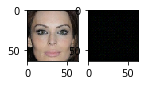

 22%|#    |ETA:   0:01:17  Epoch: 8   Iter: 699   Class Loss: 0.00   Loss: 0.17

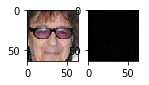

 26%|#    |ETA:   0:01:13  Epoch: 8   Iter: 799   Class Loss: 0.00   Loss: 0.15

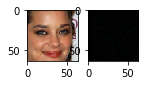

 29%|#    |ETA:   0:01:11  Epoch: 8   Iter: 898   Class Loss: 0.00   Loss: 0.18

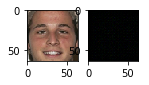

 32%|#    |ETA:   0:01:07  Epoch: 8   Iter: 999   Class Loss: 0.00   Loss: 0.18

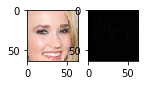

 35%|#   |ETA:   0:01:04  Epoch: 8   Iter: 1098   Class Loss: 0.00   Loss: 0.15

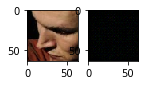

 39%|#   |ETA:   0:01:00  Epoch: 8   Iter: 1197   Class Loss: 0.00   Loss: 0.14

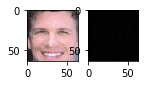

 42%|#   |ETA:   0:01:01  Epoch: 8   Iter: 1298   Class Loss: 0.00   Loss: 0.16

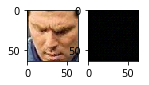

 45%|#   |ETA:   0:01:01  Epoch: 8   Iter: 1399   Class Loss: 0.00   Loss: 0.16

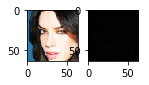

 49%|#   |ETA:   0:00:58  Epoch: 8   Iter: 1498   Class Loss: 0.00   Loss: 0.16

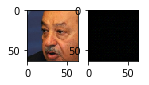

 52%|##  |ETA:   0:00:48  Epoch: 8   Iter: 1599   Class Loss: 0.00   Loss: 0.17

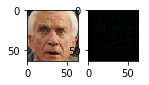

 55%|##  |ETA:   0:00:44  Epoch: 8   Iter: 1696   Class Loss: 0.00   Loss: 0.17

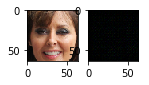

 58%|##  |ETA:   0:00:41  Epoch: 8   Iter: 1796   Class Loss: 0.00   Loss: 0.16

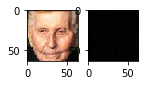

 62%|##  |ETA:   0:00:38  Epoch: 8   Iter: 1896   Class Loss: 0.00   Loss: 0.16

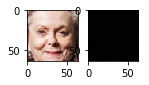

 65%|##  |ETA:   0:00:35  Epoch: 8   Iter: 1997   Class Loss: 0.00   Loss: 0.16

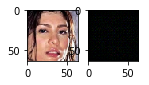

 68%|##  |ETA:   0:00:31  Epoch: 8   Iter: 2098   Class Loss: 0.00   Loss: 0.17

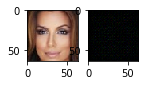

 72%|##  |ETA:   0:00:27  Epoch: 8   Iter: 2199   Class Loss: 0.02   Loss: 0.18

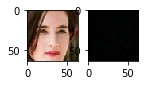

 75%|### |ETA:   0:00:24  Epoch: 8   Iter: 2298   Class Loss: 0.00   Loss: 0.16

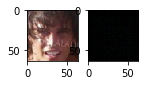

 78%|### |ETA:   0:00:24  Epoch: 8   Iter: 2396   Class Loss: 0.00   Loss: 0.17

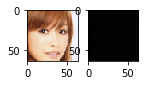

 81%|### |ETA:   0:00:18  Epoch: 8   Iter: 2499   Class Loss: 0.00   Loss: 0.18

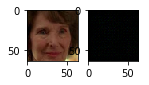

 85%|### |ETA:   0:00:14  Epoch: 8   Iter: 2598   Class Loss: 0.00   Loss: 0.17

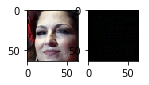

 88%|### |ETA:   0:00:11  Epoch: 8   Iter: 2697   Class Loss: 0.04   Loss: 0.20

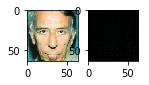

 91%|### |ETA:   0:00:08  Epoch: 8   Iter: 2796   Class Loss: 0.00   Loss: 0.14

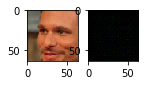

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2897   Class Loss: 0.00   Loss: 0.16

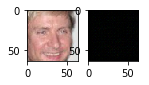

 98%|### |ETA:   0:00:01  Epoch: 8   Iter: 2998   Class Loss: 0.00   Loss: 0.15

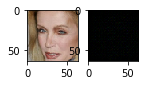

100%|####|Time:  0:01:46  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

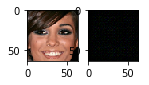

  3%|      |ETA:   0:01:36  Epoch: 9   Iter: 99   Class Loss: 0.00   Loss: 0.18

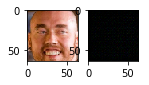

  6%|     |ETA:   0:01:33  Epoch: 9   Iter: 196   Class Loss: 0.00   Loss: 0.17

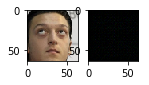

  9%|     |ETA:   0:01:30  Epoch: 9   Iter: 297   Class Loss: 0.00   Loss: 0.16

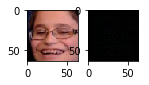

 13%|     |ETA:   0:01:29  Epoch: 9   Iter: 397   Class Loss: 0.00   Loss: 0.14

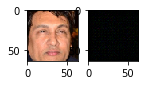

 16%|     |ETA:   0:01:33  Epoch: 9   Iter: 499   Class Loss: 0.00   Loss: 0.15

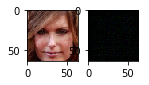

 19%|     |ETA:   0:01:31  Epoch: 9   Iter: 597   Class Loss: 0.00   Loss: 0.15

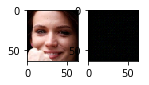

 22%|#    |ETA:   0:01:29  Epoch: 9   Iter: 698   Class Loss: 0.00   Loss: 0.16

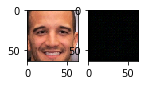

 26%|#    |ETA:   0:01:13  Epoch: 9   Iter: 798   Class Loss: 0.00   Loss: 0.14

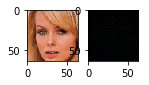

 29%|#    |ETA:   0:01:11  Epoch: 9   Iter: 896   Class Loss: 0.00   Loss: 0.15

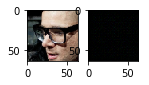

 32%|#    |ETA:   0:01:07  Epoch: 9   Iter: 996   Class Loss: 0.00   Loss: 0.16

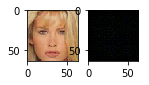

 35%|#   |ETA:   0:01:04  Epoch: 9   Iter: 1096   Class Loss: 0.00   Loss: 0.16

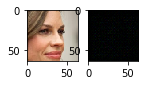

 39%|#   |ETA:   0:01:00  Epoch: 9   Iter: 1198   Class Loss: 0.00   Loss: 0.18

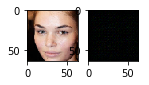

 42%|#   |ETA:   0:00:58  Epoch: 9   Iter: 1298   Class Loss: 0.00   Loss: 0.15

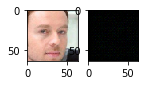

 45%|#   |ETA:   0:00:53  Epoch: 9   Iter: 1399   Class Loss: 0.00   Loss: 0.15

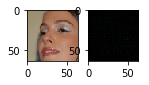

 49%|#   |ETA:   0:00:51  Epoch: 9   Iter: 1497   Class Loss: 0.00   Loss: 0.17

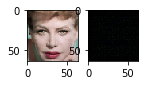

 52%|##  |ETA:   0:00:47  Epoch: 9   Iter: 1599   Class Loss: 0.00   Loss: 0.16

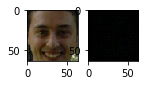

 55%|##  |ETA:   0:00:44  Epoch: 9   Iter: 1699   Class Loss: 0.00   Loss: 0.16

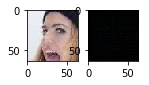

 58%|##  |ETA:   0:00:41  Epoch: 9   Iter: 1796   Class Loss: 0.00   Loss: 0.15

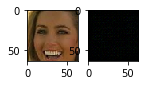

 62%|##  |ETA:   0:00:38  Epoch: 9   Iter: 1899   Class Loss: 0.00   Loss: 0.15

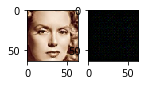

 65%|##  |ETA:   0:00:34  Epoch: 9   Iter: 1997   Class Loss: 0.00   Loss: 0.19

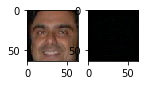

 68%|##  |ETA:   0:00:31  Epoch: 9   Iter: 2096   Class Loss: 0.00   Loss: 0.16

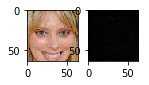

 71%|##  |ETA:   0:00:31  Epoch: 9   Iter: 2197   Class Loss: 0.00   Loss: 0.16

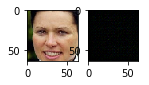

 75%|### |ETA:   0:00:24  Epoch: 9   Iter: 2299   Class Loss: 0.00   Loss: 0.19

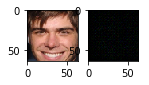

 78%|### |ETA:   0:00:21  Epoch: 9   Iter: 2399   Class Loss: 0.00   Loss: 0.18

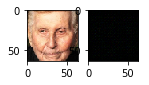

 81%|### |ETA:   0:00:18  Epoch: 9   Iter: 2499   Class Loss: 0.00   Loss: 0.17

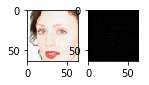

 85%|### |ETA:   0:00:14  Epoch: 9   Iter: 2597   Class Loss: 0.00   Loss: 0.16

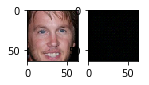

 88%|### |ETA:   0:00:11  Epoch: 9   Iter: 2699   Class Loss: 0.00   Loss: 0.15

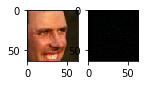

 91%|### |ETA:   0:00:09  Epoch: 9   Iter: 2797   Class Loss: 0.00   Loss: 0.17

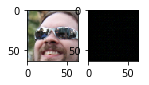

 94%|### |ETA:   0:00:06  Epoch: 9   Iter: 2898   Class Loss: 0.00   Loss: 0.17

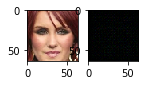

 98%|### |ETA:   0:00:02  Epoch: 9   Iter: 2999   Class Loss: 0.00   Loss: 0.17

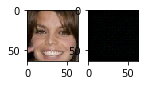

100%|####|Time:  0:01:47  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.18
100% (97 of 97) |########################| Elapsed Time: 0:01:08 Time:  0:01:08
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 0.958762886598


100% (72 of 72) |########################| Elapsed Time: 0:00:50 Time:  0:00:50
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.972222222222


100% (78 of 78) |########################| Elapsed Time: 0:00:53 Time:  0:00:53
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.782051282051


100% (71 of 71) |########################| Elapsed Time: 0:00:47 Time:  0:00:47



female darker: 0.887323943662


Text(0,0.5,'Accuracy')

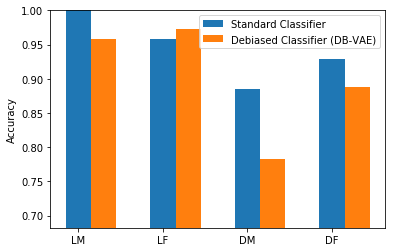

In [40]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.25)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

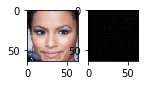

  3%|      |ETA:   0:01:36  Epoch: 0   Iter: 96   Class Loss: 0.00   Loss: 0.17

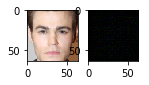

  6%|     |ETA:   0:01:33  Epoch: 0   Iter: 197   Class Loss: 0.00   Loss: 0.21

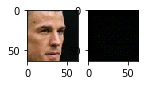

  9%|     |ETA:   0:01:41  Epoch: 0   Iter: 297   Class Loss: 0.00   Loss: 0.17

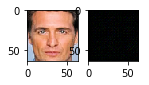

 13%|     |ETA:   0:01:39  Epoch: 0   Iter: 398   Class Loss: 0.00   Loss: 0.19

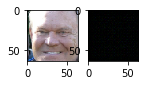

 16%|     |ETA:   0:01:35  Epoch: 0   Iter: 499   Class Loss: 0.00   Loss: 0.13

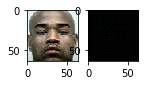

 19%|     |ETA:   0:01:20  Epoch: 0   Iter: 598   Class Loss: 0.00   Loss: 0.16

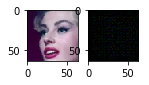

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 699   Class Loss: 0.00   Loss: 0.17

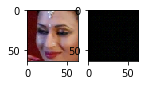

 26%|#    |ETA:   0:01:13  Epoch: 0   Iter: 799   Class Loss: 0.00   Loss: 0.17

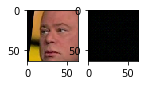

 29%|#    |ETA:   0:01:10  Epoch: 0   Iter: 899   Class Loss: 0.02   Loss: 0.20

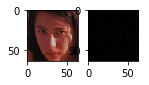

 32%|#    |ETA:   0:01:07  Epoch: 0   Iter: 999   Class Loss: 0.00   Loss: 0.19

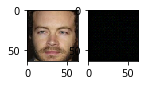

 35%|#   |ETA:   0:01:03  Epoch: 0   Iter: 1098   Class Loss: 0.00   Loss: 0.17

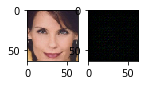

 39%|#   |ETA:   0:01:00  Epoch: 0   Iter: 1198   Class Loss: 0.00   Loss: 0.16

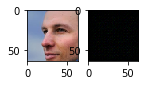

 42%|#   |ETA:   0:00:57  Epoch: 0   Iter: 1298   Class Loss: 0.00   Loss: 0.17

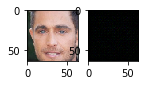

 45%|#   |ETA:   0:00:54  Epoch: 0   Iter: 1398   Class Loss: 0.00   Loss: 0.17

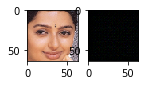

 49%|#   |ETA:   0:00:50  Epoch: 0   Iter: 1499   Class Loss: 0.00   Loss: 0.17

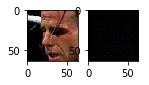

 52%|##  |ETA:   0:00:48  Epoch: 0   Iter: 1597   Class Loss: 0.00   Loss: 0.16

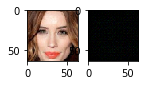

 55%|##  |ETA:   0:00:44  Epoch: 0   Iter: 1699   Class Loss: 0.00   Loss: 0.16

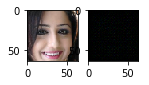

 58%|##  |ETA:   0:00:41  Epoch: 0   Iter: 1796   Class Loss: 0.00   Loss: 0.17

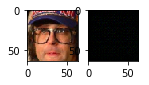

 62%|##  |ETA:   0:00:42  Epoch: 0   Iter: 1896   Class Loss: 0.00   Loss: 0.19

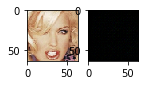

 65%|##  |ETA:   0:00:34  Epoch: 0   Iter: 1997   Class Loss: 0.00   Loss: 0.17

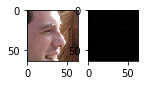

 68%|##  |ETA:   0:00:31  Epoch: 0   Iter: 2098   Class Loss: 0.00   Loss: 0.16

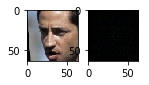

 72%|##  |ETA:   0:00:27  Epoch: 0   Iter: 2198   Class Loss: 0.00   Loss: 0.15

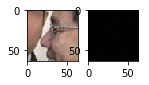

 75%|### |ETA:   0:00:29  Epoch: 0   Iter: 2298   Class Loss: 0.00   Loss: 0.16

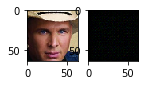

 78%|### |ETA:   0:00:25  Epoch: 0   Iter: 2399   Class Loss: 0.00   Loss: 0.18

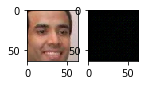

 81%|### |ETA:   0:00:19  Epoch: 0   Iter: 2496   Class Loss: 0.00   Loss: 0.17

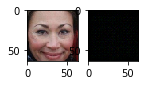

 85%|### |ETA:   0:00:17  Epoch: 0   Iter: 2598   Class Loss: 0.00   Loss: 0.16

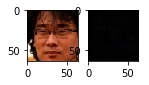

 88%|### |ETA:   0:00:13  Epoch: 0   Iter: 2699   Class Loss: 0.00   Loss: 0.16

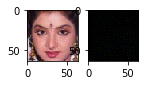

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2798   Class Loss: 0.00   Loss: 0.17

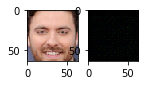

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2898   Class Loss: 0.00   Loss: 0.18

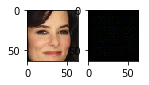

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2997   Class Loss: 0.00   Loss: 0.16

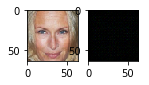

100%|####|Time:  0:01:48  Epoch: 0   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

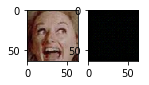

  3%|      |ETA:   0:01:54  Epoch: 1   Iter: 98   Class Loss: 0.00   Loss: 0.15

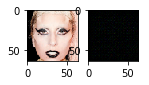

  6%|     |ETA:   0:01:41  Epoch: 1   Iter: 197   Class Loss: 0.00   Loss: 0.16

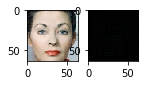

  9%|     |ETA:   0:01:31  Epoch: 1   Iter: 296   Class Loss: 0.01   Loss: 0.17

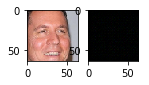

 13%|     |ETA:   0:01:27  Epoch: 1   Iter: 396   Class Loss: 0.00   Loss: 0.15

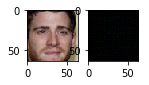

 16%|     |ETA:   0:01:23  Epoch: 1   Iter: 498   Class Loss: 0.00   Loss: 0.14

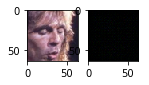

 19%|     |ETA:   0:01:21  Epoch: 1   Iter: 597   Class Loss: 0.00   Loss: 0.14

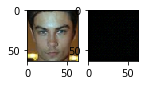

 22%|#    |ETA:   0:01:17  Epoch: 1   Iter: 699   Class Loss: 0.00   Loss: 0.17

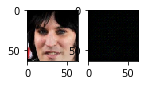

 26%|#    |ETA:   0:01:13  Epoch: 1   Iter: 799   Class Loss: 0.00   Loss: 0.16

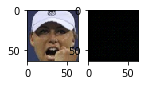

 29%|#    |ETA:   0:01:10  Epoch: 1   Iter: 898   Class Loss: 0.00   Loss: 0.16

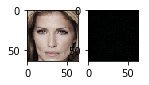

 32%|#    |ETA:   0:01:07  Epoch: 1   Iter: 997   Class Loss: 0.00   Loss: 0.14

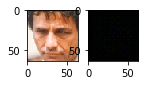

 36%|#   |ETA:   0:01:05  Epoch: 1   Iter: 1099   Class Loss: 0.00   Loss: 0.16

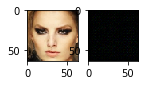

 39%|#   |ETA:   0:01:00  Epoch: 1   Iter: 1198   Class Loss: 0.00   Loss: 0.16

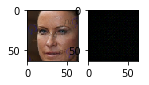

 42%|#   |ETA:   0:00:58  Epoch: 1   Iter: 1297   Class Loss: 0.00   Loss: 0.15

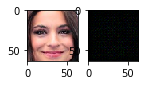

 45%|#   |ETA:   0:00:54  Epoch: 1   Iter: 1397   Class Loss: 0.00   Loss: 0.14

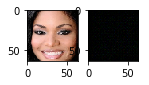

 49%|#   |ETA:   0:00:50  Epoch: 1   Iter: 1498   Class Loss: 0.00   Loss: 0.13

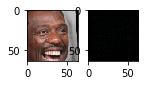

 52%|##  |ETA:   0:00:47  Epoch: 1   Iter: 1599   Class Loss: 0.00   Loss: 0.16

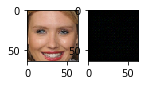

 55%|##  |ETA:   0:00:53  Epoch: 1   Iter: 1698   Class Loss: 0.01   Loss: 0.17

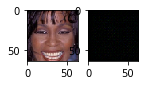

 58%|##  |ETA:   0:00:47  Epoch: 1   Iter: 1798   Class Loss: 0.00   Loss: 0.16

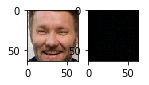

 62%|##  |ETA:   0:00:43  Epoch: 1   Iter: 1899   Class Loss: 0.00   Loss: 0.15

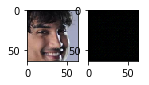

 65%|##  |ETA:   0:00:34  Epoch: 1   Iter: 1999   Class Loss: 0.00   Loss: 0.16

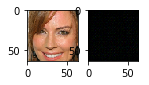

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2098   Class Loss: 0.00   Loss: 0.18

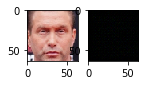

 72%|##  |ETA:   0:00:28  Epoch: 1   Iter: 2198   Class Loss: 0.00   Loss: 0.16

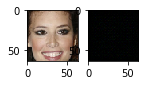

 75%|### |ETA:   0:00:24  Epoch: 1   Iter: 2297   Class Loss: 0.00   Loss: 0.17

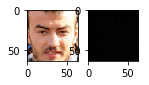

 78%|### |ETA:   0:00:21  Epoch: 1   Iter: 2399   Class Loss: 0.00   Loss: 0.15

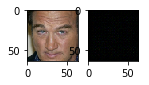

 81%|### |ETA:   0:00:18  Epoch: 1   Iter: 2496   Class Loss: 0.00   Loss: 0.15

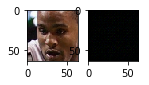

 85%|### |ETA:   0:00:14  Epoch: 1   Iter: 2599   Class Loss: 0.00   Loss: 0.15

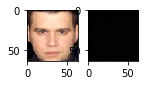

 88%|### |ETA:   0:00:11  Epoch: 1   Iter: 2697   Class Loss: 0.00   Loss: 0.13

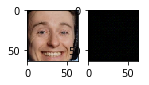

 91%|### |ETA:   0:00:08  Epoch: 1   Iter: 2796   Class Loss: 0.00   Loss: 0.15

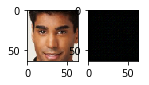

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2897   Class Loss: 0.00   Loss: 0.13

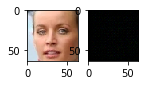

 98%|### |ETA:   0:00:01  Epoch: 1   Iter: 2999   Class Loss: 0.00   Loss: 0.14

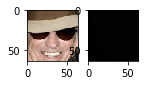

100%|####|Time:  0:01:47  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.16


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

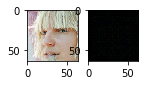

  3%|      |ETA:   0:01:36  Epoch: 2   Iter: 99   Class Loss: 0.00   Loss: 0.14

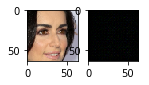

  6%|     |ETA:   0:01:33  Epoch: 2   Iter: 196   Class Loss: 0.00   Loss: 0.14

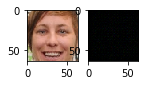

  9%|     |ETA:   0:01:30  Epoch: 2   Iter: 296   Class Loss: 0.00   Loss: 0.16

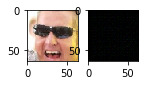

 13%|     |ETA:   0:01:26  Epoch: 2   Iter: 397   Class Loss: 0.00   Loss: 0.13

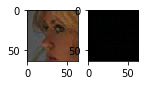

 16%|     |ETA:   0:01:24  Epoch: 2   Iter: 498   Class Loss: 0.00   Loss: 0.15

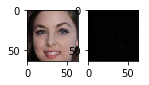

 19%|     |ETA:   0:01:21  Epoch: 2   Iter: 598   Class Loss: 0.00   Loss: 0.17

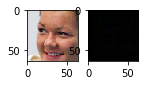

 22%|#    |ETA:   0:01:17  Epoch: 2   Iter: 699   Class Loss: 0.00   Loss: 0.15

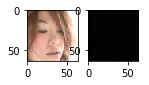

 26%|#    |ETA:   0:01:13  Epoch: 2   Iter: 799   Class Loss: 0.00   Loss: 0.14

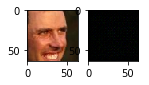

 29%|#    |ETA:   0:01:17  Epoch: 2   Iter: 899   Class Loss: 0.00   Loss: 0.14

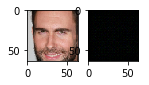

 32%|#    |ETA:   0:01:17  Epoch: 2   Iter: 999   Class Loss: 0.00   Loss: 0.16

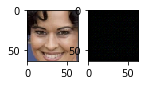

 36%|#   |ETA:   0:01:13  Epoch: 2   Iter: 1099   Class Loss: 0.00   Loss: 0.15

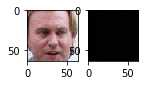

 39%|#   |ETA:   0:01:00  Epoch: 2   Iter: 1198   Class Loss: 0.00   Loss: 0.15

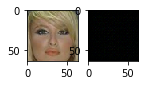

 42%|#   |ETA:   0:00:57  Epoch: 2   Iter: 1298   Class Loss: 0.00   Loss: 0.15

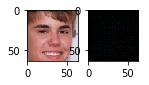

 45%|#   |ETA:   0:00:53  Epoch: 2   Iter: 1399   Class Loss: 0.00   Loss: 0.17

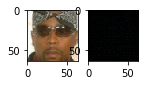

 49%|#   |ETA:   0:00:59  Epoch: 2   Iter: 1496   Class Loss: 0.00   Loss: 0.16

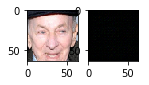

 52%|##  |ETA:   0:00:47  Epoch: 2   Iter: 1596   Class Loss: 0.00   Loss: 0.15

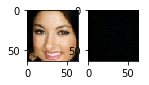

 55%|##  |ETA:   0:00:44  Epoch: 2   Iter: 1699   Class Loss: 0.00   Loss: 0.16

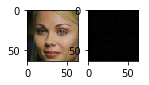

 58%|##  |ETA:   0:00:41  Epoch: 2   Iter: 1796   Class Loss: 0.00   Loss: 0.14

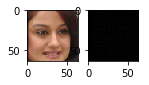

 62%|##  |ETA:   0:00:38  Epoch: 2   Iter: 1897   Class Loss: 0.00   Loss: 0.15

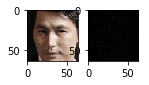

 65%|##  |ETA:   0:00:34  Epoch: 2   Iter: 1997   Class Loss: 0.00   Loss: 0.15

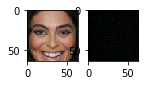

 68%|##  |ETA:   0:00:31  Epoch: 2   Iter: 2097   Class Loss: 0.00   Loss: 0.16

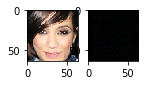

 72%|##  |ETA:   0:00:27  Epoch: 2   Iter: 2198   Class Loss: 0.00   Loss: 0.17

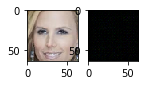

 75%|### |ETA:   0:00:24  Epoch: 2   Iter: 2299   Class Loss: 0.00   Loss: 0.15

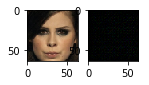

 78%|### |ETA:   0:00:21  Epoch: 2   Iter: 2396   Class Loss: 0.00   Loss: 0.14

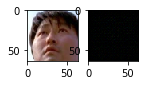

 81%|### |ETA:   0:00:18  Epoch: 2   Iter: 2496   Class Loss: 0.00   Loss: 0.17

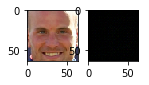

 85%|### |ETA:   0:00:14  Epoch: 2   Iter: 2599   Class Loss: 0.00   Loss: 0.16

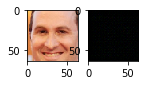

 88%|### |ETA:   0:00:11  Epoch: 2   Iter: 2698   Class Loss: 0.00   Loss: 0.19

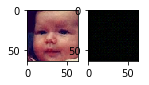

 91%|### |ETA:   0:00:08  Epoch: 2   Iter: 2798   Class Loss: 0.00   Loss: 0.16

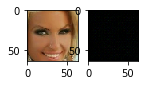

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2897   Class Loss: 0.00   Loss: 0.16

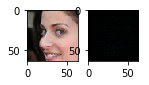

 98%|### |ETA:   0:00:01  Epoch: 2   Iter: 2998   Class Loss: 0.00   Loss: 0.14

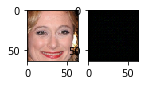

100%|####|Time:  0:01:46  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

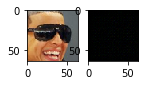

  3%|      |ETA:   0:01:50  Epoch: 3   Iter: 98   Class Loss: 0.00   Loss: 0.16

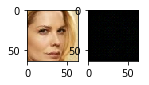

  6%|     |ETA:   0:01:47  Epoch: 3   Iter: 199   Class Loss: 0.00   Loss: 0.17

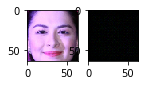

  9%|     |ETA:   0:01:43  Epoch: 3   Iter: 297   Class Loss: 0.00   Loss: 0.15

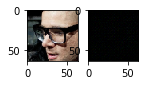

 13%|     |ETA:   0:01:27  Epoch: 3   Iter: 399   Class Loss: 0.00   Loss: 0.15

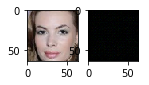

 16%|     |ETA:   0:01:23  Epoch: 3   Iter: 497   Class Loss: 0.00   Loss: 0.14

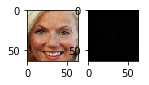

 19%|     |ETA:   0:01:20  Epoch: 3   Iter: 599   Class Loss: 0.00   Loss: 0.16

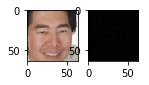

 22%|#    |ETA:   0:01:17  Epoch: 3   Iter: 698   Class Loss: 0.00   Loss: 0.15

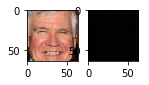

 26%|#    |ETA:   0:01:15  Epoch: 3   Iter: 796   Class Loss: 0.00   Loss: 0.16

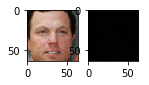

 29%|#    |ETA:   0:01:11  Epoch: 3   Iter: 896   Class Loss: 0.00   Loss: 0.15

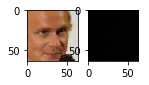

 32%|#    |ETA:   0:01:07  Epoch: 3   Iter: 996   Class Loss: 0.00   Loss: 0.18

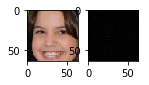

 35%|#   |ETA:   0:01:05  Epoch: 3   Iter: 1097   Class Loss: 0.00   Loss: 0.16

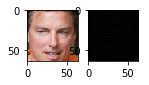

 39%|#   |ETA:   0:01:01  Epoch: 3   Iter: 1198   Class Loss: 0.00   Loss: 0.16

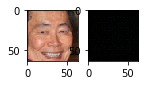

 42%|#   |ETA:   0:01:04  Epoch: 3   Iter: 1297   Class Loss: 0.00   Loss: 0.16

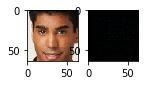

 45%|#   |ETA:   0:00:54  Epoch: 3   Iter: 1399   Class Loss: 0.00   Loss: 0.17

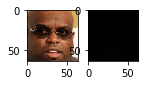

 49%|#   |ETA:   0:00:51  Epoch: 3   Iter: 1497   Class Loss: 0.00   Loss: 0.15

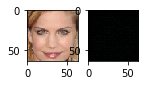

 52%|##  |ETA:   0:00:47  Epoch: 3   Iter: 1597   Class Loss: 0.00   Loss: 0.15

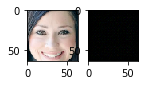

 55%|##  |ETA:   0:00:50  Epoch: 3   Iter: 1697   Class Loss: 0.00   Loss: 0.15

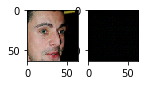

 58%|##  |ETA:   0:00:48  Epoch: 3   Iter: 1798   Class Loss: 0.00   Loss: 0.16

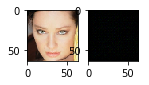

 62%|##  |ETA:   0:00:45  Epoch: 3   Iter: 1899   Class Loss: 0.00   Loss: 0.16

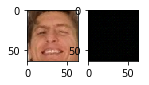

 65%|##  |ETA:   0:00:34  Epoch: 3   Iter: 1997   Class Loss: 0.00   Loss: 0.14

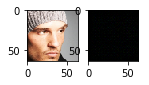

 68%|##  |ETA:   0:00:31  Epoch: 3   Iter: 2098   Class Loss: 0.00   Loss: 0.16

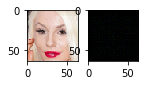

 72%|##  |ETA:   0:00:28  Epoch: 3   Iter: 2198   Class Loss: 0.00   Loss: 0.16

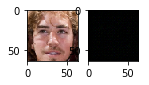

 75%|### |ETA:   0:00:24  Epoch: 3   Iter: 2299   Class Loss: 0.00   Loss: 0.15

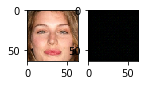

 78%|### |ETA:   0:00:24  Epoch: 3   Iter: 2399   Class Loss: 0.00   Loss: 0.17

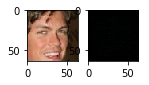

 81%|### |ETA:   0:00:21  Epoch: 3   Iter: 2499   Class Loss: 0.01   Loss: 0.16

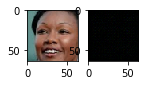

 85%|### |ETA:   0:00:17  Epoch: 3   Iter: 2599   Class Loss: 0.00   Loss: 0.14

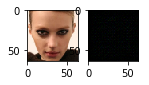

 88%|### |ETA:   0:00:11  Epoch: 3   Iter: 2698   Class Loss: 0.00   Loss: 0.17

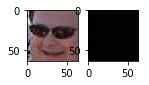

 91%|### |ETA:   0:00:08  Epoch: 3   Iter: 2796   Class Loss: 0.00   Loss: 0.15

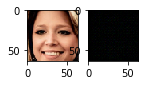

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2898   Class Loss: 0.00   Loss: 0.15

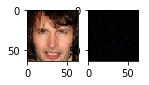

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2998   Class Loss: 0.00   Loss: 0.13

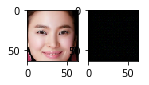

100%|####|Time:  0:01:49  Epoch: 3   Iter: 3052   Class Loss: 0.00   Loss: 0.16


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

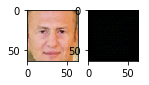

  3%|      |ETA:   0:01:36  Epoch: 4   Iter: 96   Class Loss: 0.00   Loss: 0.15

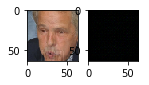

  6%|     |ETA:   0:01:33  Epoch: 4   Iter: 197   Class Loss: 0.00   Loss: 0.15

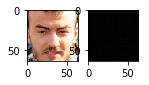

  9%|     |ETA:   0:01:30  Epoch: 4   Iter: 296   Class Loss: 0.00   Loss: 0.15

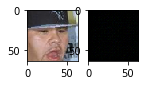

 13%|     |ETA:   0:01:27  Epoch: 4   Iter: 398   Class Loss: 0.00   Loss: 0.17

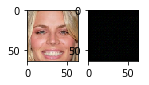

 16%|     |ETA:   0:01:24  Epoch: 4   Iter: 498   Class Loss: 0.00   Loss: 0.16

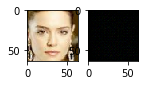

 19%|     |ETA:   0:01:20  Epoch: 4   Iter: 597   Class Loss: 0.00   Loss: 0.15

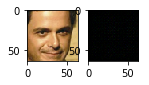

 22%|#    |ETA:   0:01:17  Epoch: 4   Iter: 699   Class Loss: 0.00   Loss: 0.15

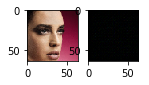

 26%|#    |ETA:   0:01:13  Epoch: 4   Iter: 799   Class Loss: 0.00   Loss: 0.15

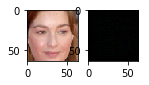

 29%|#    |ETA:   0:01:10  Epoch: 4   Iter: 898   Class Loss: 0.00   Loss: 0.15

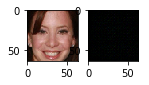

 32%|#    |ETA:   0:01:07  Epoch: 4   Iter: 999   Class Loss: 0.00   Loss: 0.16

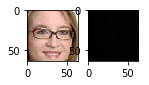

 35%|#   |ETA:   0:01:12  Epoch: 4   Iter: 1097   Class Loss: 0.00   Loss: 0.15

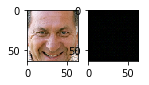

 39%|#   |ETA:   0:01:00  Epoch: 4   Iter: 1198   Class Loss: 0.00   Loss: 0.14

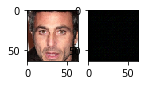

 42%|#   |ETA:   0:00:58  Epoch: 4   Iter: 1298   Class Loss: 0.00   Loss: 0.13

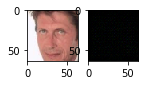

 45%|#   |ETA:   0:00:54  Epoch: 4   Iter: 1397   Class Loss: 0.00   Loss: 0.15

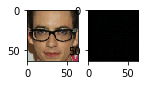

 49%|#   |ETA:   0:00:54  Epoch: 4   Iter: 1498   Class Loss: 0.00   Loss: 0.17

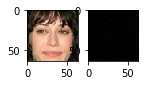

 52%|##  |ETA:   0:00:54  Epoch: 4   Iter: 1599   Class Loss: 0.00   Loss: 0.14

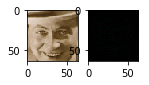

 55%|##  |ETA:   0:00:51  Epoch: 4   Iter: 1697   Class Loss: 0.00   Loss: 0.15

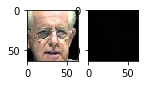

 58%|##  |ETA:   0:00:41  Epoch: 4   Iter: 1797   Class Loss: 0.00   Loss: 0.16

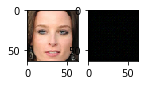

 62%|##  |ETA:   0:00:37  Epoch: 4   Iter: 1896   Class Loss: 0.00   Loss: 0.14

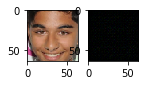

 65%|##  |ETA:   0:00:34  Epoch: 4   Iter: 1997   Class Loss: 0.00   Loss: 0.14

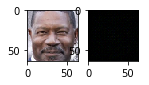

 68%|##  |ETA:   0:00:31  Epoch: 4   Iter: 2098   Class Loss: 0.00   Loss: 0.16

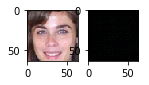

 72%|##  |ETA:   0:00:28  Epoch: 4   Iter: 2198   Class Loss: 0.00   Loss: 0.16

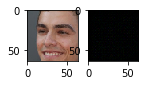

 75%|### |ETA:   0:00:24  Epoch: 4   Iter: 2299   Class Loss: 0.00   Loss: 0.16

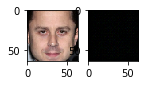

 78%|### |ETA:   0:00:21  Epoch: 4   Iter: 2399   Class Loss: 0.00   Loss: 0.16

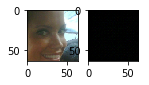

 81%|### |ETA:   0:00:18  Epoch: 4   Iter: 2496   Class Loss: 0.00   Loss: 0.15

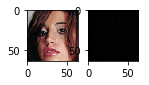

 85%|### |ETA:   0:00:14  Epoch: 4   Iter: 2599   Class Loss: 0.00   Loss: 0.17

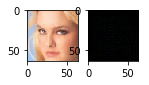

 88%|### |ETA:   0:00:11  Epoch: 4   Iter: 2696   Class Loss: 0.00   Loss: 0.16

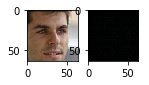

 91%|### |ETA:   0:00:08  Epoch: 4   Iter: 2796   Class Loss: 0.00   Loss: 0.16

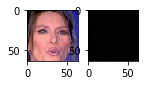

 94%|### |ETA:   0:00:05  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.16

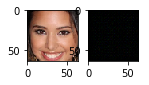

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2999   Class Loss: 0.00   Loss: 0.16

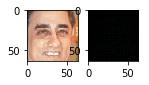

100%|####|Time:  0:01:46  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

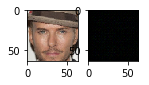

  3%|      |ETA:   0:01:38  Epoch: 5   Iter: 99   Class Loss: 0.00   Loss: 0.16

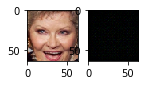

  6%|     |ETA:   0:01:34  Epoch: 5   Iter: 197   Class Loss: 0.00   Loss: 0.17

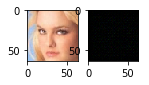

  9%|     |ETA:   0:01:30  Epoch: 5   Iter: 299   Class Loss: 0.00   Loss: 0.15

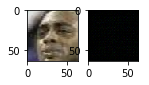

 13%|     |ETA:   0:01:27  Epoch: 5   Iter: 397   Class Loss: 0.00   Loss: 0.18

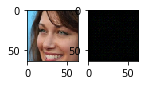

 16%|     |ETA:   0:01:24  Epoch: 5   Iter: 496   Class Loss: 0.00   Loss: 0.17

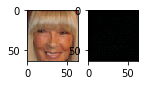

 19%|     |ETA:   0:01:20  Epoch: 5   Iter: 597   Class Loss: 0.00   Loss: 0.16

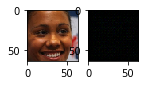

 22%|#    |ETA:   0:01:24  Epoch: 5   Iter: 698   Class Loss: 0.00   Loss: 0.14

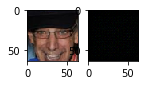

 26%|#    |ETA:   0:01:24  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.18

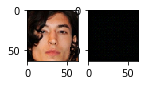

 29%|#    |ETA:   0:01:29  Epoch: 5   Iter: 897   Class Loss: 0.00   Loss: 0.16

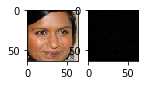

 32%|#    |ETA:   0:01:07  Epoch: 5   Iter: 996   Class Loss: 0.00   Loss: 0.16

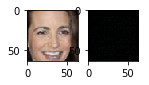

 35%|#   |ETA:   0:01:04  Epoch: 5   Iter: 1097   Class Loss: 0.00   Loss: 0.15

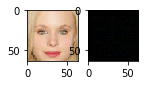

 39%|#   |ETA:   0:01:00  Epoch: 5   Iter: 1198   Class Loss: 0.00   Loss: 0.17

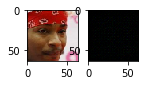

 42%|#   |ETA:   0:00:57  Epoch: 5   Iter: 1297   Class Loss: 0.00   Loss: 0.16

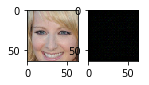

 45%|#   |ETA:   0:00:54  Epoch: 5   Iter: 1397   Class Loss: 0.00   Loss: 0.16

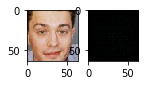

 49%|#   |ETA:   0:00:50  Epoch: 5   Iter: 1498   Class Loss: 0.00   Loss: 0.18

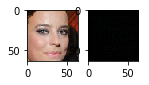

 52%|##  |ETA:   0:00:47  Epoch: 5   Iter: 1599   Class Loss: 0.00   Loss: 0.15

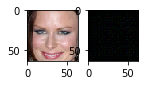

 55%|##  |ETA:   0:00:44  Epoch: 5   Iter: 1699   Class Loss: 0.00   Loss: 0.18

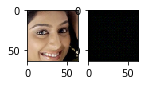

 58%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1796   Class Loss: 0.00   Loss: 0.17

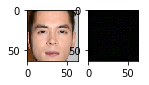

 62%|##  |ETA:   0:00:38  Epoch: 5   Iter: 1897   Class Loss: 0.00   Loss: 0.16

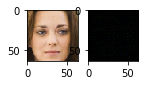

 65%|##  |ETA:   0:00:34  Epoch: 5   Iter: 1997   Class Loss: 0.00   Loss: 0.15

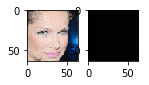

 68%|##  |ETA:   0:00:31  Epoch: 5   Iter: 2097   Class Loss: 0.00   Loss: 0.16

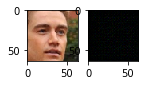

 72%|##  |ETA:   0:00:27  Epoch: 5   Iter: 2199   Class Loss: 0.00   Loss: 0.17

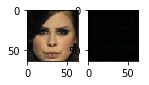

 75%|### |ETA:   0:00:24  Epoch: 5   Iter: 2299   Class Loss: 0.00   Loss: 0.16

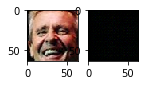

 78%|### |ETA:   0:00:21  Epoch: 5   Iter: 2399   Class Loss: 0.00   Loss: 0.17

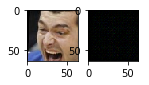

 81%|### |ETA:   0:00:18  Epoch: 5   Iter: 2497   Class Loss: 0.00   Loss: 0.17

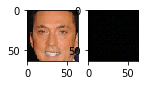

 85%|### |ETA:   0:00:14  Epoch: 5   Iter: 2599   Class Loss: 0.00   Loss: 0.15

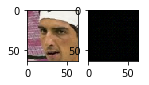

 88%|### |ETA:   0:00:11  Epoch: 5   Iter: 2697   Class Loss: 0.00   Loss: 0.17

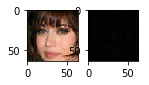

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2798   Class Loss: 0.00   Loss: 0.15

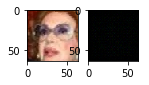

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2897   Class Loss: 0.00   Loss: 0.15

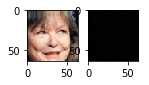

 98%|### |ETA:   0:00:01  Epoch: 5   Iter: 2999   Class Loss: 0.00   Loss: 0.15

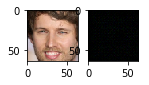

100%|####|Time:  0:01:46  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

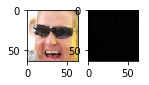

  3%|      |ETA:   0:01:51  Epoch: 6   Iter: 98   Class Loss: 0.01   Loss: 0.18

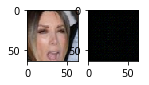

  6%|     |ETA:   0:01:33  Epoch: 6   Iter: 199   Class Loss: 0.00   Loss: 0.14

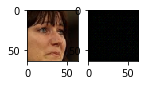

  9%|     |ETA:   0:01:30  Epoch: 6   Iter: 297   Class Loss: 0.00   Loss: 0.18

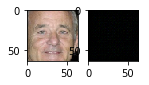

 13%|     |ETA:   0:01:26  Epoch: 6   Iter: 396   Class Loss: 0.00   Loss: 0.17

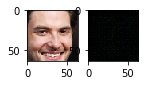

 16%|     |ETA:   0:01:24  Epoch: 6   Iter: 498   Class Loss: 0.00   Loss: 0.18

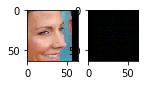

 19%|     |ETA:   0:01:20  Epoch: 6   Iter: 598   Class Loss: 0.00   Loss: 0.17

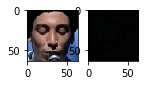

 22%|#    |ETA:   0:01:26  Epoch: 6   Iter: 698   Class Loss: 0.00   Loss: 0.17

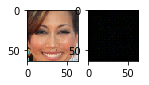

 26%|#    |ETA:   0:01:14  Epoch: 6   Iter: 797   Class Loss: 0.00   Loss: 0.15

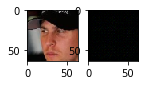

 29%|#    |ETA:   0:01:10  Epoch: 6   Iter: 896   Class Loss: 0.00   Loss: 0.16

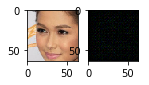

 32%|#    |ETA:   0:01:07  Epoch: 6   Iter: 997   Class Loss: 0.55   Loss: 0.70

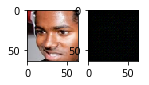

 35%|#   |ETA:   0:01:04  Epoch: 6   Iter: 1096   Class Loss: 0.00   Loss: 0.16

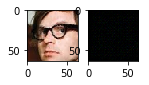

 39%|#   |ETA:   0:01:12  Epoch: 6   Iter: 1197   Class Loss: 0.00   Loss: 0.15

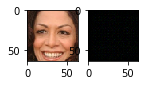

 42%|#   |ETA:   0:01:08  Epoch: 6   Iter: 1298   Class Loss: 0.00   Loss: 0.17

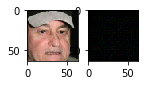

 45%|#   |ETA:   0:01:04  Epoch: 6   Iter: 1397   Class Loss: 0.00   Loss: 0.17

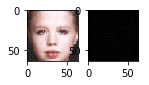

 49%|#   |ETA:   0:00:51  Epoch: 6   Iter: 1498   Class Loss: 0.00   Loss: 0.16

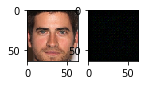

 52%|##  |ETA:   0:00:47  Epoch: 6   Iter: 1596   Class Loss: 0.00   Loss: 0.16

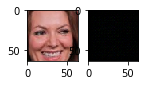

 55%|##  |ETA:   0:00:44  Epoch: 6   Iter: 1696   Class Loss: 0.00   Loss: 0.19

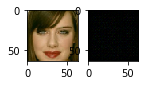

 58%|##  |ETA:   0:00:41  Epoch: 6   Iter: 1796   Class Loss: 0.00   Loss: 0.15

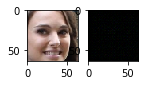

 62%|##  |ETA:   0:00:44  Epoch: 6   Iter: 1899   Class Loss: 0.00   Loss: 0.16

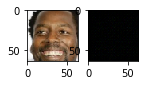

 65%|##  |ETA:   0:00:36  Epoch: 6   Iter: 1997   Class Loss: 0.00   Loss: 0.13

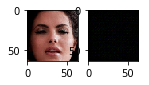

 68%|##  |ETA:   0:00:31  Epoch: 6   Iter: 2098   Class Loss: 0.00   Loss: 0.17

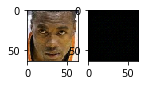

 72%|##  |ETA:   0:00:31  Epoch: 6   Iter: 2199   Class Loss: 0.00   Loss: 0.16

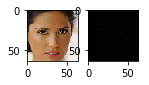

 75%|### |ETA:   0:00:28  Epoch: 6   Iter: 2298   Class Loss: 0.00   Loss: 0.15

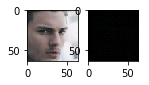

 78%|### |ETA:   0:00:22  Epoch: 6   Iter: 2398   Class Loss: 0.00   Loss: 0.15

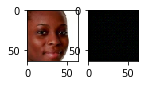

 81%|### |ETA:   0:00:18  Epoch: 6   Iter: 2499   Class Loss: 0.00   Loss: 0.15

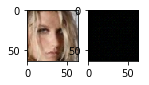

 85%|### |ETA:   0:00:14  Epoch: 6   Iter: 2597   Class Loss: 0.00   Loss: 0.13

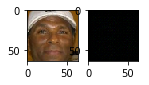

 88%|### |ETA:   0:00:11  Epoch: 6   Iter: 2697   Class Loss: 0.00   Loss: 0.16

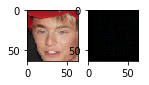

 91%|### |ETA:   0:00:08  Epoch: 6   Iter: 2796   Class Loss: 0.00   Loss: 0.14

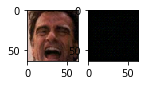

 94%|### |ETA:   0:00:05  Epoch: 6   Iter: 2898   Class Loss: 0.00   Loss: 0.13

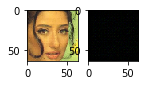

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2996   Class Loss: 0.00   Loss: 0.16

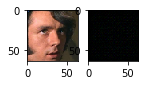

100%|####|Time:  0:01:49  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

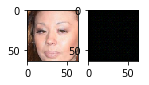

  3%|      |ETA:   0:01:36  Epoch: 7   Iter: 98   Class Loss: 0.00   Loss: 0.16

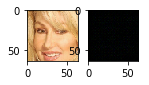

  6%|     |ETA:   0:01:34  Epoch: 7   Iter: 199   Class Loss: 0.00   Loss: 0.15

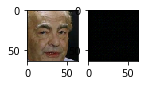

  9%|     |ETA:   0:01:31  Epoch: 7   Iter: 296   Class Loss: 0.00   Loss: 0.15

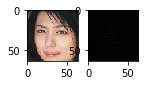

 13%|     |ETA:   0:01:27  Epoch: 7   Iter: 397   Class Loss: 0.00   Loss: 0.17

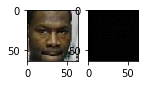

 16%|     |ETA:   0:01:34  Epoch: 7   Iter: 496   Class Loss: 0.00   Loss: 0.16

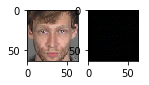

 19%|     |ETA:   0:01:23  Epoch: 7   Iter: 596   Class Loss: 0.00   Loss: 0.16

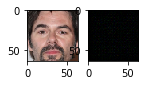

 22%|#    |ETA:   0:01:18  Epoch: 7   Iter: 699   Class Loss: 0.00   Loss: 0.16

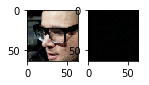

 26%|#    |ETA:   0:01:14  Epoch: 7   Iter: 798   Class Loss: 0.00   Loss: 0.16

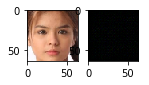

 29%|#    |ETA:   0:01:12  Epoch: 7   Iter: 899   Class Loss: 0.00   Loss: 0.17

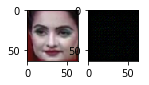

 32%|#    |ETA:   0:01:07  Epoch: 7   Iter: 996   Class Loss: 0.00   Loss: 0.16

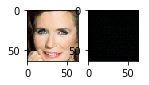

 35%|#   |ETA:   0:01:04  Epoch: 7   Iter: 1096   Class Loss: 0.00   Loss: 0.15

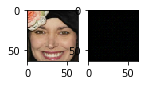

 39%|#   |ETA:   0:01:00  Epoch: 7   Iter: 1197   Class Loss: 0.00   Loss: 0.14

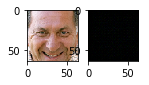

 42%|#   |ETA:   0:01:00  Epoch: 7   Iter: 1299   Class Loss: 0.00   Loss: 0.17

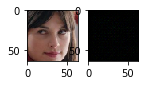

 45%|#   |ETA:   0:01:02  Epoch: 7   Iter: 1397   Class Loss: 0.00   Loss: 0.16

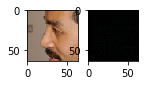

 49%|#   |ETA:   0:00:59  Epoch: 7   Iter: 1498   Class Loss: 0.00   Loss: 0.17

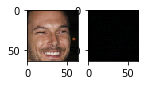

 52%|##  |ETA:   0:00:48  Epoch: 7   Iter: 1597   Class Loss: 0.00   Loss: 0.17

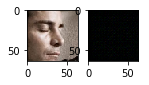

 55%|##  |ETA:   0:00:44  Epoch: 7   Iter: 1699   Class Loss: 0.00   Loss: 0.16

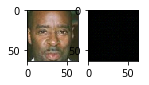

 58%|##  |ETA:   0:00:41  Epoch: 7   Iter: 1798   Class Loss: 0.00   Loss: 0.18

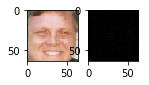

 62%|##  |ETA:   0:00:38  Epoch: 7   Iter: 1897   Class Loss: 0.00   Loss: 0.14

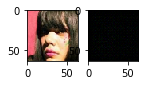

 65%|##  |ETA:   0:00:34  Epoch: 7   Iter: 1999   Class Loss: 0.00   Loss: 0.16

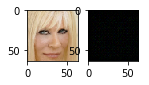

 68%|##  |ETA:   0:00:31  Epoch: 7   Iter: 2097   Class Loss: 0.00   Loss: 0.15

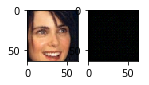

 72%|##  |ETA:   0:00:28  Epoch: 7   Iter: 2198   Class Loss: 0.00   Loss: 0.17

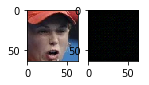

 75%|### |ETA:   0:00:25  Epoch: 7   Iter: 2296   Class Loss: 0.00   Loss: 0.17

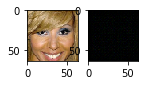

 78%|### |ETA:   0:00:21  Epoch: 7   Iter: 2399   Class Loss: 0.00   Loss: 0.17

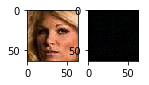

 81%|### |ETA:   0:00:18  Epoch: 7   Iter: 2497   Class Loss: 0.00   Loss: 0.17

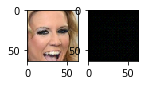

 85%|### |ETA:   0:00:15  Epoch: 7   Iter: 2599   Class Loss: 0.00   Loss: 0.18

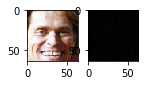

 88%|### |ETA:   0:00:11  Epoch: 7   Iter: 2697   Class Loss: 0.00   Loss: 0.20

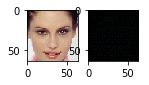

 91%|### |ETA:   0:00:08  Epoch: 7   Iter: 2797   Class Loss: 0.00   Loss: 0.19

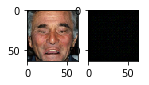

 94%|### |ETA:   0:00:05  Epoch: 7   Iter: 2897   Class Loss: 0.00   Loss: 0.16

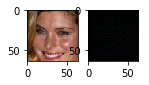

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2998   Class Loss: 0.00   Loss: 0.17

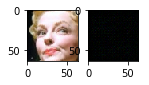

100%|####|Time:  0:01:46  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

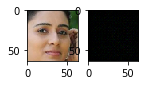

  3%|      |ETA:   0:01:36  Epoch: 8   Iter: 96   Class Loss: 0.00   Loss: 0.16

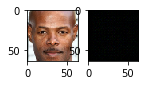

  6%|     |ETA:   0:01:34  Epoch: 8   Iter: 196   Class Loss: 0.00   Loss: 0.16

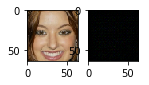

  9%|     |ETA:   0:01:41  Epoch: 8   Iter: 298   Class Loss: 0.16   Loss: 0.29

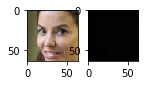

 13%|     |ETA:   0:01:27  Epoch: 8   Iter: 398   Class Loss: 0.00   Loss: 0.19

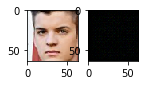

 16%|     |ETA:   0:01:35  Epoch: 8   Iter: 499   Class Loss: 0.00   Loss: 0.16

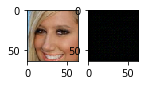

 19%|     |ETA:   0:01:32  Epoch: 8   Iter: 597   Class Loss: 0.00   Loss: 0.16

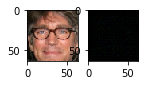

 22%|#    |ETA:   0:01:29  Epoch: 8   Iter: 698   Class Loss: 0.00   Loss: 0.17

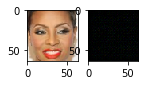

 26%|#    |ETA:   0:01:14  Epoch: 8   Iter: 799   Class Loss: 0.00   Loss: 0.16

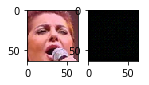

 29%|#    |ETA:   0:01:11  Epoch: 8   Iter: 899   Class Loss: 0.00   Loss: 0.17

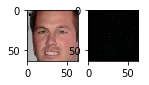

 32%|#    |ETA:   0:01:07  Epoch: 8   Iter: 999   Class Loss: 0.03   Loss: 0.16

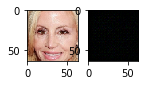

 35%|#   |ETA:   0:01:04  Epoch: 8   Iter: 1096   Class Loss: 0.00   Loss: 0.17

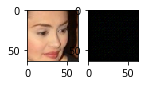

 39%|#   |ETA:   0:01:01  Epoch: 8   Iter: 1198   Class Loss: 0.00   Loss: 0.17

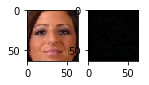

 42%|#   |ETA:   0:00:59  Epoch: 8   Iter: 1296   Class Loss: 0.00   Loss: 0.16

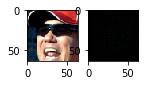

 45%|#   |ETA:   0:00:55  Epoch: 8   Iter: 1398   Class Loss: 0.00   Loss: 0.14

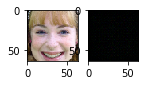

 49%|#   |ETA:   0:00:51  Epoch: 8   Iter: 1496   Class Loss: 0.00   Loss: 0.16

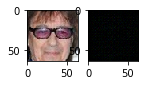

 52%|##  |ETA:   0:00:47  Epoch: 8   Iter: 1599   Class Loss: 0.00   Loss: 0.16

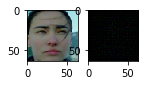

 55%|##  |ETA:   0:00:44  Epoch: 8   Iter: 1698   Class Loss: 0.00   Loss: 0.17

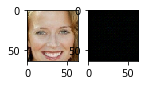

 58%|##  |ETA:   0:00:41  Epoch: 8   Iter: 1796   Class Loss: 0.00   Loss: 0.17

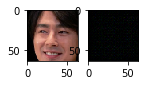

 62%|##  |ETA:   0:00:38  Epoch: 8   Iter: 1896   Class Loss: 0.00   Loss: 0.16

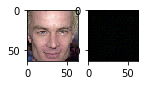

 65%|##  |ETA:   0:00:35  Epoch: 8   Iter: 1996   Class Loss: 0.00   Loss: 0.19

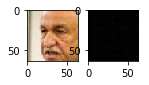

 68%|##  |ETA:   0:00:31  Epoch: 8   Iter: 2097   Class Loss: 0.00   Loss: 0.17

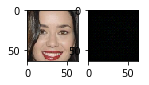

 71%|##  |ETA:   0:00:28  Epoch: 8   Iter: 2196   Class Loss: 0.00   Loss: 0.15

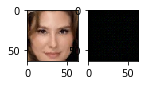

 75%|### |ETA:   0:00:25  Epoch: 8   Iter: 2297   Class Loss: 0.01   Loss: 0.19

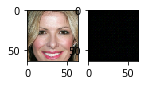

 78%|### |ETA:   0:00:21  Epoch: 8   Iter: 2399   Class Loss: 0.00   Loss: 0.15

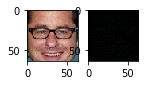

 81%|### |ETA:   0:00:18  Epoch: 8   Iter: 2498   Class Loss: 0.00   Loss: 0.16

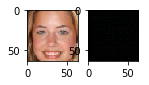

 85%|### |ETA:   0:00:14  Epoch: 8   Iter: 2597   Class Loss: 0.00   Loss: 0.18

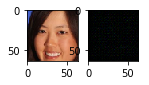

 88%|### |ETA:   0:00:11  Epoch: 8   Iter: 2696   Class Loss: 0.00   Loss: 0.17

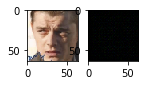

 91%|### |ETA:   0:00:09  Epoch: 8   Iter: 2797   Class Loss: 0.00   Loss: 0.15

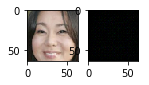

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2898   Class Loss: 0.00   Loss: 0.16

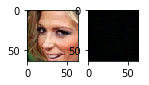

 98%|### |ETA:   0:00:02  Epoch: 8   Iter: 2999   Class Loss: 0.00   Loss: 0.17

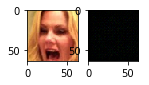

100%|####|Time:  0:01:47  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

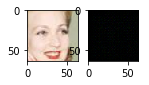

  3%|      |ETA:   0:01:49  Epoch: 9   Iter: 97   Class Loss: 0.00   Loss: 0.16

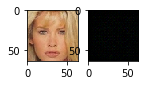

  6%|     |ETA:   0:01:33  Epoch: 9   Iter: 196   Class Loss: 0.00   Loss: 0.16

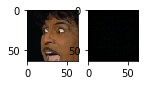

  9%|     |ETA:   0:01:30  Epoch: 9   Iter: 296   Class Loss: 0.00   Loss: 0.17

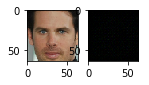

 13%|     |ETA:   0:01:26  Epoch: 9   Iter: 398   Class Loss: 0.00   Loss: 0.16

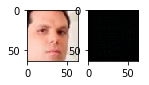

 16%|     |ETA:   0:01:24  Epoch: 9   Iter: 497   Class Loss: 0.00   Loss: 0.14

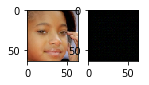

 19%|     |ETA:   0:01:25  Epoch: 9   Iter: 597   Class Loss: 0.00   Loss: 0.15

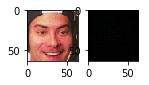

 22%|#    |ETA:   0:01:31  Epoch: 9   Iter: 698   Class Loss: 0.00   Loss: 0.15

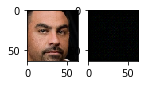

 26%|#    |ETA:   0:01:28  Epoch: 9   Iter: 799   Class Loss: 0.00   Loss: 0.17

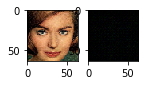

 29%|#    |ETA:   0:01:11  Epoch: 9   Iter: 899   Class Loss: 0.00   Loss: 0.15

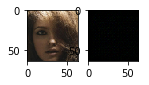

 32%|#    |ETA:   0:01:07  Epoch: 9   Iter: 996   Class Loss: 0.00   Loss: 0.14

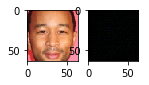

 35%|#   |ETA:   0:01:04  Epoch: 9   Iter: 1097   Class Loss: 0.00   Loss: 0.13

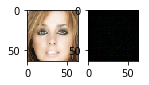

 39%|#   |ETA:   0:01:11  Epoch: 9   Iter: 1198   Class Loss: 0.00   Loss: 0.16

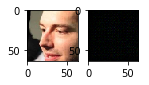

 42%|#   |ETA:   0:00:57  Epoch: 9   Iter: 1298   Class Loss: 0.80   Loss: 0.97

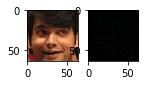

 45%|#   |ETA:   0:00:54  Epoch: 9   Iter: 1399   Class Loss: 0.00   Loss: 0.17

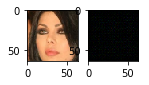

 49%|#   |ETA:   0:00:51  Epoch: 9   Iter: 1498   Class Loss: 0.00   Loss: 0.15

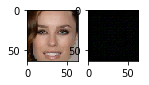

 52%|##  |ETA:   0:00:48  Epoch: 9   Iter: 1598   Class Loss: 0.00   Loss: 0.16

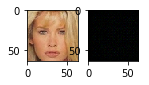

 55%|##  |ETA:   0:00:45  Epoch: 9   Iter: 1697   Class Loss: 0.00   Loss: 0.16

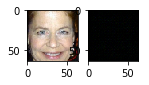

 58%|##  |ETA:   0:00:41  Epoch: 9   Iter: 1799   Class Loss: 0.00   Loss: 0.20

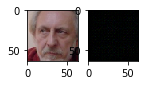

 62%|##  |ETA:   0:00:40  Epoch: 9   Iter: 1898   Class Loss: 0.00   Loss: 0.16

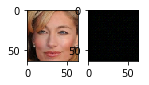

 65%|##  |ETA:   0:00:39  Epoch: 9   Iter: 1997   Class Loss: 0.00   Loss: 0.16

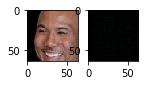

 68%|##  |ETA:   0:00:36  Epoch: 9   Iter: 2098   Class Loss: 0.00   Loss: 0.16

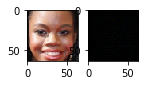

 71%|##  |ETA:   0:00:28  Epoch: 9   Iter: 2197   Class Loss: 0.00   Loss: 0.15

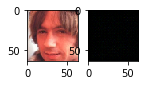

 75%|### |ETA:   0:00:25  Epoch: 9   Iter: 2296   Class Loss: 0.00   Loss: 0.15

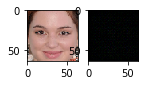

 78%|### |ETA:   0:00:21  Epoch: 9   Iter: 2399   Class Loss: 0.00   Loss: 0.13

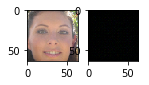

 81%|### |ETA:   0:00:18  Epoch: 9   Iter: 2498   Class Loss: 0.00   Loss: 0.20

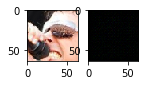

 85%|### |ETA:   0:00:15  Epoch: 9   Iter: 2599   Class Loss: 0.00   Loss: 0.16

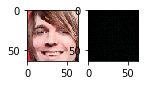

 88%|### |ETA:   0:00:11  Epoch: 9   Iter: 2696   Class Loss: 0.00   Loss: 0.17

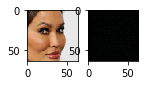

 91%|### |ETA:   0:00:08  Epoch: 9   Iter: 2796   Class Loss: 0.00   Loss: 0.14

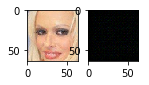

 94%|### |ETA:   0:00:05  Epoch: 9   Iter: 2898   Class Loss: 0.00   Loss: 0.15

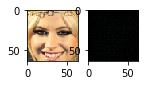

 98%|### |ETA:   0:00:02  Epoch: 9   Iter: 2997   Class Loss: 0.00   Loss: 0.16

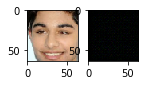

100%|####|Time:  0:01:49  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.17
100% (97 of 97) |########################| Elapsed Time: 0:01:09 Time:  0:01:09
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 0.886597938144


100% (72 of 72) |########################| Elapsed Time: 0:00:49 Time:  0:00:49
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.888888888889


100% (78 of 78) |########################| Elapsed Time: 0:00:53 Time:  0:00:53
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.833333333333


100% (71 of 71) |########################| Elapsed Time: 0:00:49 Time:  0:00:49



female darker: 0.87323943662


Text(0,0.5,'Accuracy')

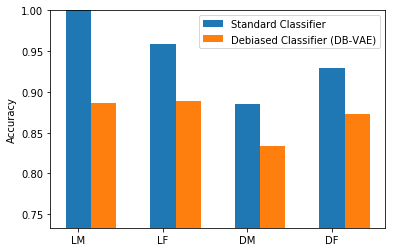

In [41]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.5)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

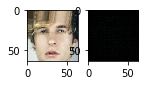

  3%|      |ETA:   0:01:57  Epoch: 0   Iter: 98   Class Loss: 0.00   Loss: 0.18

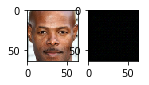

  6%|     |ETA:   0:01:41  Epoch: 0   Iter: 196   Class Loss: 0.00   Loss: 0.16

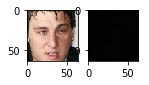

  9%|     |ETA:   0:01:34  Epoch: 0   Iter: 297   Class Loss: 0.00   Loss: 0.18

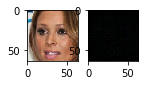

 13%|     |ETA:   0:01:42  Epoch: 0   Iter: 398   Class Loss: 0.00   Loss: 0.18

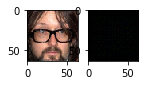

 16%|     |ETA:   0:01:24  Epoch: 0   Iter: 497   Class Loss: 0.00   Loss: 0.19

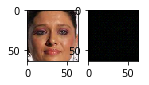

 19%|     |ETA:   0:01:21  Epoch: 0   Iter: 597   Class Loss: 0.00   Loss: 0.15

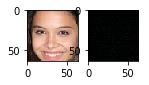

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 698   Class Loss: 0.00   Loss: 0.17

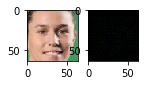

 26%|#    |ETA:   0:01:14  Epoch: 0   Iter: 797   Class Loss: 0.00   Loss: 0.18

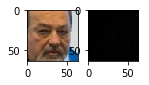

 29%|#    |ETA:   0:01:11  Epoch: 0   Iter: 898   Class Loss: 0.02   Loss: 0.19

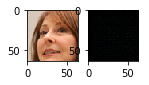

 32%|#    |ETA:   0:01:09  Epoch: 0   Iter: 996   Class Loss: 0.00   Loss: 0.18

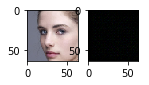

 35%|#   |ETA:   0:01:04  Epoch: 0   Iter: 1097   Class Loss: 0.00   Loss: 0.16

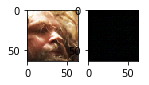

 39%|#   |ETA:   0:01:01  Epoch: 0   Iter: 1198   Class Loss: 0.00   Loss: 0.15

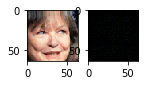

 42%|#   |ETA:   0:00:57  Epoch: 0   Iter: 1296   Class Loss: 0.00   Loss: 0.16

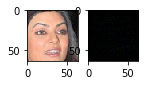

 45%|#   |ETA:   0:00:55  Epoch: 0   Iter: 1398   Class Loss: 0.00   Loss: 0.18

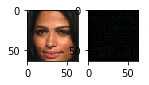

 49%|#   |ETA:   0:00:51  Epoch: 0   Iter: 1496   Class Loss: 0.00   Loss: 0.15

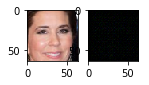

 52%|##  |ETA:   0:00:54  Epoch: 0   Iter: 1599   Class Loss: 0.00   Loss: 0.14

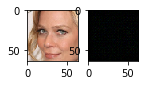

 55%|##  |ETA:   0:00:51  Epoch: 0   Iter: 1697   Class Loss: 0.00   Loss: 0.15

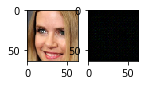

 58%|##  |ETA:   0:00:47  Epoch: 0   Iter: 1798   Class Loss: 0.00   Loss: 0.17

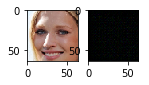

 62%|##  |ETA:   0:00:38  Epoch: 0   Iter: 1897   Class Loss: 0.00   Loss: 0.16

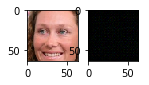

 65%|##  |ETA:   0:00:34  Epoch: 0   Iter: 1996   Class Loss: 0.00   Loss: 0.18

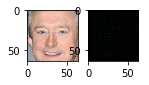

 68%|##  |ETA:   0:00:31  Epoch: 0   Iter: 2098   Class Loss: 0.00   Loss: 0.17

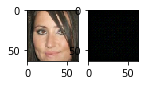

 72%|##  |ETA:   0:00:27  Epoch: 0   Iter: 2198   Class Loss: 0.00   Loss: 0.15

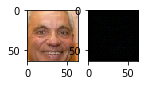

 75%|### |ETA:   0:00:24  Epoch: 0   Iter: 2296   Class Loss: 0.00   Loss: 0.16

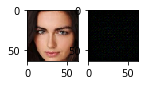

 78%|### |ETA:   0:00:21  Epoch: 0   Iter: 2396   Class Loss: 0.00   Loss: 0.15

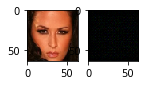

 81%|### |ETA:   0:00:18  Epoch: 0   Iter: 2496   Class Loss: 0.00   Loss: 0.17

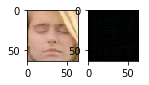

 85%|### |ETA:   0:00:15  Epoch: 0   Iter: 2596   Class Loss: 0.00   Loss: 0.18

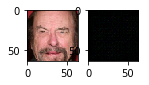

 88%|### |ETA:   0:00:13  Epoch: 0   Iter: 2697   Class Loss: 0.00   Loss: 0.20

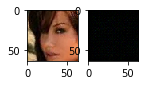

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2798   Class Loss: 0.00   Loss: 0.18

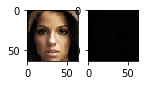

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2897   Class Loss: 0.00   Loss: 0.17

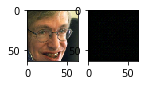

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2998   Class Loss: 0.00   Loss: 0.17

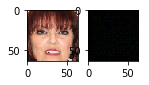

100%|####|Time:  0:01:48  Epoch: 0   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

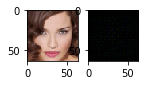

  3%|      |ETA:   0:01:37  Epoch: 1   Iter: 97   Class Loss: 0.00   Loss: 0.18

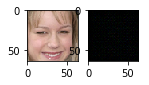

  6%|     |ETA:   0:01:34  Epoch: 1   Iter: 197   Class Loss: 0.00   Loss: 0.17

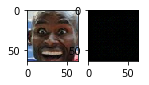

  9%|     |ETA:   0:01:29  Epoch: 1   Iter: 298   Class Loss: 0.00   Loss: 0.18

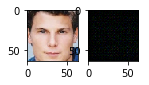

 13%|     |ETA:   0:01:27  Epoch: 1   Iter: 396   Class Loss: 0.00   Loss: 0.19

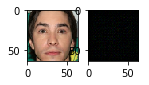

 16%|     |ETA:   0:01:24  Epoch: 1   Iter: 498   Class Loss: 0.00   Loss: 0.17

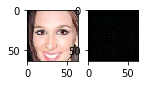

 19%|     |ETA:   0:01:21  Epoch: 1   Iter: 598   Class Loss: 0.00   Loss: 0.15

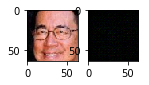

 22%|#    |ETA:   0:01:17  Epoch: 1   Iter: 699   Class Loss: 0.00   Loss: 0.17

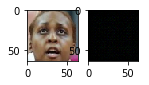

 26%|#    |ETA:   0:01:25  Epoch: 1   Iter: 799   Class Loss: 0.00   Loss: 0.17

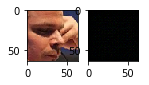

 29%|#    |ETA:   0:01:21  Epoch: 1   Iter: 897   Class Loss: 0.00   Loss: 0.16

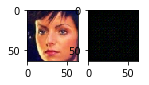

 32%|#    |ETA:   0:01:13  Epoch: 1   Iter: 997   Class Loss: 0.00   Loss: 0.16

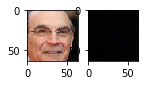

 35%|#   |ETA:   0:01:04  Epoch: 1   Iter: 1097   Class Loss: 0.00   Loss: 0.15

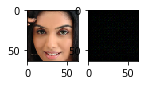

 39%|#   |ETA:   0:01:01  Epoch: 1   Iter: 1198   Class Loss: 0.00   Loss: 0.17

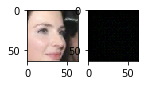

 42%|#   |ETA:   0:00:57  Epoch: 1   Iter: 1297   Class Loss: 0.00   Loss: 0.16

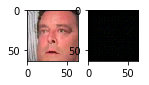

 45%|#   |ETA:   0:00:55  Epoch: 1   Iter: 1397   Class Loss: 0.00   Loss: 0.17

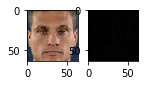

 49%|#   |ETA:   0:00:51  Epoch: 1   Iter: 1499   Class Loss: 0.00   Loss: 0.17

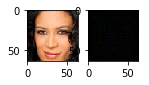

 52%|##  |ETA:   0:00:47  Epoch: 1   Iter: 1599   Class Loss: 0.00   Loss: 0.15

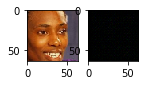

 55%|##  |ETA:   0:00:44  Epoch: 1   Iter: 1699   Class Loss: 0.00   Loss: 0.16

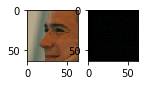

 58%|##  |ETA:   0:00:41  Epoch: 1   Iter: 1798   Class Loss: 0.00   Loss: 0.17

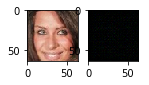

 62%|##  |ETA:   0:00:38  Epoch: 1   Iter: 1897   Class Loss: 0.00   Loss: 0.18

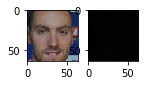

 65%|##  |ETA:   0:00:35  Epoch: 1   Iter: 1998   Class Loss: 0.00   Loss: 0.19

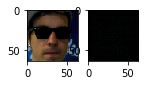

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2097   Class Loss: 0.00   Loss: 0.17

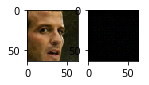

 72%|##  |ETA:   0:00:27  Epoch: 1   Iter: 2199   Class Loss: 0.00   Loss: 0.16

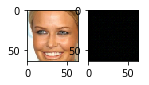

 75%|### |ETA:   0:00:25  Epoch: 1   Iter: 2298   Class Loss: 0.00   Loss: 0.14

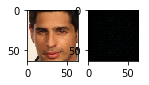

 78%|### |ETA:   0:00:21  Epoch: 1   Iter: 2399   Class Loss: 0.00   Loss: 0.17

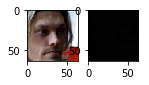

 81%|### |ETA:   0:00:20  Epoch: 1   Iter: 2496   Class Loss: 0.00   Loss: 0.18

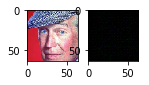

 85%|### |ETA:   0:00:14  Epoch: 1   Iter: 2597   Class Loss: 0.00   Loss: 0.15

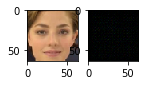

 88%|### |ETA:   0:00:11  Epoch: 1   Iter: 2697   Class Loss: 0.00   Loss: 0.16

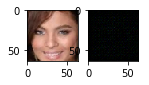

 91%|### |ETA:   0:00:08  Epoch: 1   Iter: 2796   Class Loss: 0.00   Loss: 0.20

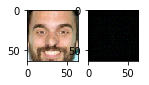

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2898   Class Loss: 0.00   Loss: 0.17

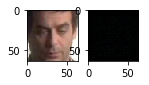

 98%|### |ETA:   0:00:01  Epoch: 1   Iter: 2999   Class Loss: 0.00   Loss: 0.16

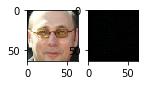

100%|####|Time:  0:01:46  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.19


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

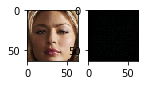

  3%|      |ETA:   0:01:51  Epoch: 2   Iter: 98   Class Loss: 0.00   Loss: 0.14

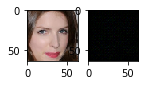

  6%|     |ETA:   0:01:38  Epoch: 2   Iter: 196   Class Loss: 0.00   Loss: 0.17

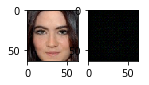

  9%|     |ETA:   0:01:31  Epoch: 2   Iter: 297   Class Loss: 0.00   Loss: 0.18

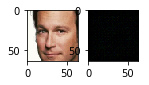

 13%|     |ETA:   0:01:28  Epoch: 2   Iter: 396   Class Loss: 0.00   Loss: 0.16

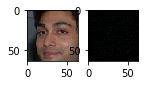

 16%|     |ETA:   0:01:24  Epoch: 2   Iter: 497   Class Loss: 0.00   Loss: 0.16

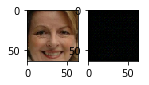

 19%|     |ETA:   0:01:21  Epoch: 2   Iter: 599   Class Loss: 0.00   Loss: 0.15

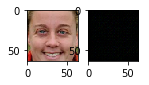

 22%|#    |ETA:   0:01:17  Epoch: 2   Iter: 699   Class Loss: 0.00   Loss: 0.14

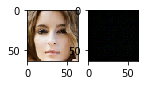

 26%|#    |ETA:   0:01:14  Epoch: 2   Iter: 797   Class Loss: 0.00   Loss: 0.16

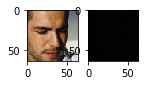

 29%|#    |ETA:   0:01:10  Epoch: 2   Iter: 898   Class Loss: 0.00   Loss: 0.15

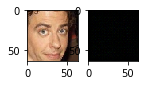

 32%|#    |ETA:   0:01:08  Epoch: 2   Iter: 996   Class Loss: 0.00   Loss: 0.19

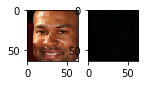

 35%|#   |ETA:   0:01:04  Epoch: 2   Iter: 1097   Class Loss: 0.00   Loss: 0.16

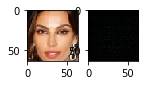

 39%|#   |ETA:   0:01:01  Epoch: 2   Iter: 1197   Class Loss: 0.00   Loss: 0.15

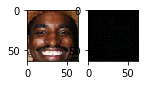

 42%|#   |ETA:   0:00:57  Epoch: 2   Iter: 1297   Class Loss: 0.00   Loss: 0.17

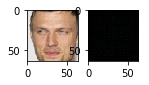

 45%|#   |ETA:   0:00:54  Epoch: 2   Iter: 1399   Class Loss: 0.00   Loss: 0.14

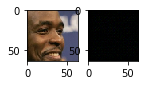

 49%|#   |ETA:   0:00:51  Epoch: 2   Iter: 1498   Class Loss: 0.00   Loss: 0.15

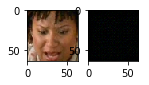

 52%|##  |ETA:   0:00:48  Epoch: 2   Iter: 1596   Class Loss: 0.00   Loss: 0.16

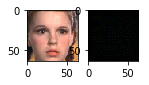

 55%|##  |ETA:   0:00:44  Epoch: 2   Iter: 1698   Class Loss: 0.00   Loss: 0.14

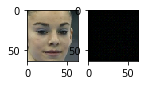

 58%|##  |ETA:   0:00:41  Epoch: 2   Iter: 1797   Class Loss: 0.00   Loss: 0.16

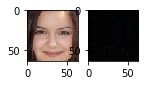

 62%|##  |ETA:   0:00:37  Epoch: 2   Iter: 1899   Class Loss: 0.00   Loss: 0.14

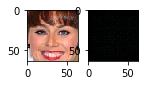

 65%|##  |ETA:   0:00:34  Epoch: 2   Iter: 1998   Class Loss: 0.00   Loss: 0.15

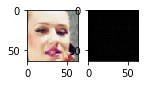

 68%|##  |ETA:   0:00:31  Epoch: 2   Iter: 2097   Class Loss: 0.00   Loss: 0.18

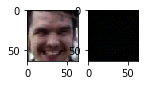

 72%|##  |ETA:   0:00:28  Epoch: 2   Iter: 2198   Class Loss: 0.00   Loss: 0.19

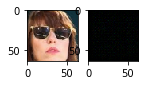

 75%|### |ETA:   0:00:28  Epoch: 2   Iter: 2298   Class Loss: 0.00   Loss: 0.21

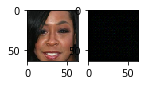

 78%|### |ETA:   0:00:24  Epoch: 2   Iter: 2399   Class Loss: 0.00   Loss: 0.17

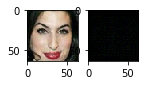

 81%|### |ETA:   0:00:21  Epoch: 2   Iter: 2497   Class Loss: 0.00   Loss: 0.18

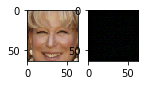

 85%|### |ETA:   0:00:17  Epoch: 2   Iter: 2598   Class Loss: 0.00   Loss: 0.19

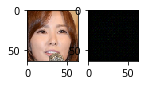

 88%|### |ETA:   0:00:13  Epoch: 2   Iter: 2699   Class Loss: 0.00   Loss: 0.16

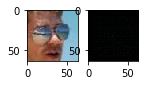

 91%|### |ETA:   0:00:09  Epoch: 2   Iter: 2797   Class Loss: 0.00   Loss: 0.17

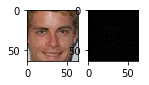

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2897   Class Loss: 0.00   Loss: 0.19

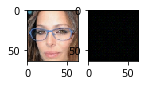

 98%|### |ETA:   0:00:01  Epoch: 2   Iter: 2999   Class Loss: 0.00   Loss: 0.17

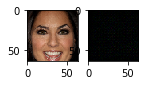

100%|####|Time:  0:01:49  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

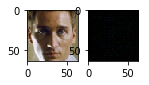

  3%|      |ETA:   0:01:37  Epoch: 3   Iter: 99   Class Loss: 0.00   Loss: 0.14

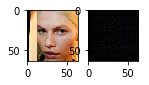

  6%|     |ETA:   0:01:33  Epoch: 3   Iter: 197   Class Loss: 0.00   Loss: 0.17

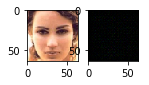

  9%|     |ETA:   0:01:31  Epoch: 3   Iter: 299   Class Loss: 0.00   Loss: 0.16

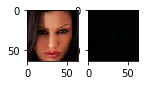

 13%|     |ETA:   0:01:28  Epoch: 3   Iter: 399   Class Loss: 0.00   Loss: 0.15

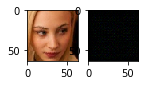

 16%|     |ETA:   0:01:24  Epoch: 3   Iter: 499   Class Loss: 0.00   Loss: 0.17

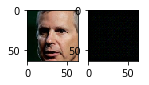

 19%|     |ETA:   0:01:21  Epoch: 3   Iter: 597   Class Loss: 0.00   Loss: 0.18

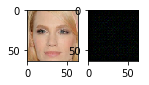

 22%|#    |ETA:   0:01:17  Epoch: 3   Iter: 698   Class Loss: 0.00   Loss: 0.17

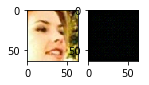

 26%|#    |ETA:   0:01:13  Epoch: 3   Iter: 799   Class Loss: 0.00   Loss: 0.17

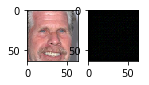

 29%|#    |ETA:   0:01:10  Epoch: 3   Iter: 899   Class Loss: 0.00   Loss: 0.16

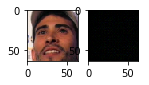

 32%|#    |ETA:   0:01:07  Epoch: 3   Iter: 997   Class Loss: 0.00   Loss: 0.15

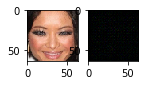

 35%|#   |ETA:   0:01:04  Epoch: 3   Iter: 1097   Class Loss: 0.00   Loss: 0.14

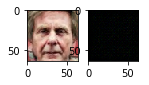

 39%|#   |ETA:   0:01:02  Epoch: 3   Iter: 1197   Class Loss: 0.00   Loss: 0.17

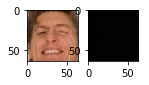

 42%|#   |ETA:   0:00:58  Epoch: 3   Iter: 1298   Class Loss: 0.00   Loss: 0.17

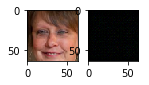

 45%|#   |ETA:   0:01:02  Epoch: 3   Iter: 1397   Class Loss: 0.00   Loss: 0.17

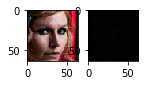

 49%|#   |ETA:   0:00:58  Epoch: 3   Iter: 1498   Class Loss: 0.00   Loss: 0.16

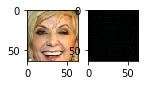

 52%|##  |ETA:   0:00:52  Epoch: 3   Iter: 1596   Class Loss: 0.00   Loss: 0.18

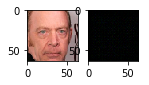

 55%|##  |ETA:   0:00:44  Epoch: 3   Iter: 1697   Class Loss: 0.00   Loss: 0.15

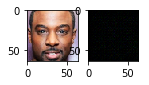

 58%|##  |ETA:   0:00:41  Epoch: 3   Iter: 1799   Class Loss: 0.00   Loss: 0.16

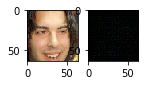

 62%|##  |ETA:   0:00:38  Epoch: 3   Iter: 1897   Class Loss: 0.00   Loss: 0.16

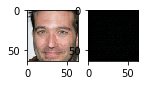

 65%|##  |ETA:   0:00:35  Epoch: 3   Iter: 1996   Class Loss: 0.00   Loss: 0.16

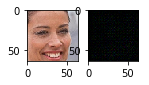

 68%|##  |ETA:   0:00:35  Epoch: 3   Iter: 2098   Class Loss: 0.00   Loss: 0.19

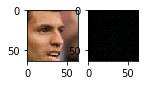

 71%|##  |ETA:   0:00:28  Epoch: 3   Iter: 2197   Class Loss: 0.00   Loss: 0.19

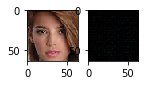

 75%|### |ETA:   0:00:24  Epoch: 3   Iter: 2297   Class Loss: 0.00   Loss: 0.14

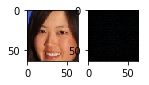

 78%|### |ETA:   0:00:21  Epoch: 3   Iter: 2399   Class Loss: 0.00   Loss: 0.16

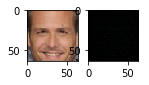

 81%|### |ETA:   0:00:18  Epoch: 3   Iter: 2499   Class Loss: 0.00   Loss: 0.19

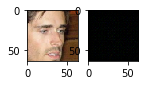

 85%|### |ETA:   0:00:15  Epoch: 3   Iter: 2597   Class Loss: 0.00   Loss: 0.17

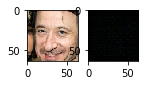

 88%|### |ETA:   0:00:11  Epoch: 3   Iter: 2697   Class Loss: 0.00   Loss: 0.13

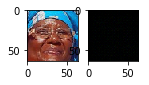

 91%|### |ETA:   0:00:08  Epoch: 3   Iter: 2799   Class Loss: 0.00   Loss: 0.14

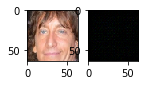

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2898   Class Loss: 0.00   Loss: 0.14

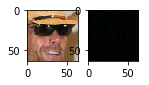

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2999   Class Loss: 0.00   Loss: 0.17

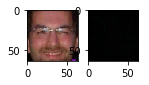

100%|####|Time:  0:01:46  Epoch: 3   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

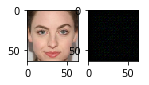

  3%|      |ETA:   0:01:36  Epoch: 4   Iter: 99   Class Loss: 0.00   Loss: 0.17

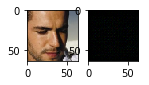

  6%|     |ETA:   0:01:33  Epoch: 4   Iter: 196   Class Loss: 0.00   Loss: 0.14

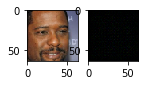

  9%|     |ETA:   0:01:30  Epoch: 4   Iter: 299   Class Loss: 0.00   Loss: 0.14

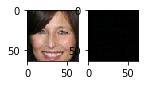

 13%|     |ETA:   0:01:27  Epoch: 4   Iter: 399   Class Loss: 0.00   Loss: 0.13

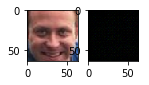

 16%|     |ETA:   0:01:25  Epoch: 4   Iter: 499   Class Loss: 0.00   Loss: 0.15

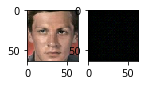

 19%|     |ETA:   0:01:31  Epoch: 4   Iter: 597   Class Loss: 0.00   Loss: 0.18

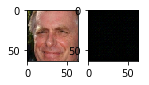

 22%|#    |ETA:   0:01:28  Epoch: 4   Iter: 698   Class Loss: 0.00   Loss: 0.15

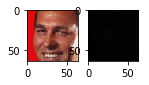

 26%|#    |ETA:   0:01:16  Epoch: 4   Iter: 799   Class Loss: 0.00   Loss: 0.19

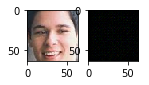

 29%|#    |ETA:   0:01:10  Epoch: 4   Iter: 899   Class Loss: 0.00   Loss: 0.15

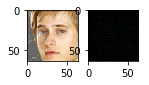

 32%|#    |ETA:   0:01:07  Epoch: 4   Iter: 997   Class Loss: 0.00   Loss: 0.21

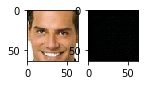

 35%|#   |ETA:   0:01:03  Epoch: 4   Iter: 1098   Class Loss: 0.00   Loss: 0.16

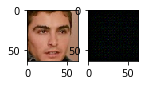

 39%|#   |ETA:   0:01:01  Epoch: 4   Iter: 1197   Class Loss: 0.00   Loss: 0.18

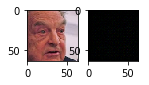

 42%|#   |ETA:   0:00:57  Epoch: 4   Iter: 1297   Class Loss: 0.00   Loss: 0.16

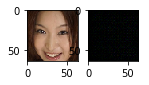

 45%|#   |ETA:   0:00:54  Epoch: 4   Iter: 1399   Class Loss: 0.00   Loss: 0.17

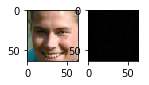

 49%|#   |ETA:   0:00:51  Epoch: 4   Iter: 1499   Class Loss: 0.00   Loss: 0.15

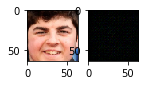

 52%|##  |ETA:   0:00:47  Epoch: 4   Iter: 1597   Class Loss: 0.00   Loss: 0.16

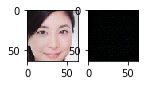

 55%|##  |ETA:   0:00:44  Epoch: 4   Iter: 1697   Class Loss: 0.00   Loss: 0.16

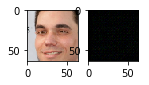

 58%|##  |ETA:   0:00:41  Epoch: 4   Iter: 1798   Class Loss: 0.00   Loss: 0.15

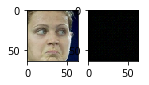

 62%|##  |ETA:   0:00:42  Epoch: 4   Iter: 1897   Class Loss: 0.00   Loss: 0.14

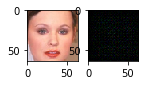

 65%|##  |ETA:   0:00:34  Epoch: 4   Iter: 1997   Class Loss: 0.00   Loss: 0.16

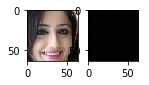

 68%|##  |ETA:   0:00:31  Epoch: 4   Iter: 2096   Class Loss: 0.00   Loss: 0.16

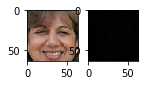

 72%|##  |ETA:   0:00:28  Epoch: 4   Iter: 2198   Class Loss: 0.00   Loss: 0.17

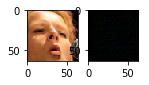

 75%|### |ETA:   0:00:24  Epoch: 4   Iter: 2299   Class Loss: 0.00   Loss: 0.17

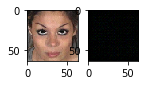

 78%|### |ETA:   0:00:21  Epoch: 4   Iter: 2399   Class Loss: 0.00   Loss: 0.18

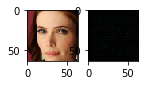

 81%|### |ETA:   0:00:18  Epoch: 4   Iter: 2499   Class Loss: 0.00   Loss: 0.20

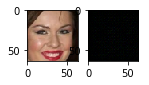

 85%|### |ETA:   0:00:15  Epoch: 4   Iter: 2596   Class Loss: 0.00   Loss: 0.17

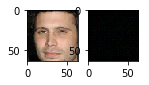

 88%|### |ETA:   0:00:11  Epoch: 4   Iter: 2697   Class Loss: 0.00   Loss: 0.13

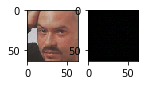

 91%|### |ETA:   0:00:08  Epoch: 4   Iter: 2796   Class Loss: 0.00   Loss: 0.18

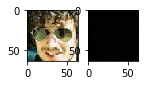

 94%|### |ETA:   0:00:05  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.17

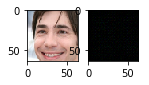

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2999   Class Loss: 0.00   Loss: 0.17

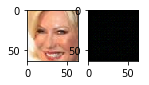

100%|####|Time:  0:01:47  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

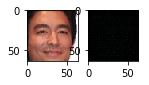

  3%|      |ETA:   0:01:36  Epoch: 5   Iter: 99   Class Loss: 0.00   Loss: 0.15

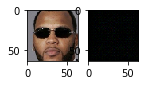

  6%|     |ETA:   0:01:33  Epoch: 5   Iter: 197   Class Loss: 0.00   Loss: 0.17

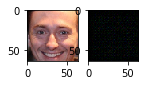

  9%|     |ETA:   0:01:30  Epoch: 5   Iter: 296   Class Loss: 0.00   Loss: 0.15

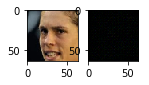

 13%|     |ETA:   0:01:27  Epoch: 5   Iter: 396   Class Loss: 0.00   Loss: 0.17

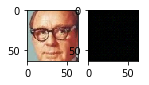

 16%|     |ETA:   0:01:23  Epoch: 5   Iter: 498   Class Loss: 0.00   Loss: 0.15

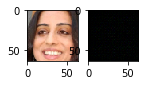

 19%|     |ETA:   0:01:20  Epoch: 5   Iter: 599   Class Loss: 0.00   Loss: 0.17

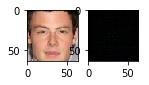

 22%|#    |ETA:   0:01:17  Epoch: 5   Iter: 699   Class Loss: 0.00   Loss: 0.15

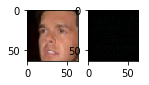

 26%|#    |ETA:   0:01:14  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.15

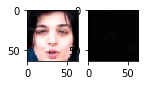

 29%|#    |ETA:   0:01:11  Epoch: 5   Iter: 896   Class Loss: 0.00   Loss: 0.16

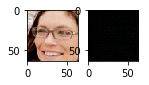

 32%|#    |ETA:   0:01:07  Epoch: 5   Iter: 997   Class Loss: 0.00   Loss: 0.17

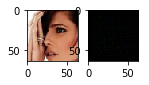

 35%|#   |ETA:   0:01:04  Epoch: 5   Iter: 1097   Class Loss: 0.00   Loss: 0.16

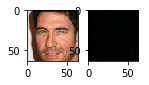

 39%|#   |ETA:   0:01:00  Epoch: 5   Iter: 1198   Class Loss: 0.00   Loss: 0.18

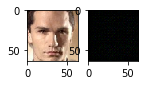

 42%|#   |ETA:   0:00:58  Epoch: 5   Iter: 1297   Class Loss: 0.00   Loss: 0.17

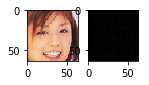

 45%|#   |ETA:   0:00:54  Epoch: 5   Iter: 1399   Class Loss: 0.00   Loss: 0.19

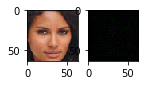

 49%|#   |ETA:   0:00:50  Epoch: 5   Iter: 1496   Class Loss: 0.00   Loss: 0.17

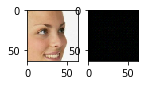

 52%|##  |ETA:   0:00:47  Epoch: 5   Iter: 1599   Class Loss: 0.00   Loss: 0.16

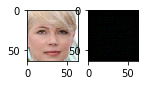

 55%|##  |ETA:   0:00:50  Epoch: 5   Iter: 1696   Class Loss: 0.00   Loss: 0.13

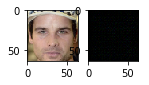

 58%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1799   Class Loss: 0.00   Loss: 0.15

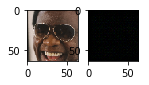

 62%|##  |ETA:   0:00:37  Epoch: 5   Iter: 1897   Class Loss: 0.00   Loss: 0.17

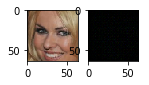

 65%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1997   Class Loss: 0.00   Loss: 0.17

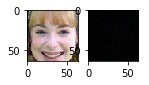

 68%|##  |ETA:   0:00:38  Epoch: 5   Iter: 2098   Class Loss: 0.00   Loss: 0.18

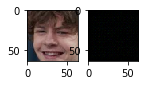

 72%|##  |ETA:   0:00:33  Epoch: 5   Iter: 2199   Class Loss: 0.00   Loss: 0.13

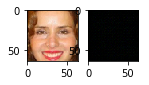

 75%|### |ETA:   0:00:24  Epoch: 5   Iter: 2299   Class Loss: 0.00   Loss: 0.15

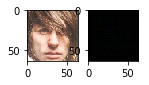

 78%|### |ETA:   0:00:21  Epoch: 5   Iter: 2399   Class Loss: 0.00   Loss: 0.16

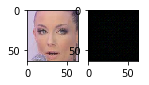

 81%|### |ETA:   0:00:18  Epoch: 5   Iter: 2498   Class Loss: 0.00   Loss: 0.15

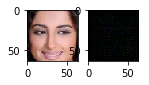

 85%|### |ETA:   0:00:14  Epoch: 5   Iter: 2597   Class Loss: 0.00   Loss: 0.17

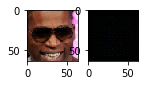

 88%|### |ETA:   0:00:11  Epoch: 5   Iter: 2699   Class Loss: 0.00   Loss: 0.15

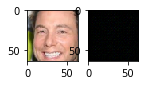

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2796   Class Loss: 0.00   Loss: 0.17

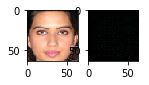

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2898   Class Loss: 0.00   Loss: 0.15

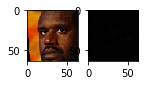

 98%|### |ETA:   0:00:01  Epoch: 5   Iter: 2997   Class Loss: 0.00   Loss: 0.18

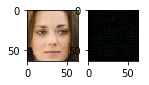

100%|####|Time:  0:01:46  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.16


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

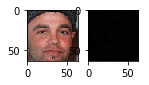

  3%|      |ETA:   0:01:37  Epoch: 6   Iter: 98   Class Loss: 0.00   Loss: 0.17

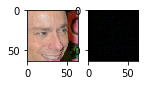

  6%|     |ETA:   0:01:34  Epoch: 6   Iter: 197   Class Loss: 0.00   Loss: 0.18

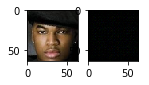

  9%|     |ETA:   0:01:30  Epoch: 6   Iter: 298   Class Loss: 0.00   Loss: 0.14

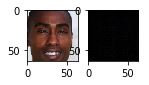

 13%|     |ETA:   0:01:28  Epoch: 6   Iter: 398   Class Loss: 0.00   Loss: 0.14

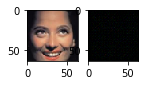

 16%|     |ETA:   0:01:24  Epoch: 6   Iter: 497   Class Loss: 0.00   Loss: 0.17

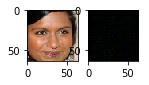

 19%|     |ETA:   0:01:21  Epoch: 6   Iter: 597   Class Loss: 0.00   Loss: 0.16

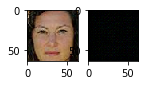

 22%|#    |ETA:   0:01:17  Epoch: 6   Iter: 699   Class Loss: 0.00   Loss: 0.15

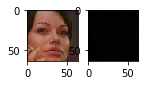

 26%|#    |ETA:   0:01:14  Epoch: 6   Iter: 799   Class Loss: 0.00   Loss: 0.14

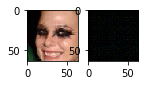

 29%|#    |ETA:   0:01:10  Epoch: 6   Iter: 899   Class Loss: 0.00   Loss: 0.16

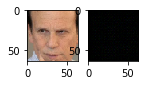

 32%|#    |ETA:   0:01:07  Epoch: 6   Iter: 997   Class Loss: 0.00   Loss: 0.16

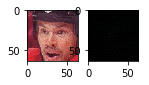

 35%|#   |ETA:   0:01:03  Epoch: 6   Iter: 1097   Class Loss: 0.00   Loss: 0.15

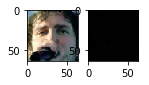

 39%|#   |ETA:   0:01:07  Epoch: 6   Iter: 1198   Class Loss: 0.00   Loss: 0.16

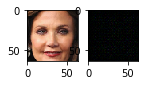

 42%|#   |ETA:   0:01:05  Epoch: 6   Iter: 1299   Class Loss: 0.00   Loss: 0.17

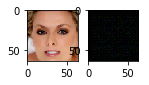

 45%|#   |ETA:   0:01:02  Epoch: 6   Iter: 1397   Class Loss: 0.00   Loss: 0.18

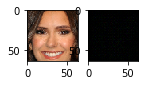

 49%|#   |ETA:   0:00:57  Epoch: 6   Iter: 1499   Class Loss: 0.00   Loss: 0.17

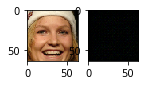

 52%|##  |ETA:   0:00:48  Epoch: 6   Iter: 1596   Class Loss: 0.00   Loss: 0.15

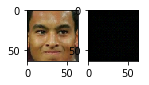

 55%|##  |ETA:   0:00:44  Epoch: 6   Iter: 1699   Class Loss: 0.00   Loss: 0.16

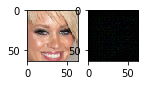

 58%|##  |ETA:   0:00:41  Epoch: 6   Iter: 1799   Class Loss: 0.00   Loss: 0.19

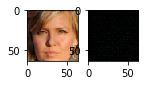

 62%|##  |ETA:   0:00:38  Epoch: 6   Iter: 1897   Class Loss: 0.00   Loss: 0.15

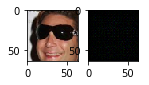

 65%|##  |ETA:   0:00:34  Epoch: 6   Iter: 1997   Class Loss: 0.00   Loss: 0.17

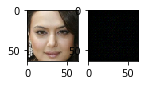

 68%|##  |ETA:   0:00:31  Epoch: 6   Iter: 2098   Class Loss: 0.00   Loss: 0.16

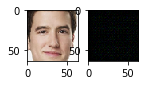

 72%|##  |ETA:   0:00:28  Epoch: 6   Iter: 2199   Class Loss: 0.00   Loss: 0.15

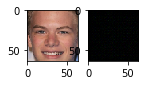

 75%|### |ETA:   0:00:24  Epoch: 6   Iter: 2299   Class Loss: 0.00   Loss: 0.16

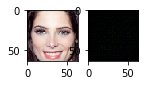

 78%|### |ETA:   0:00:21  Epoch: 6   Iter: 2399   Class Loss: 0.00   Loss: 0.16

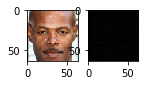

 81%|### |ETA:   0:00:18  Epoch: 6   Iter: 2496   Class Loss: 0.00   Loss: 0.18

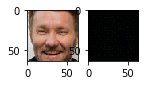

 85%|### |ETA:   0:00:14  Epoch: 6   Iter: 2597   Class Loss: 0.00   Loss: 0.15

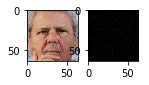

 88%|### |ETA:   0:00:11  Epoch: 6   Iter: 2697   Class Loss: 0.00   Loss: 0.15

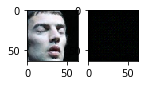

 91%|### |ETA:   0:00:08  Epoch: 6   Iter: 2797   Class Loss: 0.00   Loss: 0.16

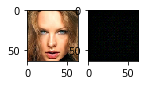

 94%|### |ETA:   0:00:05  Epoch: 6   Iter: 2897   Class Loss: 0.00   Loss: 0.15

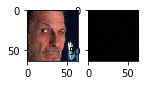

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2998   Class Loss: 0.00   Loss: 0.16

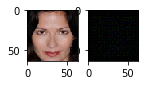

100%|####|Time:  0:01:46  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

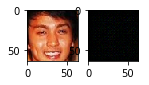

  3%|      |ETA:   0:01:36  Epoch: 7   Iter: 99   Class Loss: 0.00   Loss: 0.14

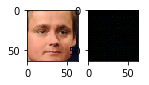

  6%|     |ETA:   0:01:33  Epoch: 7   Iter: 196   Class Loss: 0.00   Loss: 0.17

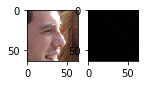

  9%|     |ETA:   0:01:30  Epoch: 7   Iter: 297   Class Loss: 0.00   Loss: 0.19

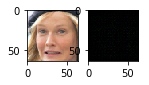

 13%|     |ETA:   0:01:39  Epoch: 7   Iter: 398   Class Loss: 0.00   Loss: 0.18

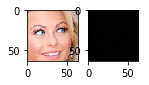

 16%|     |ETA:   0:01:37  Epoch: 7   Iter: 499   Class Loss: 0.00   Loss: 0.15

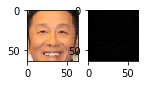

 19%|     |ETA:   0:01:30  Epoch: 7   Iter: 597   Class Loss: 0.00   Loss: 0.12

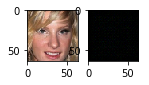

 22%|#    |ETA:   0:01:17  Epoch: 7   Iter: 698   Class Loss: 0.00   Loss: 0.19

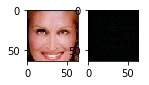

 26%|#    |ETA:   0:01:13  Epoch: 7   Iter: 796   Class Loss: 0.00   Loss: 0.15

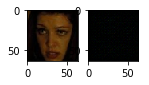

 29%|#    |ETA:   0:01:10  Epoch: 7   Iter: 899   Class Loss: 0.00   Loss: 0.18

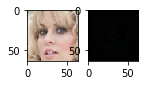

 32%|#    |ETA:   0:01:07  Epoch: 7   Iter: 997   Class Loss: 0.00   Loss: 0.15

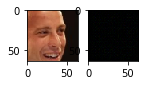

 35%|#   |ETA:   0:01:04  Epoch: 7   Iter: 1098   Class Loss: 0.00   Loss: 0.16

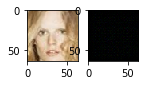

 39%|#   |ETA:   0:01:02  Epoch: 7   Iter: 1198   Class Loss: 0.00   Loss: 0.16

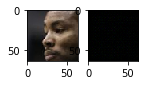

 42%|#   |ETA:   0:01:04  Epoch: 7   Iter: 1298   Class Loss: 0.00   Loss: 0.15

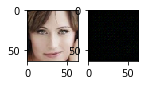

 45%|#   |ETA:   0:00:54  Epoch: 7   Iter: 1398   Class Loss: 0.00   Loss: 0.15

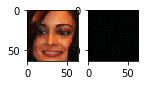

 49%|#   |ETA:   0:00:50  Epoch: 7   Iter: 1499   Class Loss: 0.00   Loss: 0.18

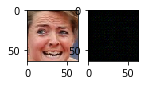

 52%|##  |ETA:   0:00:47  Epoch: 7   Iter: 1599   Class Loss: 0.00   Loss: 0.16

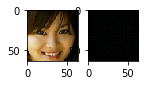

 55%|##  |ETA:   0:00:44  Epoch: 7   Iter: 1699   Class Loss: 0.00   Loss: 0.16

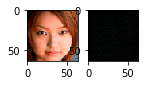

 58%|##  |ETA:   0:00:41  Epoch: 7   Iter: 1796   Class Loss: 0.00   Loss: 0.16

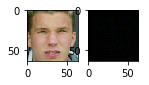

 62%|##  |ETA:   0:00:38  Epoch: 7   Iter: 1896   Class Loss: 0.00   Loss: 0.18

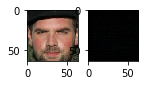

 65%|##  |ETA:   0:00:34  Epoch: 7   Iter: 1999   Class Loss: 0.00   Loss: 0.17

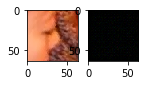

 68%|##  |ETA:   0:00:31  Epoch: 7   Iter: 2096   Class Loss: 0.00   Loss: 0.16

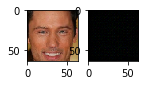

 72%|##  |ETA:   0:00:28  Epoch: 7   Iter: 2198   Class Loss: 0.00   Loss: 0.15

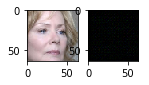

 75%|### |ETA:   0:00:24  Epoch: 7   Iter: 2299   Class Loss: 0.00   Loss: 0.14

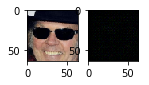

 78%|### |ETA:   0:00:21  Epoch: 7   Iter: 2396   Class Loss: 0.00   Loss: 0.17

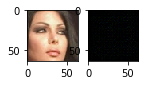

 81%|### |ETA:   0:00:18  Epoch: 7   Iter: 2496   Class Loss: 0.00   Loss: 0.15

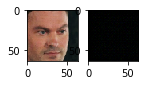

 85%|### |ETA:   0:00:14  Epoch: 7   Iter: 2596   Class Loss: 0.00   Loss: 0.17

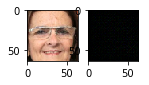

 88%|### |ETA:   0:00:13  Epoch: 7   Iter: 2699   Class Loss: 0.00   Loss: 0.18

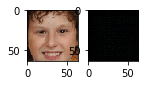

 91%|### |ETA:   0:00:09  Epoch: 7   Iter: 2797   Class Loss: 0.04   Loss: 0.20

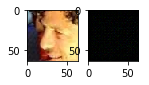

 94%|### |ETA:   0:00:05  Epoch: 7   Iter: 2898   Class Loss: 0.00   Loss: 0.17

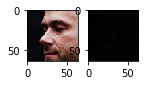

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2996   Class Loss: 0.00   Loss: 0.18

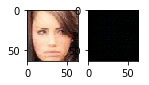

100%|####|Time:  0:01:47  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.19


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

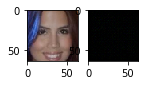

  3%|      |ETA:   0:01:37  Epoch: 8   Iter: 97   Class Loss: 0.00   Loss: 0.16

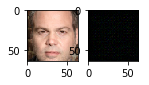

  6%|     |ETA:   0:01:34  Epoch: 8   Iter: 196   Class Loss: 0.00   Loss: 0.17

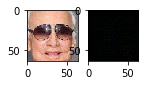

  9%|     |ETA:   0:01:30  Epoch: 8   Iter: 296   Class Loss: 0.00   Loss: 0.16

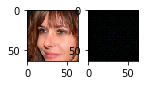

 13%|     |ETA:   0:01:26  Epoch: 8   Iter: 397   Class Loss: 0.00   Loss: 0.16

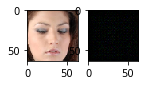

 16%|     |ETA:   0:01:24  Epoch: 8   Iter: 499   Class Loss: 0.00   Loss: 0.15

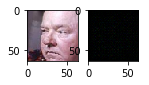

 19%|     |ETA:   0:01:21  Epoch: 8   Iter: 597   Class Loss: 0.00   Loss: 0.16

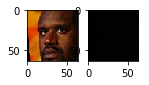

 22%|#    |ETA:   0:01:17  Epoch: 8   Iter: 699   Class Loss: 0.00   Loss: 0.18

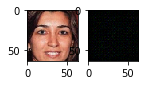

 26%|#    |ETA:   0:01:13  Epoch: 8   Iter: 799   Class Loss: 0.00   Loss: 0.16

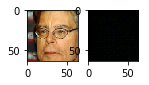

 29%|#    |ETA:   0:01:10  Epoch: 8   Iter: 896   Class Loss: 0.00   Loss: 0.16

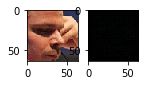

 32%|#    |ETA:   0:01:07  Epoch: 8   Iter: 998   Class Loss: 0.00   Loss: 0.17

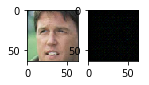

 35%|#   |ETA:   0:01:11  Epoch: 8   Iter: 1097   Class Loss: 0.00   Loss: 0.15

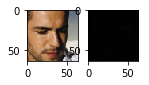

 39%|#   |ETA:   0:01:00  Epoch: 8   Iter: 1198   Class Loss: 0.00   Loss: 0.16

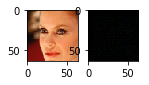

 42%|#   |ETA:   0:00:57  Epoch: 8   Iter: 1297   Class Loss: 0.00   Loss: 0.15

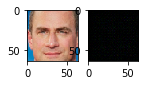

 45%|#   |ETA:   0:00:54  Epoch: 8   Iter: 1398   Class Loss: 0.00   Loss: 0.17

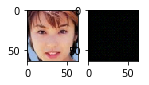

 49%|#   |ETA:   0:01:02  Epoch: 8   Iter: 1497   Class Loss: 0.00   Loss: 0.15

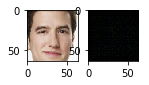

 52%|##  |ETA:   0:00:57  Epoch: 8   Iter: 1599   Class Loss: 0.00   Loss: 0.16

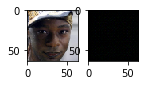

 55%|##  |ETA:   0:00:53  Epoch: 8   Iter: 1697   Class Loss: 0.00   Loss: 0.17

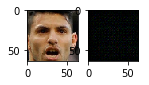

 58%|##  |ETA:   0:00:43  Epoch: 8   Iter: 1798   Class Loss: 0.00   Loss: 0.15

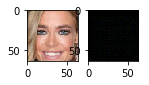

 62%|##  |ETA:   0:00:43  Epoch: 8   Iter: 1899   Class Loss: 0.00   Loss: 0.17

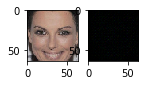

 65%|##  |ETA:   0:00:39  Epoch: 8   Iter: 1997   Class Loss: 0.00   Loss: 0.17

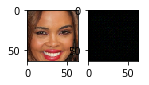

 68%|##  |ETA:   0:00:31  Epoch: 8   Iter: 2098   Class Loss: 0.00   Loss: 0.18

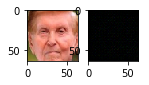

 72%|##  |ETA:   0:00:28  Epoch: 8   Iter: 2199   Class Loss: 0.00   Loss: 0.18

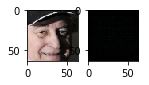

 75%|### |ETA:   0:00:24  Epoch: 8   Iter: 2297   Class Loss: 0.00   Loss: 0.14

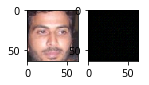

 78%|### |ETA:   0:00:21  Epoch: 8   Iter: 2399   Class Loss: 0.00   Loss: 0.17

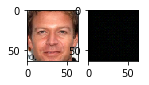

 81%|### |ETA:   0:00:18  Epoch: 8   Iter: 2497   Class Loss: 0.00   Loss: 0.15

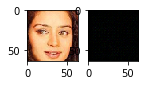

 85%|### |ETA:   0:00:14  Epoch: 8   Iter: 2599   Class Loss: 0.00   Loss: 0.18

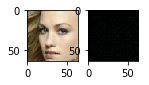

 88%|### |ETA:   0:00:11  Epoch: 8   Iter: 2696   Class Loss: 0.00   Loss: 0.17

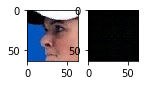

 91%|### |ETA:   0:00:08  Epoch: 8   Iter: 2797   Class Loss: 0.00   Loss: 0.16

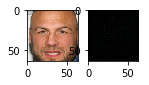

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2897   Class Loss: 0.00   Loss: 0.18

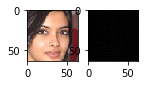

 98%|### |ETA:   0:00:01  Epoch: 8   Iter: 2998   Class Loss: 0.00   Loss: 0.14

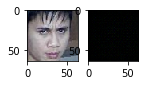

100%|####|Time:  0:01:47  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.15


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

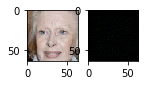

  3%|      |ETA:   0:01:36  Epoch: 9   Iter: 97   Class Loss: 0.00   Loss: 0.19

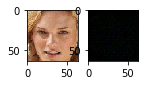

  6%|     |ETA:   0:01:33  Epoch: 9   Iter: 196   Class Loss: 0.00   Loss: 0.16

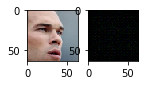

  9%|     |ETA:   0:01:29  Epoch: 9   Iter: 297   Class Loss: 0.00   Loss: 0.17

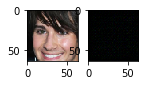

 13%|     |ETA:   0:01:26  Epoch: 9   Iter: 397   Class Loss: 0.00   Loss: 0.16

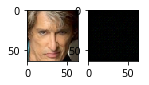

 16%|     |ETA:   0:01:22  Epoch: 9   Iter: 498   Class Loss: 0.00   Loss: 0.16

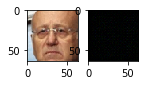

 19%|     |ETA:   0:01:19  Epoch: 9   Iter: 598   Class Loss: 0.00   Loss: 0.18

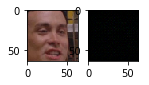

 22%|#    |ETA:   0:01:16  Epoch: 9   Iter: 699   Class Loss: 0.00   Loss: 0.18

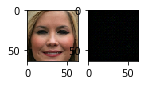

 26%|#    |ETA:   0:01:14  Epoch: 9   Iter: 796   Class Loss: 0.00   Loss: 0.15

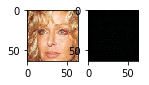

 29%|#    |ETA:   0:01:19  Epoch: 9   Iter: 896   Class Loss: 0.00   Loss: 0.17

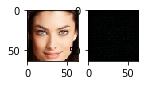

 32%|#    |ETA:   0:01:10  Epoch: 9   Iter: 997   Class Loss: 0.00   Loss: 0.17

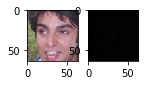

 35%|#   |ETA:   0:01:12  Epoch: 9   Iter: 1097   Class Loss: 0.00   Loss: 0.18

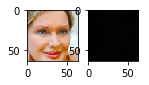

 39%|#   |ETA:   0:01:09  Epoch: 9   Iter: 1198   Class Loss: 0.00   Loss: 0.16

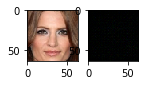

 42%|#   |ETA:   0:00:57  Epoch: 9   Iter: 1299   Class Loss: 0.00   Loss: 0.15

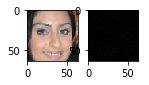

 45%|#   |ETA:   0:00:53  Epoch: 9   Iter: 1398   Class Loss: 0.00   Loss: 0.17

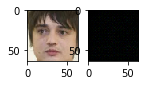

 49%|#   |ETA:   0:00:50  Epoch: 9   Iter: 1499   Class Loss: 0.00   Loss: 0.18

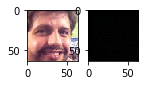

 52%|##  |ETA:   0:00:47  Epoch: 9   Iter: 1596   Class Loss: 0.00   Loss: 0.17

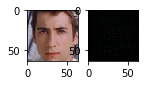

 55%|##  |ETA:   0:00:43  Epoch: 9   Iter: 1699   Class Loss: 0.00   Loss: 0.15

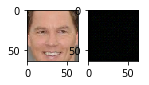

 58%|##  |ETA:   0:00:40  Epoch: 9   Iter: 1796   Class Loss: 0.00   Loss: 0.17

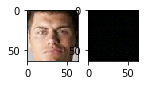

 62%|##  |ETA:   0:00:37  Epoch: 9   Iter: 1896   Class Loss: 0.00   Loss: 0.18

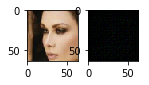

 65%|##  |ETA:   0:00:34  Epoch: 9   Iter: 1997   Class Loss: 0.00   Loss: 0.18

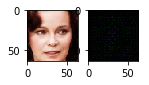

 68%|##  |ETA:   0:00:31  Epoch: 9   Iter: 2097   Class Loss: 0.00   Loss: 0.17

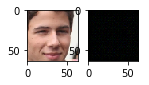

 72%|##  |ETA:   0:00:27  Epoch: 9   Iter: 2199   Class Loss: 0.00   Loss: 0.20

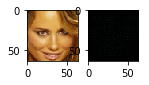

 75%|### |ETA:   0:00:24  Epoch: 9   Iter: 2296   Class Loss: 0.00   Loss: 0.16

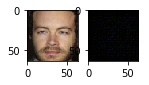

 78%|### |ETA:   0:00:21  Epoch: 9   Iter: 2396   Class Loss: 0.00   Loss: 0.19

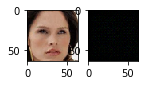

 81%|### |ETA:   0:00:18  Epoch: 9   Iter: 2499   Class Loss: 0.00   Loss: 0.19

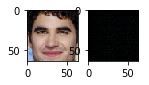

 85%|### |ETA:   0:00:14  Epoch: 9   Iter: 2598   Class Loss: 0.00   Loss: 0.20

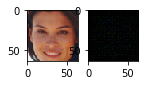

 88%|### |ETA:   0:00:11  Epoch: 9   Iter: 2696   Class Loss: 0.21   Loss: 0.36

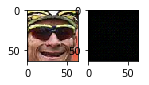

 91%|### |ETA:   0:00:08  Epoch: 9   Iter: 2796   Class Loss: 0.00   Loss: 0.18

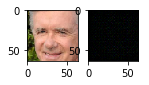

 94%|### |ETA:   0:00:04  Epoch: 9   Iter: 2898   Class Loss: 0.00   Loss: 0.17

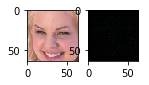

 98%|### |ETA:   0:00:01  Epoch: 9   Iter: 2998   Class Loss: 0.00   Loss: 0.19

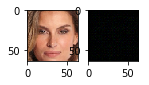

100%|####|Time:  0:01:45  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.19
100% (97 of 97) |########################| Elapsed Time: 0:01:09 Time:  0:01:09
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 0.752577319588


100% (72 of 72) |########################| Elapsed Time: 0:00:50 Time:  0:00:50
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.763888888889


100% (78 of 78) |########################| Elapsed Time: 0:00:53 Time:  0:00:53
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.794871794872


100% (71 of 71) |########################| Elapsed Time: 0:00:47 Time:  0:00:47



female darker: 0.830985915493


Text(0,0.5,'Accuracy')

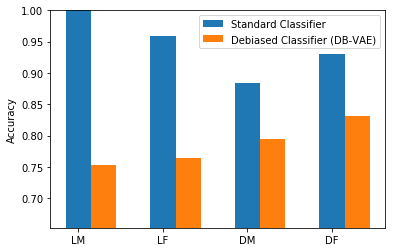

In [42]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.75)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

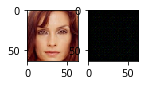

  3%|      |ETA:   0:01:35  Epoch: 0   Iter: 97   Class Loss: 0.00   Loss: 0.23

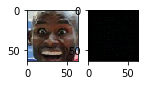

  6%|     |ETA:   0:01:33  Epoch: 0   Iter: 196   Class Loss: 0.00   Loss: 0.21

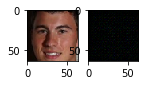

  9%|     |ETA:   0:01:30  Epoch: 0   Iter: 297   Class Loss: 0.00   Loss: 0.18

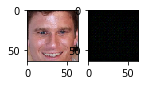

 13%|     |ETA:   0:01:26  Epoch: 0   Iter: 398   Class Loss: 0.00   Loss: 0.17

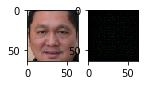

 16%|     |ETA:   0:01:23  Epoch: 0   Iter: 498   Class Loss: 0.00   Loss: 0.18

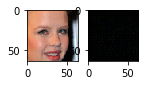

 19%|     |ETA:   0:01:31  Epoch: 0   Iter: 599   Class Loss: 0.00   Loss: 0.29

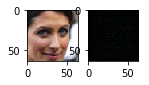

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 697   Class Loss: 0.00   Loss: 0.21

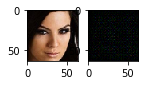

 26%|#    |ETA:   0:01:21  Epoch: 0   Iter: 799   Class Loss: 0.00   Loss: 0.24

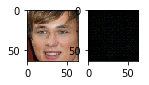

 29%|#    |ETA:   0:01:22  Epoch: 0   Iter: 897   Class Loss: 0.00   Loss: 0.24

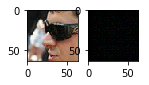

 32%|#    |ETA:   0:01:16  Epoch: 0   Iter: 999   Class Loss: 0.00   Loss: 0.23

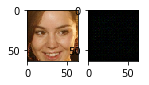

 35%|#   |ETA:   0:01:04  Epoch: 0   Iter: 1097   Class Loss: 0.00   Loss: 0.22

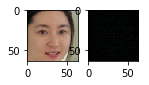

 39%|#   |ETA:   0:01:05  Epoch: 0   Iter: 1197   Class Loss: 0.00   Loss: 0.16

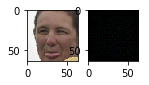

 42%|#   |ETA:   0:00:57  Epoch: 0   Iter: 1297   Class Loss: 0.00   Loss: 0.16

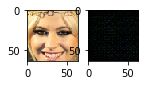

 45%|#   |ETA:   0:00:54  Epoch: 0   Iter: 1399   Class Loss: 0.00   Loss: 0.19

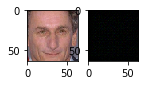

 49%|#   |ETA:   0:00:50  Epoch: 0   Iter: 1499   Class Loss: 0.00   Loss: 0.17

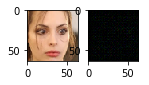

 52%|##  |ETA:   0:00:47  Epoch: 0   Iter: 1598   Class Loss: 0.00   Loss: 0.21

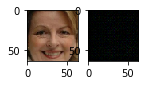

 55%|##  |ETA:   0:00:45  Epoch: 0   Iter: 1699   Class Loss: 0.00   Loss: 0.23

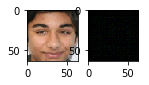

 58%|##  |ETA:   0:00:42  Epoch: 0   Iter: 1798   Class Loss: 0.00   Loss: 0.21

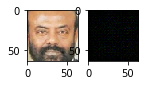

 62%|##  |ETA:   0:00:38  Epoch: 0   Iter: 1897   Class Loss: 0.00   Loss: 0.20

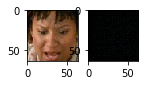

 65%|##  |ETA:   0:00:35  Epoch: 0   Iter: 1996   Class Loss: 0.00   Loss: 0.20

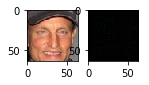

 68%|##  |ETA:   0:00:32  Epoch: 0   Iter: 2097   Class Loss: 0.00   Loss: 0.25

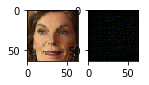

 72%|##  |ETA:   0:00:28  Epoch: 0   Iter: 2198   Class Loss: 0.00   Loss: 0.22

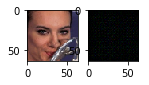

 75%|### |ETA:   0:00:25  Epoch: 0   Iter: 2298   Class Loss: 0.00   Loss: 0.22

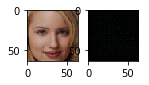

 78%|### |ETA:   0:00:22  Epoch: 0   Iter: 2399   Class Loss: 0.00   Loss: 0.20

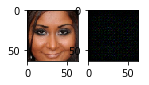

 81%|### |ETA:   0:00:18  Epoch: 0   Iter: 2497   Class Loss: 0.00   Loss: 0.26

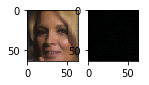

 85%|### |ETA:   0:00:14  Epoch: 0   Iter: 2596   Class Loss: 0.00   Loss: 0.18

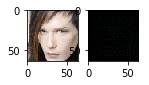

 88%|### |ETA:   0:00:11  Epoch: 0   Iter: 2699   Class Loss: 0.00   Loss: 0.20

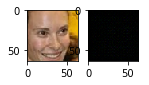

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2797   Class Loss: 0.00   Loss: 0.18

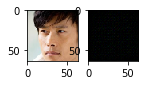

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2897   Class Loss: 0.00   Loss: 0.18

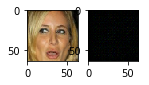

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2999   Class Loss: 0.00   Loss: 0.16

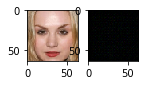

100%|####|Time:  0:01:46  Epoch: 0   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

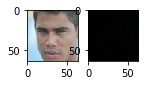

  3%|      |ETA:   0:01:51  Epoch: 1   Iter: 98   Class Loss: 0.00   Loss: 0.16

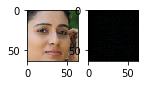

  6%|     |ETA:   0:01:46  Epoch: 1   Iter: 199   Class Loss: 0.00   Loss: 0.14

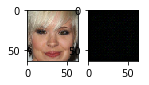

  9%|     |ETA:   0:01:29  Epoch: 1   Iter: 296   Class Loss: 0.00   Loss: 0.18

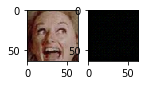

 13%|     |ETA:   0:01:36  Epoch: 1   Iter: 398   Class Loss: 0.00   Loss: 0.18

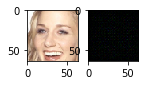

 16%|     |ETA:   0:01:23  Epoch: 1   Iter: 497   Class Loss: 0.14   Loss: 0.34

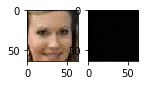

 19%|     |ETA:   0:01:19  Epoch: 1   Iter: 598   Class Loss: 0.00   Loss: 0.21

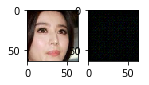

 22%|#    |ETA:   0:01:16  Epoch: 1   Iter: 698   Class Loss: 0.00   Loss: 0.19

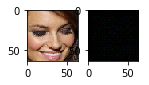

 26%|#    |ETA:   0:01:13  Epoch: 1   Iter: 798   Class Loss: 0.00   Loss: 0.20

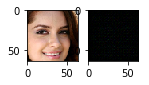

 29%|#    |ETA:   0:01:12  Epoch: 1   Iter: 899   Class Loss: 0.00   Loss: 0.18

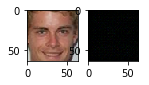

 32%|#    |ETA:   0:01:08  Epoch: 1   Iter: 998   Class Loss: 0.00   Loss: 0.17

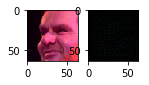

 36%|#   |ETA:   0:01:04  Epoch: 1   Iter: 1099   Class Loss: 0.00   Loss: 0.18

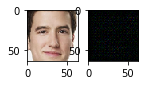

 39%|#   |ETA:   0:01:05  Epoch: 1   Iter: 1198   Class Loss: 0.00   Loss: 0.17

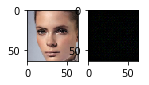

 42%|#   |ETA:   0:01:01  Epoch: 1   Iter: 1299   Class Loss: 0.00   Loss: 0.19

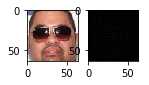

 45%|#   |ETA:   0:00:58  Epoch: 1   Iter: 1397   Class Loss: 0.00   Loss: 0.18

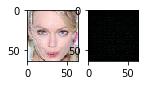

 49%|#   |ETA:   0:00:52  Epoch: 1   Iter: 1498   Class Loss: 0.00   Loss: 0.18

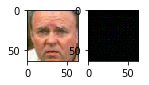

 52%|##  |ETA:   0:00:48  Epoch: 1   Iter: 1596   Class Loss: 0.00   Loss: 0.18

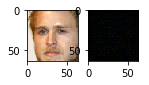

 55%|##  |ETA:   0:00:47  Epoch: 1   Iter: 1697   Class Loss: 0.00   Loss: 0.18

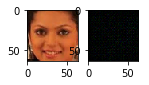

 58%|##  |ETA:   0:00:43  Epoch: 1   Iter: 1797   Class Loss: 0.00   Loss: 0.17

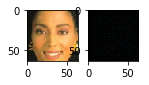

 62%|##  |ETA:   0:00:40  Epoch: 1   Iter: 1896   Class Loss: 0.00   Loss: 0.19

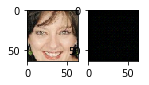

 65%|##  |ETA:   0:00:35  Epoch: 1   Iter: 1998   Class Loss: 0.00   Loss: 0.22

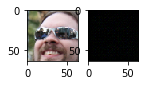

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2098   Class Loss: 0.00   Loss: 0.21

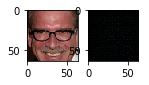

 72%|##  |ETA:   0:00:27  Epoch: 1   Iter: 2198   Class Loss: 0.00   Loss: 0.17

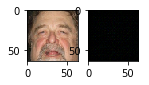

 75%|### |ETA:   0:00:28  Epoch: 1   Iter: 2297   Class Loss: 0.00   Loss: 0.18

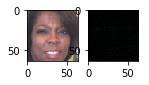

 78%|### |ETA:   0:00:24  Epoch: 1   Iter: 2399   Class Loss: 0.00   Loss: 0.20

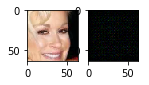

 81%|### |ETA:   0:00:19  Epoch: 1   Iter: 2498   Class Loss: 0.00   Loss: 0.19

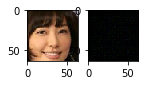

 85%|### |ETA:   0:00:14  Epoch: 1   Iter: 2597   Class Loss: 0.00   Loss: 0.18

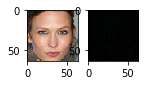

 88%|### |ETA:   0:00:11  Epoch: 1   Iter: 2696   Class Loss: 0.00   Loss: 0.16

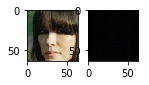

 91%|### |ETA:   0:00:08  Epoch: 1   Iter: 2796   Class Loss: 0.00   Loss: 0.22

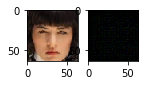

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2897   Class Loss: 0.00   Loss: 0.18

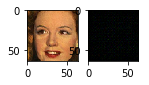

 98%|### |ETA:   0:00:01  Epoch: 1   Iter: 2999   Class Loss: 0.00   Loss: 0.20

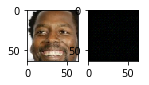

100%|####|Time:  0:01:48  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.20


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

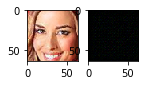

  3%|      |ETA:   0:01:52  Epoch: 2   Iter: 97   Class Loss: 0.00   Loss: 0.21

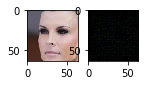

  6%|     |ETA:   0:01:49  Epoch: 2   Iter: 197   Class Loss: 0.00   Loss: 0.20

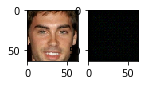

  9%|     |ETA:   0:01:29  Epoch: 2   Iter: 297   Class Loss: 0.00   Loss: 0.17

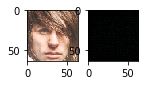

 13%|     |ETA:   0:01:43  Epoch: 2   Iter: 398   Class Loss: 0.00   Loss: 0.20

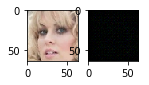

 16%|     |ETA:   0:01:41  Epoch: 2   Iter: 499   Class Loss: 0.00   Loss: 0.20

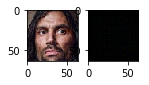

 19%|     |ETA:   0:01:33  Epoch: 2   Iter: 597   Class Loss: 0.00   Loss: 0.18

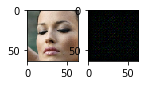

 22%|#    |ETA:   0:01:17  Epoch: 2   Iter: 699   Class Loss: 0.00   Loss: 0.18

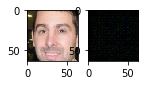

 26%|#    |ETA:   0:01:14  Epoch: 2   Iter: 798   Class Loss: 0.00   Loss: 0.18

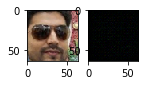

 29%|#    |ETA:   0:01:10  Epoch: 2   Iter: 896   Class Loss: 0.00   Loss: 0.18

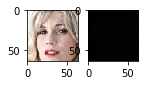

 32%|#    |ETA:   0:01:08  Epoch: 2   Iter: 999   Class Loss: 0.00   Loss: 0.16

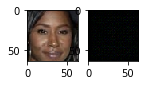

 35%|#   |ETA:   0:01:04  Epoch: 2   Iter: 1098   Class Loss: 0.00   Loss: 0.18

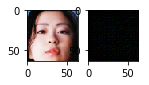

 39%|#   |ETA:   0:01:00  Epoch: 2   Iter: 1198   Class Loss: 0.00   Loss: 0.17

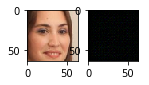

 42%|#   |ETA:   0:00:58  Epoch: 2   Iter: 1296   Class Loss: 0.00   Loss: 0.17

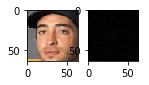

 45%|#   |ETA:   0:01:04  Epoch: 2   Iter: 1399   Class Loss: 0.00   Loss: 0.18

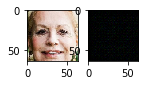

 49%|#   |ETA:   0:00:59  Epoch: 2   Iter: 1498   Class Loss: 0.05   Loss: 0.21

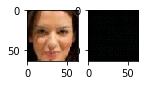

 52%|##  |ETA:   0:00:54  Epoch: 2   Iter: 1599   Class Loss: 0.00   Loss: 0.17

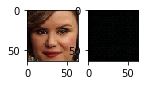

 55%|##  |ETA:   0:00:45  Epoch: 2   Iter: 1696   Class Loss: 0.00   Loss: 0.17

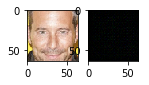

 58%|##  |ETA:   0:00:42  Epoch: 2   Iter: 1799   Class Loss: 0.00   Loss: 0.17

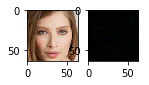

 62%|##  |ETA:   0:00:39  Epoch: 2   Iter: 1897   Class Loss: 0.00   Loss: 0.16

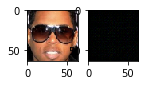

 65%|##  |ETA:   0:00:35  Epoch: 2   Iter: 1996   Class Loss: 0.00   Loss: 0.16

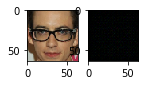

 68%|##  |ETA:   0:00:32  Epoch: 2   Iter: 2098   Class Loss: 0.00   Loss: 0.14

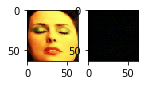

 71%|##  |ETA:   0:00:29  Epoch: 2   Iter: 2196   Class Loss: 0.00   Loss: 0.18

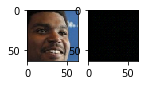

 75%|### |ETA:   0:00:25  Epoch: 2   Iter: 2297   Class Loss: 0.00   Loss: 0.15

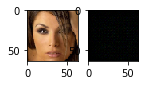

 78%|### |ETA:   0:00:22  Epoch: 2   Iter: 2399   Class Loss: 0.00   Loss: 0.18

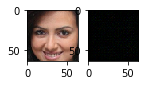

 81%|### |ETA:   0:00:18  Epoch: 2   Iter: 2499   Class Loss: 0.00   Loss: 0.16

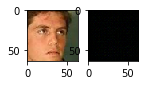

 85%|### |ETA:   0:00:15  Epoch: 2   Iter: 2598   Class Loss: 0.00   Loss: 0.15

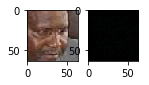

 88%|### |ETA:   0:00:11  Epoch: 2   Iter: 2698   Class Loss: 0.00   Loss: 0.16

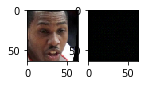

 91%|### |ETA:   0:00:08  Epoch: 2   Iter: 2797   Class Loss: 0.00   Loss: 0.19

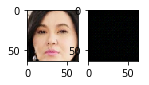

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2897   Class Loss: 0.00   Loss: 0.17

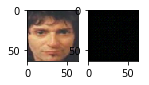

 98%|### |ETA:   0:00:01  Epoch: 2   Iter: 2999   Class Loss: 0.00   Loss: 0.16

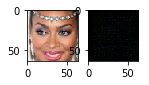

100%|####|Time:  0:01:50  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

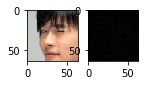

  3%|      |ETA:   0:01:39  Epoch: 3   Iter: 97   Class Loss: 0.00   Loss: 0.16

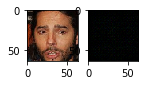

  6%|     |ETA:   0:01:37  Epoch: 3   Iter: 196   Class Loss: 0.00   Loss: 0.18

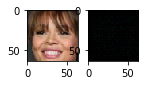

  9%|     |ETA:   0:01:34  Epoch: 3   Iter: 299   Class Loss: 0.00   Loss: 0.18

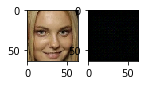

 13%|     |ETA:   0:01:30  Epoch: 3   Iter: 399   Class Loss: 0.00   Loss: 0.17

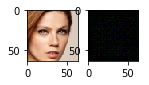

 16%|     |ETA:   0:01:32  Epoch: 3   Iter: 498   Class Loss: 0.00   Loss: 0.16

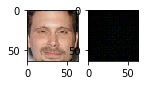

 19%|     |ETA:   0:01:33  Epoch: 3   Iter: 597   Class Loss: 0.00   Loss: 0.19

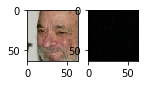

 22%|#    |ETA:   0:01:29  Epoch: 3   Iter: 698   Class Loss: 0.00   Loss: 0.15

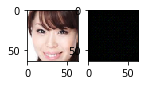

 26%|#    |ETA:   0:01:17  Epoch: 3   Iter: 797   Class Loss: 0.00   Loss: 0.18

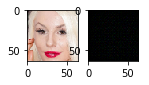

 29%|#    |ETA:   0:01:11  Epoch: 3   Iter: 898   Class Loss: 0.00   Loss: 0.17

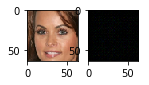

 32%|#    |ETA:   0:01:09  Epoch: 3   Iter: 997   Class Loss: 0.00   Loss: 0.18

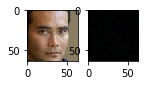

 35%|#   |ETA:   0:01:06  Epoch: 3   Iter: 1098   Class Loss: 0.00   Loss: 0.18

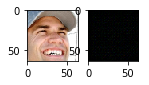

 39%|#   |ETA:   0:01:02  Epoch: 3   Iter: 1197   Class Loss: 0.00   Loss: 0.18

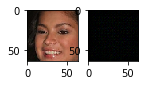

 42%|#   |ETA:   0:00:58  Epoch: 3   Iter: 1298   Class Loss: 0.00   Loss: 0.18

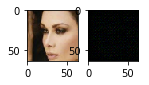

 45%|#   |ETA:   0:00:56  Epoch: 3   Iter: 1398   Class Loss: 0.00   Loss: 0.18

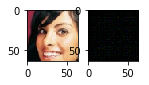

 49%|#   |ETA:   0:00:52  Epoch: 3   Iter: 1498   Class Loss: 0.00   Loss: 0.18

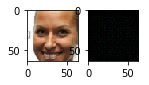

 52%|##  |ETA:   0:00:49  Epoch: 3   Iter: 1596   Class Loss: 0.00   Loss: 0.16

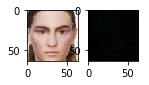

 55%|##  |ETA:   0:00:45  Epoch: 3   Iter: 1697   Class Loss: 0.00   Loss: 0.23

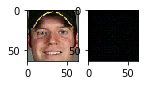

 58%|##  |ETA:   0:00:42  Epoch: 3   Iter: 1799   Class Loss: 0.00   Loss: 0.20

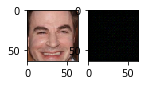

 62%|##  |ETA:   0:00:39  Epoch: 3   Iter: 1899   Class Loss: 0.00   Loss: 0.22

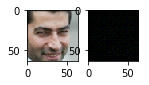

 65%|##  |ETA:   0:00:36  Epoch: 3   Iter: 1998   Class Loss: 0.00   Loss: 0.19

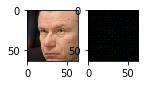

 68%|##  |ETA:   0:00:32  Epoch: 3   Iter: 2099   Class Loss: 0.00   Loss: 0.22

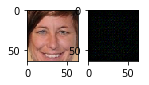

 71%|##  |ETA:   0:00:29  Epoch: 3   Iter: 2197   Class Loss: 0.00   Loss: 0.18

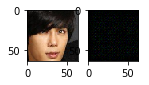

 75%|### |ETA:   0:00:25  Epoch: 3   Iter: 2299   Class Loss: 0.00   Loss: 0.22

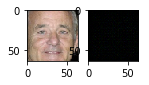

 78%|### |ETA:   0:00:22  Epoch: 3   Iter: 2398   Class Loss: 0.01   Loss: 0.19

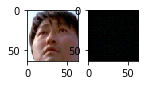

 81%|### |ETA:   0:00:18  Epoch: 3   Iter: 2498   Class Loss: 0.00   Loss: 0.19

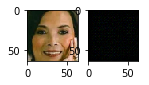

 85%|### |ETA:   0:00:15  Epoch: 3   Iter: 2599   Class Loss: 0.00   Loss: 0.18

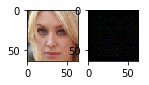

 88%|### |ETA:   0:00:12  Epoch: 3   Iter: 2698   Class Loss: 0.00   Loss: 0.17

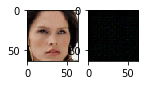

 91%|### |ETA:   0:00:09  Epoch: 3   Iter: 2797   Class Loss: 0.00   Loss: 0.18

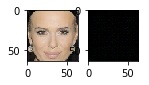

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2897   Class Loss: 0.00   Loss: 0.16

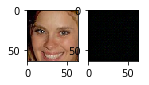

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2997   Class Loss: 0.00   Loss: 0.18

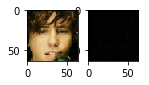

100%|####|Time:  0:01:50  Epoch: 3   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

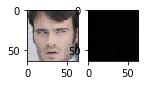

  3%|      |ETA:   0:01:39  Epoch: 4   Iter: 98   Class Loss: 0.00   Loss: 0.16

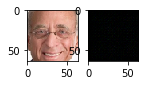

  6%|     |ETA:   0:01:36  Epoch: 4   Iter: 199   Class Loss: 0.00   Loss: 0.18

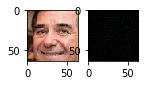

  9%|     |ETA:   0:01:34  Epoch: 4   Iter: 297   Class Loss: 0.00   Loss: 0.17

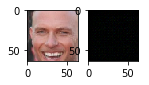

 13%|     |ETA:   0:01:29  Epoch: 4   Iter: 399   Class Loss: 0.00   Loss: 0.18

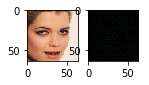

 16%|     |ETA:   0:01:26  Epoch: 4   Iter: 499   Class Loss: 0.00   Loss: 0.20

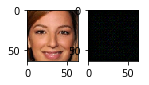

 19%|     |ETA:   0:01:23  Epoch: 4   Iter: 597   Class Loss: 0.00   Loss: 0.18

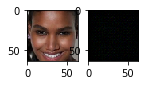

 22%|#    |ETA:   0:01:20  Epoch: 4   Iter: 698   Class Loss: 0.00   Loss: 0.21

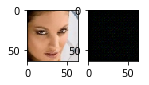

 26%|#    |ETA:   0:01:16  Epoch: 4   Iter: 797   Class Loss: 0.00   Loss: 0.18

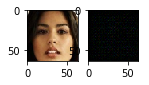

 29%|#    |ETA:   0:01:13  Epoch: 4   Iter: 897   Class Loss: 0.00   Loss: 0.17

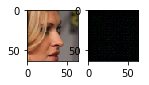

 32%|#    |ETA:   0:01:10  Epoch: 4   Iter: 998   Class Loss: 0.00   Loss: 0.15

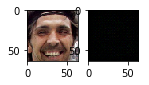

 36%|#   |ETA:   0:01:06  Epoch: 4   Iter: 1099   Class Loss: 0.00   Loss: 0.17

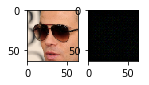

 39%|#   |ETA:   0:01:02  Epoch: 4   Iter: 1197   Class Loss: 0.00   Loss: 0.16

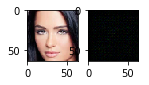

 42%|#   |ETA:   0:00:59  Epoch: 4   Iter: 1297   Class Loss: 0.00   Loss: 0.16

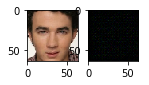

 45%|#   |ETA:   0:00:56  Epoch: 4   Iter: 1397   Class Loss: 0.00   Loss: 0.18

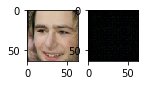

 49%|#   |ETA:   0:00:52  Epoch: 4   Iter: 1499   Class Loss: 0.00   Loss: 0.19

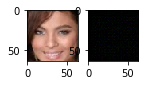

 52%|##  |ETA:   0:01:44  Epoch: 4   Iter: 1599   Class Loss: 0.00   Loss: 0.15

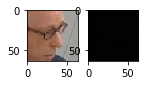

 55%|##  |ETA:   0:00:53  Epoch: 4   Iter: 1696   Class Loss: 0.00   Loss: 0.16

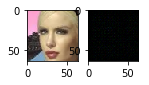

 58%|##  |ETA:   0:00:43  Epoch: 4   Iter: 1798   Class Loss: 0.00   Loss: 0.18

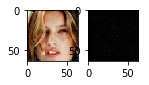

 62%|##  |ETA:   0:00:44  Epoch: 4   Iter: 1899   Class Loss: 0.00   Loss: 0.18

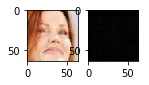

 65%|##  |ETA:   0:00:40  Epoch: 4   Iter: 1997   Class Loss: 0.00   Loss: 0.17

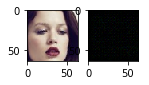

 68%|##  |ETA:   0:00:32  Epoch: 4   Iter: 2098   Class Loss: 0.00   Loss: 0.16

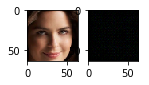

 71%|##  |ETA:   0:00:29  Epoch: 4   Iter: 2197   Class Loss: 0.00   Loss: 0.19

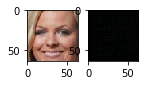

 75%|### |ETA:   0:00:29  Epoch: 4   Iter: 2298   Class Loss: 0.00   Loss: 0.17

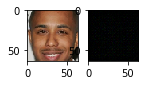

 78%|### |ETA:   0:00:22  Epoch: 4   Iter: 2396   Class Loss: 0.00   Loss: 0.18

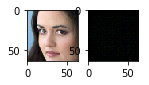

 81%|### |ETA:   0:00:18  Epoch: 4   Iter: 2498   Class Loss: 0.00   Loss: 0.18

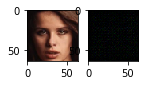

 85%|### |ETA:   0:00:15  Epoch: 4   Iter: 2598   Class Loss: 0.00   Loss: 0.18

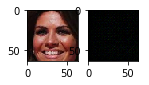

 88%|### |ETA:   0:00:14  Epoch: 4   Iter: 2698   Class Loss: 0.00   Loss: 0.19

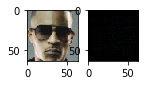

 91%|### |ETA:   0:00:10  Epoch: 4   Iter: 2797   Class Loss: 0.00   Loss: 0.19

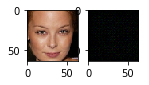

 94%|### |ETA:   0:00:06  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.19

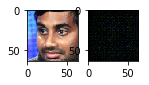

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2996   Class Loss: 0.00   Loss: 0.18

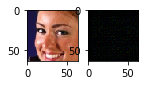

100%|####|Time:  0:01:53  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.17


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

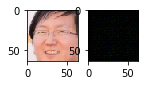

  3%|      |ETA:   0:01:41  Epoch: 5   Iter: 98   Class Loss: 0.00   Loss: 0.18

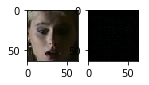

  6%|     |ETA:   0:01:38  Epoch: 5   Iter: 198   Class Loss: 0.00   Loss: 0.20

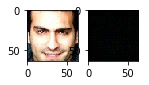

  9%|     |ETA:   0:01:35  Epoch: 5   Iter: 297   Class Loss: 0.00   Loss: 0.17

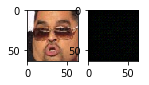

 13%|     |ETA:   0:01:30  Epoch: 5   Iter: 398   Class Loss: 0.00   Loss: 0.18

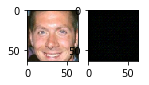

 16%|     |ETA:   0:01:28  Epoch: 5   Iter: 499   Class Loss: 0.00   Loss: 0.20

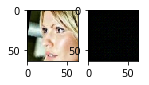

 19%|     |ETA:   0:01:25  Epoch: 5   Iter: 597   Class Loss: 0.00   Loss: 0.21

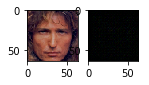

 22%|#    |ETA:   0:01:21  Epoch: 5   Iter: 698   Class Loss: 0.00   Loss: 0.18

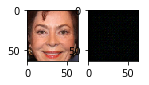

 26%|#    |ETA:   0:01:17  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.12

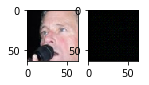

 29%|#    |ETA:   0:01:23  Epoch: 5   Iter: 897   Class Loss: 0.00   Loss: 0.20

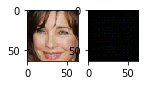

 32%|#    |ETA:   0:01:19  Epoch: 5   Iter: 999   Class Loss: 0.00   Loss: 0.17

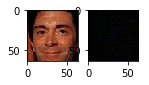

 36%|#   |ETA:   0:01:09  Epoch: 5   Iter: 1099   Class Loss: 0.00   Loss: 0.17

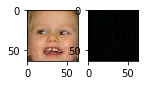

 39%|#   |ETA:   0:01:03  Epoch: 5   Iter: 1197   Class Loss: 0.00   Loss: 0.18

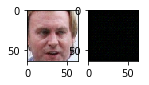

 42%|#   |ETA:   0:01:00  Epoch: 5   Iter: 1297   Class Loss: 0.00   Loss: 0.15

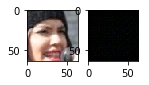

 45%|#   |ETA:   0:00:57  Epoch: 5   Iter: 1399   Class Loss: 0.00   Loss: 0.20

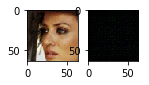

 49%|#   |ETA:   0:00:53  Epoch: 5   Iter: 1499   Class Loss: 0.00   Loss: 0.18

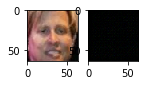

 52%|##  |ETA:   0:00:49  Epoch: 5   Iter: 1599   Class Loss: 0.00   Loss: 0.15

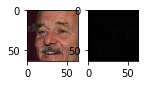

 55%|##  |ETA:   0:00:46  Epoch: 5   Iter: 1697   Class Loss: 0.00   Loss: 0.19

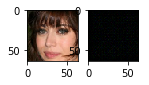

 58%|##  |ETA:   0:00:42  Epoch: 5   Iter: 1797   Class Loss: 0.00   Loss: 0.15

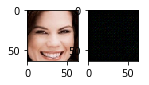

 62%|##  |ETA:   0:00:39  Epoch: 5   Iter: 1899   Class Loss: 0.00   Loss: 0.18

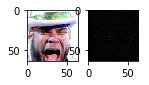

 65%|##  |ETA:   0:00:36  Epoch: 5   Iter: 1998   Class Loss: 0.00   Loss: 0.20

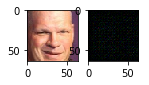

 68%|##  |ETA:   0:00:32  Epoch: 5   Iter: 2098   Class Loss: 0.00   Loss: 0.18

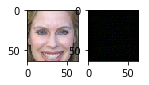

 71%|##  |ETA:   0:00:29  Epoch: 5   Iter: 2197   Class Loss: 0.00   Loss: 0.15

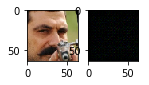

 75%|### |ETA:   0:00:26  Epoch: 5   Iter: 2298   Class Loss: 0.00   Loss: 0.21

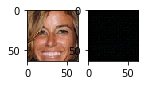

 78%|### |ETA:   0:00:22  Epoch: 5   Iter: 2399   Class Loss: 0.00   Loss: 0.20

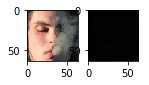

 81%|### |ETA:   0:00:21  Epoch: 5   Iter: 2496   Class Loss: 0.00   Loss: 0.31

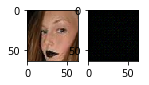

 85%|### |ETA:   0:00:15  Epoch: 5   Iter: 2598   Class Loss: 0.00   Loss: 0.18

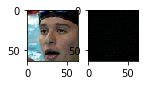

 88%|### |ETA:   0:00:12  Epoch: 5   Iter: 2698   Class Loss: 0.00   Loss: 0.20

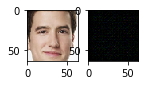

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2799   Class Loss: 0.00   Loss: 0.19

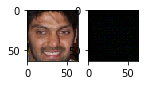

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2898   Class Loss: 0.00   Loss: 0.18

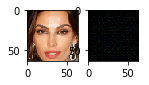

 98%|### |ETA:   0:00:01  Epoch: 5   Iter: 2999   Class Loss: 0.00   Loss: 0.14

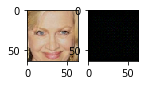

100%|####|Time:  0:01:50  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

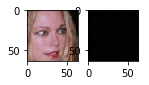

  3%|      |ETA:   0:01:53  Epoch: 6   Iter: 98   Class Loss: 0.00   Loss: 0.17

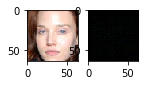

  6%|     |ETA:   0:01:41  Epoch: 6   Iter: 197   Class Loss: 0.00   Loss: 0.21

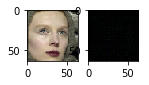

  9%|     |ETA:   0:01:35  Epoch: 6   Iter: 297   Class Loss: 0.00   Loss: 0.19

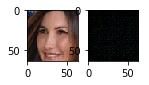

 13%|     |ETA:   0:01:31  Epoch: 6   Iter: 398   Class Loss: 0.00   Loss: 0.18

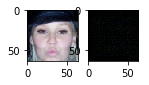

 16%|     |ETA:   0:01:27  Epoch: 6   Iter: 499   Class Loss: 0.00   Loss: 0.18

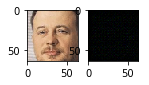

 19%|     |ETA:   0:01:23  Epoch: 6   Iter: 597   Class Loss: 0.00   Loss: 0.19

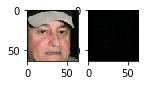

 22%|#    |ETA:   0:01:21  Epoch: 6   Iter: 699   Class Loss: 0.00   Loss: 0.20

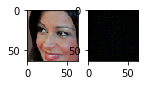

 26%|#    |ETA:   0:01:17  Epoch: 6   Iter: 797   Class Loss: 0.00   Loss: 0.15

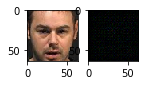

 29%|#    |ETA:   0:01:14  Epoch: 6   Iter: 897   Class Loss: 0.00   Loss: 0.20

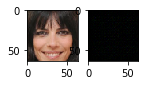

 32%|#    |ETA:   0:01:10  Epoch: 6   Iter: 999   Class Loss: 0.00   Loss: 0.15

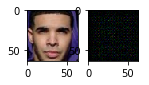

 36%|#   |ETA:   0:01:07  Epoch: 6   Iter: 1099   Class Loss: 0.00   Loss: 0.17

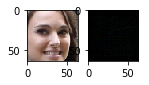

 39%|#   |ETA:   0:01:04  Epoch: 6   Iter: 1198   Class Loss: 0.00   Loss: 0.15

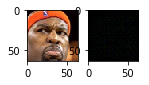

 42%|#   |ETA:   0:00:59  Epoch: 6   Iter: 1298   Class Loss: 0.00   Loss: 0.17

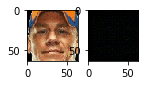

 45%|#   |ETA:   0:00:56  Epoch: 6   Iter: 1397   Class Loss: 0.00   Loss: 0.18

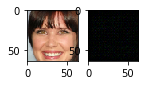

 49%|#   |ETA:   0:00:53  Epoch: 6   Iter: 1497   Class Loss: 0.00   Loss: 0.21

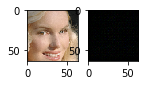

 52%|##  |ETA:   0:00:50  Epoch: 6   Iter: 1598   Class Loss: 0.00   Loss: 0.16

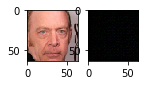

 55%|##  |ETA:   0:00:46  Epoch: 6   Iter: 1697   Class Loss: 0.00   Loss: 0.17

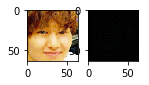

 58%|##  |ETA:   0:00:43  Epoch: 6   Iter: 1797   Class Loss: 0.00   Loss: 0.17

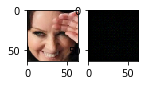

 62%|##  |ETA:   0:00:39  Epoch: 6   Iter: 1899   Class Loss: 0.00   Loss: 0.16

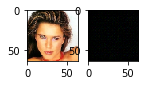

 65%|##  |ETA:   0:00:36  Epoch: 6   Iter: 1998   Class Loss: 0.00   Loss: 0.17

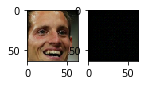

 68%|##  |ETA:   0:00:32  Epoch: 6   Iter: 2098   Class Loss: 0.00   Loss: 0.16

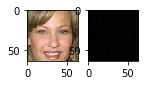

 72%|##  |ETA:   0:00:32  Epoch: 6   Iter: 2199   Class Loss: 0.00   Loss: 0.16

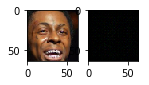

 75%|### |ETA:   0:00:28  Epoch: 6   Iter: 2297   Class Loss: 0.00   Loss: 0.17

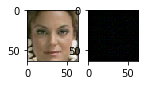

 78%|### |ETA:   0:00:23  Epoch: 6   Iter: 2399   Class Loss: 0.00   Loss: 0.19

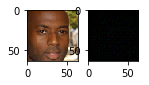

 81%|### |ETA:   0:00:19  Epoch: 6   Iter: 2497   Class Loss: 0.00   Loss: 0.17

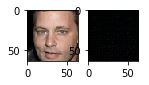

 85%|### |ETA:   0:00:15  Epoch: 6   Iter: 2598   Class Loss: 0.00   Loss: 0.15

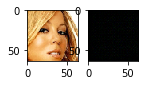

 88%|### |ETA:   0:00:12  Epoch: 6   Iter: 2699   Class Loss: 0.00   Loss: 0.21

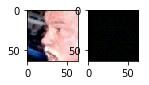

 91%|### |ETA:   0:00:08  Epoch: 6   Iter: 2799   Class Loss: 0.00   Loss: 0.15

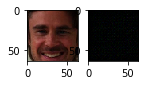

 94%|### |ETA:   0:00:05  Epoch: 6   Iter: 2898   Class Loss: 0.00   Loss: 0.17

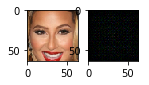

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2997   Class Loss: 0.00   Loss: 0.19

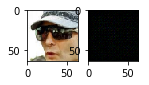

100%|####|Time:  0:01:51  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.18


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

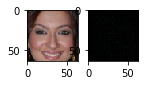

  3%|      |ETA:   0:01:41  Epoch: 7   Iter: 98   Class Loss: 0.00   Loss: 0.17

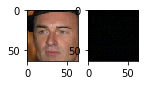

  6%|     |ETA:   0:01:39  Epoch: 7   Iter: 199   Class Loss: 0.00   Loss: 0.20

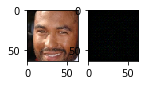

  9%|     |ETA:   0:01:35  Epoch: 7   Iter: 297   Class Loss: 0.00   Loss: 0.20

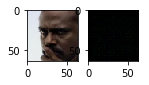

 13%|     |ETA:   0:01:30  Epoch: 7   Iter: 398   Class Loss: 0.00   Loss: 0.16

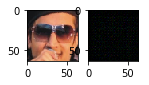

 16%|     |ETA:   0:01:28  Epoch: 7   Iter: 499   Class Loss: 0.00   Loss: 0.16

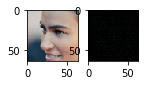

 19%|     |ETA:   0:01:24  Epoch: 7   Iter: 597   Class Loss: 0.00   Loss: 0.17

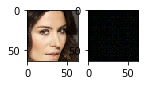

 22%|#    |ETA:   0:01:21  Epoch: 7   Iter: 699   Class Loss: 0.00   Loss: 0.17

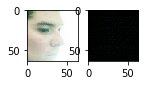

 26%|#    |ETA:   0:01:17  Epoch: 7   Iter: 797   Class Loss: 0.00   Loss: 0.18

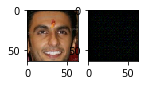

 29%|#    |ETA:   0:01:13  Epoch: 7   Iter: 897   Class Loss: 0.00   Loss: 0.20

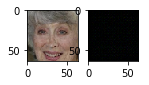

 32%|#    |ETA:   0:01:10  Epoch: 7   Iter: 999   Class Loss: 0.00   Loss: 0.19

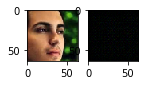

 35%|#   |ETA:   0:01:07  Epoch: 7   Iter: 1097   Class Loss: 0.00   Loss: 0.18

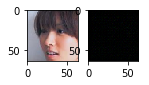

 39%|#   |ETA:   0:01:03  Epoch: 7   Iter: 1198   Class Loss: 0.00   Loss: 0.19

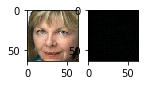

 42%|#   |ETA:   0:01:09  Epoch: 7   Iter: 1299   Class Loss: 0.00   Loss: 0.20

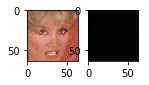

 45%|#   |ETA:   0:01:03  Epoch: 7   Iter: 1397   Class Loss: 0.00   Loss: 0.19

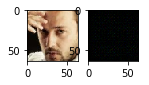

 49%|#   |ETA:   0:00:55  Epoch: 7   Iter: 1497   Class Loss: 0.00   Loss: 0.19

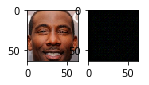

 52%|##  |ETA:   0:00:49  Epoch: 7   Iter: 1599   Class Loss: 0.00   Loss: 0.15

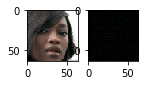

 55%|##  |ETA:   0:00:46  Epoch: 7   Iter: 1699   Class Loss: 0.00   Loss: 0.18

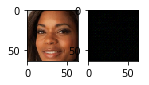

 58%|##  |ETA:   0:00:46  Epoch: 7   Iter: 1798   Class Loss: 0.00   Loss: 0.18

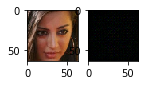

 62%|##  |ETA:   0:00:46  Epoch: 7   Iter: 1899   Class Loss: 0.00   Loss: 0.17

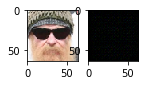

 65%|##  |ETA:   0:00:42  Epoch: 7   Iter: 1997   Class Loss: 0.00   Loss: 0.17

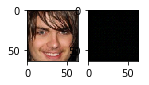

 68%|##  |ETA:   0:00:36  Epoch: 7   Iter: 2099   Class Loss: 0.00   Loss: 0.17

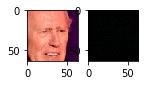

 71%|##  |ETA:   0:00:29  Epoch: 7   Iter: 2197   Class Loss: 0.00   Loss: 0.21

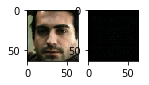

 75%|### |ETA:   0:00:26  Epoch: 7   Iter: 2298   Class Loss: 0.00   Loss: 0.16

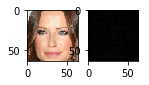

 78%|### |ETA:   0:00:22  Epoch: 7   Iter: 2399   Class Loss: 0.00   Loss: 0.15

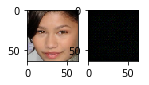

 81%|### |ETA:   0:00:19  Epoch: 7   Iter: 2499   Class Loss: 0.00   Loss: 0.15

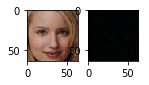

 85%|### |ETA:   0:00:15  Epoch: 7   Iter: 2597   Class Loss: 0.00   Loss: 0.19

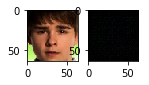

 88%|### |ETA:   0:00:12  Epoch: 7   Iter: 2699   Class Loss: 0.00   Loss: 0.18

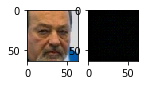

 91%|### |ETA:   0:00:08  Epoch: 7   Iter: 2799   Class Loss: 0.00   Loss: 0.15

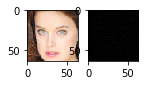

 94%|### |ETA:   0:00:05  Epoch: 7   Iter: 2898   Class Loss: 0.00   Loss: 0.16

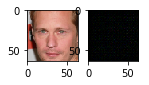

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2997   Class Loss: 0.00   Loss: 0.14

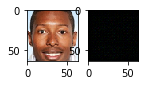

100%|####|Time:  0:01:52  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.19


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

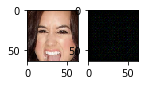

  3%|      |ETA:   0:01:41  Epoch: 8   Iter: 98   Class Loss: 0.00   Loss: 0.18

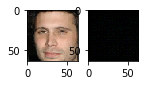

  6%|     |ETA:   0:01:37  Epoch: 8   Iter: 199   Class Loss: 0.00   Loss: 0.17

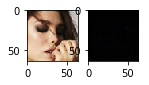

  9%|     |ETA:   0:01:44  Epoch: 8   Iter: 299   Class Loss: 0.00   Loss: 0.14

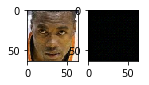

 13%|     |ETA:   0:01:43  Epoch: 8   Iter: 398   Class Loss: 0.00   Loss: 0.16

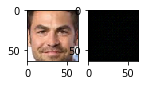

 16%|     |ETA:   0:01:38  Epoch: 8   Iter: 499   Class Loss: 0.00   Loss: 0.17

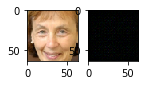

 19%|     |ETA:   0:01:24  Epoch: 8   Iter: 597   Class Loss: 0.00   Loss: 0.16

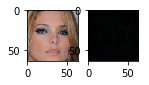

 22%|#    |ETA:   0:01:21  Epoch: 8   Iter: 698   Class Loss: 0.00   Loss: 0.18

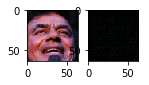

 26%|#    |ETA:   0:01:17  Epoch: 8   Iter: 797   Class Loss: 0.00   Loss: 0.22

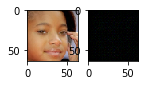

 29%|#    |ETA:   0:01:13  Epoch: 8   Iter: 899   Class Loss: 0.10   Loss: 0.29

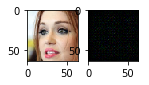

 32%|#    |ETA:   0:01:11  Epoch: 8   Iter: 998   Class Loss: 0.00   Loss: 0.25

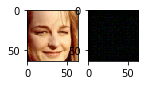

 35%|#   |ETA:   0:01:07  Epoch: 8   Iter: 1097   Class Loss: 0.00   Loss: 0.18

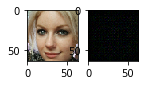

 39%|#   |ETA:   0:01:04  Epoch: 8   Iter: 1198   Class Loss: 0.00   Loss: 0.18

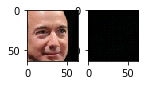

 42%|#   |ETA:   0:01:00  Epoch: 8   Iter: 1297   Class Loss: 0.00   Loss: 0.19

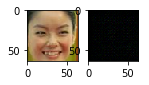

 45%|#   |ETA:   0:00:57  Epoch: 8   Iter: 1397   Class Loss: 0.00   Loss: 0.20

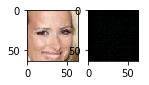

 49%|#   |ETA:   0:00:54  Epoch: 8   Iter: 1498   Class Loss: 0.00   Loss: 0.20

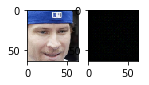

 52%|##  |ETA:   0:00:49  Epoch: 8   Iter: 1597   Class Loss: 0.00   Loss: 0.18

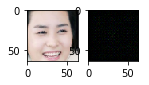

 55%|##  |ETA:   0:00:46  Epoch: 8   Iter: 1697   Class Loss: 0.00   Loss: 0.19

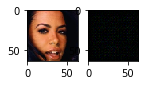

 58%|##  |ETA:   0:00:43  Epoch: 8   Iter: 1798   Class Loss: 0.00   Loss: 0.19

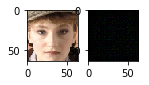

 62%|##  |ETA:   0:00:44  Epoch: 8   Iter: 1899   Class Loss: 0.00   Loss: 0.20

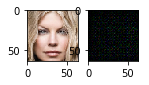

 65%|##  |ETA:   0:00:36  Epoch: 8   Iter: 1999   Class Loss: 0.00   Loss: 0.19

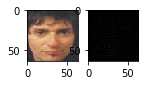

 68%|##  |ETA:   0:00:32  Epoch: 8   Iter: 2098   Class Loss: 0.00   Loss: 0.17

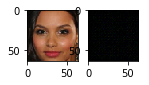

 71%|##  |ETA:   0:00:29  Epoch: 8   Iter: 2197   Class Loss: 0.00   Loss: 0.21

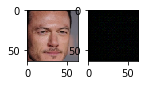

 75%|### |ETA:   0:00:25  Epoch: 8   Iter: 2299   Class Loss: 0.00   Loss: 0.19

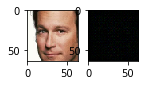

 78%|### |ETA:   0:00:22  Epoch: 8   Iter: 2399   Class Loss: 0.00   Loss: 0.17

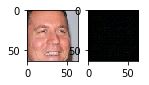

 81%|### |ETA:   0:00:20  Epoch: 8   Iter: 2497   Class Loss: 0.00   Loss: 0.17

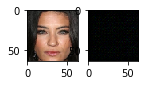

 85%|### |ETA:   0:00:17  Epoch: 8   Iter: 2598   Class Loss: 0.00   Loss: 0.17

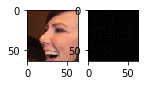

 88%|### |ETA:   0:00:13  Epoch: 8   Iter: 2698   Class Loss: 0.00   Loss: 0.17

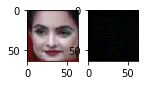

 91%|### |ETA:   0:00:08  Epoch: 8   Iter: 2797   Class Loss: 0.00   Loss: 0.19

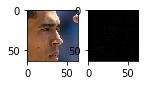

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2898   Class Loss: 0.00   Loss: 0.18

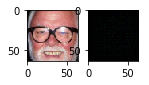

 98%|### |ETA:   0:00:01  Epoch: 8   Iter: 2998   Class Loss: 0.00   Loss: 0.18

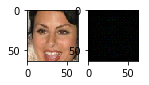

100%|####|Time:  0:01:51  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.21


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

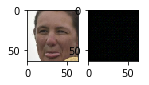

  3%|      |ETA:   0:01:42  Epoch: 9   Iter: 98   Class Loss: 0.00   Loss: 0.23

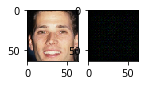

  6%|     |ETA:   0:01:38  Epoch: 9   Iter: 199   Class Loss: 0.00   Loss: 0.20

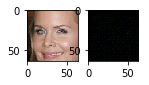

  9%|     |ETA:   0:01:34  Epoch: 9   Iter: 297   Class Loss: 0.00   Loss: 0.19

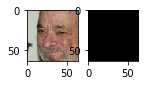

 13%|     |ETA:   0:01:32  Epoch: 9   Iter: 398   Class Loss: 0.00   Loss: 0.20

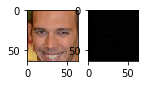

 16%|     |ETA:   0:01:28  Epoch: 9   Iter: 497   Class Loss: 0.00   Loss: 0.17

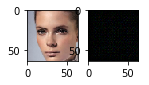

 19%|     |ETA:   0:01:24  Epoch: 9   Iter: 598   Class Loss: 0.00   Loss: 0.18

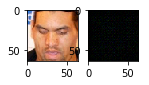

 22%|#    |ETA:   0:01:21  Epoch: 9   Iter: 698   Class Loss: 0.00   Loss: 0.19

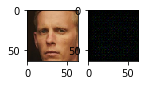

 26%|#    |ETA:   0:01:18  Epoch: 9   Iter: 799   Class Loss: 0.00   Loss: 0.18

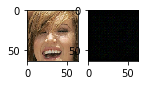

 29%|#    |ETA:   0:01:13  Epoch: 9   Iter: 899   Class Loss: 0.00   Loss: 0.20

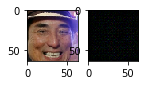

 32%|#    |ETA:   0:01:10  Epoch: 9   Iter: 997   Class Loss: 0.00   Loss: 0.21

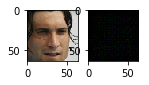

 35%|#   |ETA:   0:01:07  Epoch: 9   Iter: 1097   Class Loss: 0.00   Loss: 0.23

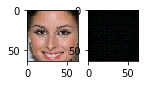

 39%|#   |ETA:   0:01:04  Epoch: 9   Iter: 1198   Class Loss: 0.00   Loss: 0.21

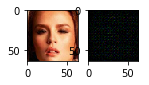

 42%|#   |ETA:   0:01:00  Epoch: 9   Iter: 1299   Class Loss: 0.00   Loss: 0.21

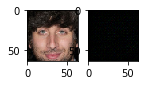

 45%|#   |ETA:   0:00:56  Epoch: 9   Iter: 1399   Class Loss: 0.00   Loss: 0.16

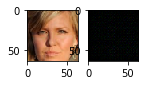

 49%|#   |ETA:   0:00:53  Epoch: 9   Iter: 1498   Class Loss: 0.00   Loss: 0.17

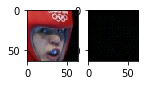

 52%|##  |ETA:   0:00:54  Epoch: 9   Iter: 1599   Class Loss: 0.00   Loss: 0.20

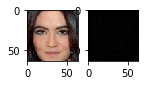

 55%|##  |ETA:   0:00:51  Epoch: 9   Iter: 1699   Class Loss: 0.00   Loss: 0.19

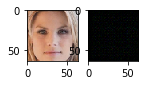

 58%|##  |ETA:   0:00:48  Epoch: 9   Iter: 1798   Class Loss: 0.00   Loss: 0.22

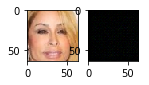

 62%|##  |ETA:   0:00:39  Epoch: 9   Iter: 1899   Class Loss: 0.00   Loss: 0.18

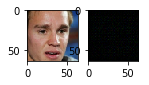

 65%|##  |ETA:   0:00:36  Epoch: 9   Iter: 1997   Class Loss: 0.00   Loss: 0.19

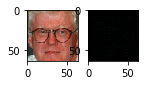

 68%|##  |ETA:   0:00:32  Epoch: 9   Iter: 2098   Class Loss: 0.00   Loss: 0.17

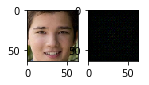

 71%|##  |ETA:   0:00:29  Epoch: 9   Iter: 2197   Class Loss: 0.00   Loss: 0.16

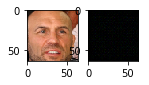

 75%|### |ETA:   0:00:26  Epoch: 9   Iter: 2298   Class Loss: 0.00   Loss: 0.22

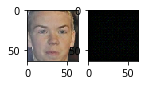

 78%|### |ETA:   0:00:22  Epoch: 9   Iter: 2399   Class Loss: 0.00   Loss: 0.21

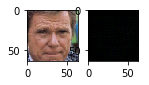

 81%|### |ETA:   0:00:19  Epoch: 9   Iter: 2497   Class Loss: 0.00   Loss: 0.19

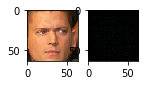

 85%|### |ETA:   0:00:15  Epoch: 9   Iter: 2598   Class Loss: 0.00   Loss: 0.17

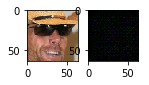

 88%|### |ETA:   0:00:12  Epoch: 9   Iter: 2698   Class Loss: 0.00   Loss: 0.19

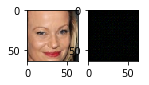

 91%|### |ETA:   0:00:08  Epoch: 9   Iter: 2797   Class Loss: 0.00   Loss: 0.19

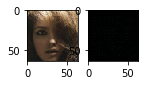

 94%|### |ETA:   0:00:05  Epoch: 9   Iter: 2897   Class Loss: 0.00   Loss: 0.18

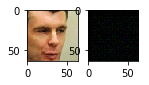

 98%|### |ETA:   0:00:01  Epoch: 9   Iter: 2999   Class Loss: 0.00   Loss: 0.19

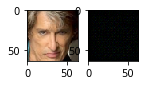

100%|####|Time:  0:01:50  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.20
100% (97 of 97) |########################| Elapsed Time: 0:01:11 Time:  0:01:11
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 0.948453608247


100% (72 of 72) |########################| Elapsed Time: 0:00:50 Time:  0:00:50
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.902777777778


100% (78 of 78) |########################| Elapsed Time: 0:00:51 Time:  0:00:51
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.782051282051


100% (71 of 71) |########################| Elapsed Time: 0:00:48 Time:  0:00:48



female darker: 0.859154929577


Text(0,0.5,'Accuracy')

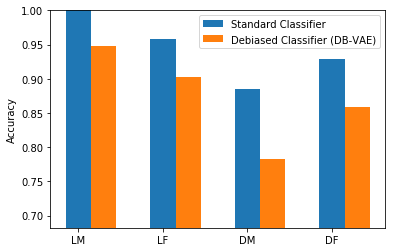

In [43]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.99)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

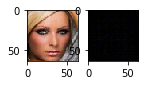

  3%|      |ETA:   0:01:40  Epoch: 0   Iter: 97   Class Loss: 0.00   Loss: 0.21

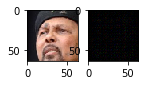

  6%|     |ETA:   0:01:47  Epoch: 0   Iter: 199   Class Loss: 0.00   Loss: 0.22

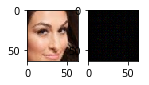

  9%|     |ETA:   0:01:44  Epoch: 0   Iter: 299   Class Loss: 0.00   Loss: 0.24

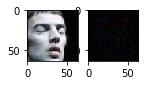

 13%|     |ETA:   0:01:27  Epoch: 0   Iter: 396   Class Loss: 0.00   Loss: 0.21

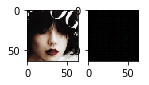

 16%|     |ETA:   0:01:23  Epoch: 0   Iter: 497   Class Loss: 0.00   Loss: 0.22

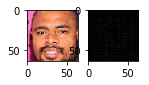

 19%|     |ETA:   0:01:20  Epoch: 0   Iter: 599   Class Loss: 0.00   Loss: 0.29

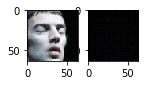

 22%|#    |ETA:   0:01:17  Epoch: 0   Iter: 698   Class Loss: 0.00   Loss: 0.19

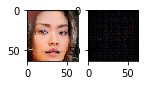

 26%|#    |ETA:   0:01:13  Epoch: 0   Iter: 799   Class Loss: 0.00   Loss: 0.28

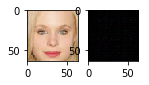

 29%|#    |ETA:   0:01:10  Epoch: 0   Iter: 896   Class Loss: 0.00   Loss: 0.30

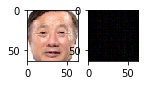

 32%|#    |ETA:   0:01:07  Epoch: 0   Iter: 996   Class Loss: 0.00   Loss: 0.34

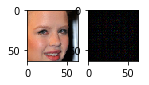

 35%|#   |ETA:   0:01:04  Epoch: 0   Iter: 1097   Class Loss: 0.00   Loss: 0.26

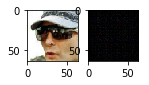

 39%|#   |ETA:   0:01:00  Epoch: 0   Iter: 1198   Class Loss: 0.00   Loss: 0.24

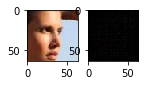

 42%|#   |ETA:   0:00:57  Epoch: 0   Iter: 1298   Class Loss: 0.00   Loss: 0.29

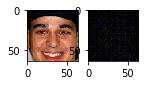

 45%|#   |ETA:   0:00:54  Epoch: 0   Iter: 1399   Class Loss: 0.00   Loss: 1.32

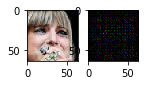

 49%|#   |ETA:   0:00:50  Epoch: 0   Iter: 1498   Class Loss: 0.00   Loss: 0.33

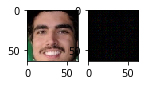

 52%|##  |ETA:   0:00:47  Epoch: 0   Iter: 1597   Class Loss: 0.00   Loss: 0.30

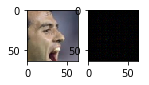

 55%|##  |ETA:   0:00:44  Epoch: 0   Iter: 1696   Class Loss: 0.00   Loss: 0.30

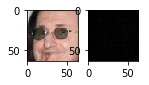

 58%|##  |ETA:   0:00:41  Epoch: 0   Iter: 1797   Class Loss: 0.00   Loss: 0.29

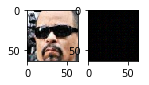

 62%|##  |ETA:   0:00:38  Epoch: 0   Iter: 1897   Class Loss: 0.00   Loss: 0.45

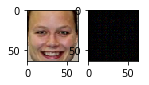

 65%|##  |ETA:   0:00:37  Epoch: 0   Iter: 1996   Class Loss: 0.00   Loss: 0.33

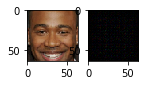

 68%|##  |ETA:   0:00:31  Epoch: 0   Iter: 2096   Class Loss: 0.00   Loss: 0.44

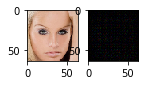

 72%|##  |ETA:   0:00:32  Epoch: 0   Iter: 2199   Class Loss: 0.00   Loss: 0.49

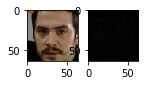

 75%|### |ETA:   0:00:26  Epoch: 0   Iter: 2296   Class Loss: 0.00   Loss: 0.62

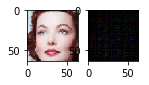

 78%|### |ETA:   0:00:22  Epoch: 0   Iter: 2398   Class Loss: 0.00   Loss: 0.36

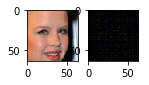

 81%|### |ETA:   0:00:20  Epoch: 0   Iter: 2499   Class Loss: 0.00   Loss: 0.34

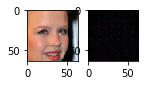

 85%|### |ETA:   0:00:17  Epoch: 0   Iter: 2598   Class Loss: 0.00   Loss: 0.52

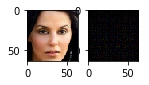

 88%|### |ETA:   0:00:11  Epoch: 0   Iter: 2699   Class Loss: 0.00   Loss: 0.51

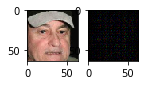

 91%|### |ETA:   0:00:08  Epoch: 0   Iter: 2796   Class Loss: 0.00   Loss: 0.40

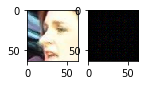

 94%|### |ETA:   0:00:05  Epoch: 0   Iter: 2898   Class Loss: 0.00   Loss: 1.17

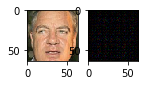

 98%|### |ETA:   0:00:01  Epoch: 0   Iter: 2998   Class Loss: 0.00   Loss: 0.34

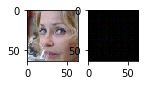

100%|####|Time:  0:01:47  Epoch: 0   Iter: 3052   Class Loss: 0.00   Loss: 0.41


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

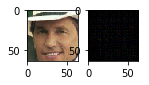

  3%|      |ETA:   0:01:36  Epoch: 1   Iter: 96   Class Loss: 0.00   Loss: 0.27

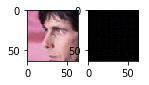

  6%|     |ETA:   0:01:33  Epoch: 1   Iter: 199   Class Loss: 0.00   Loss: 0.54

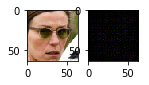

  9%|     |ETA:   0:01:30  Epoch: 1   Iter: 297   Class Loss: 0.00   Loss: 0.34

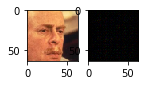

 13%|     |ETA:   0:01:26  Epoch: 1   Iter: 397   Class Loss: 0.00   Loss: 0.60

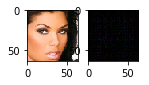

 16%|     |ETA:   0:01:23  Epoch: 1   Iter: 498   Class Loss: 0.00   Loss: 0.30

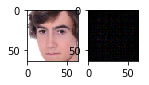

 19%|     |ETA:   0:01:20  Epoch: 1   Iter: 597   Class Loss: 0.00   Loss: 0.26

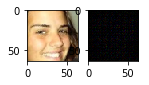

 22%|#    |ETA:   0:01:16  Epoch: 1   Iter: 699   Class Loss: 0.00   Loss: 0.25

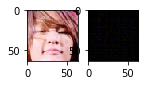

 26%|#    |ETA:   0:01:13  Epoch: 1   Iter: 798   Class Loss: 0.00   Loss: 0.25

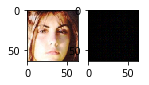

 29%|#    |ETA:   0:01:10  Epoch: 1   Iter: 899   Class Loss: 0.00   Loss: 0.23

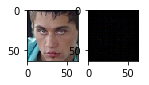

 32%|#    |ETA:   0:01:07  Epoch: 1   Iter: 999   Class Loss: 0.00   Loss: 0.30

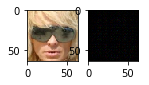

 36%|#   |ETA:   0:01:09  Epoch: 1   Iter: 1099   Class Loss: 0.00   Loss: 0.25

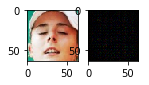

 39%|#   |ETA:   0:01:01  Epoch: 1   Iter: 1197   Class Loss: 0.00   Loss: 0.34

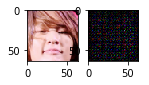

 42%|#   |ETA:   0:00:57  Epoch: 1   Iter: 1299   Class Loss: 0.00   Loss: 0.34

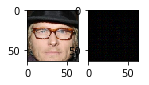

 45%|#   |ETA:   0:00:54  Epoch: 1   Iter: 1398   Class Loss: 0.00   Loss: 0.64

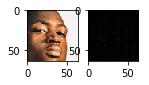

 49%|#   |ETA:   0:00:50  Epoch: 1   Iter: 1496   Class Loss: 0.00   Loss: 0.55

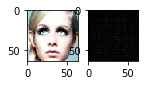

 52%|##  |ETA:   0:00:52  Epoch: 1   Iter: 1599   Class Loss: 0.00   Loss: 0.48

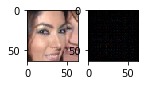

 55%|##  |ETA:   0:00:50  Epoch: 1   Iter: 1697   Class Loss: 0.00   Loss: 0.80

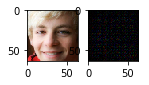

 58%|##  |ETA:   0:00:47  Epoch: 1   Iter: 1798   Class Loss: 0.00   Loss: 0.90

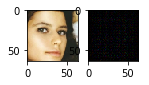

 62%|##  |ETA:   0:00:37  Epoch: 1   Iter: 1897   Class Loss: 0.00   Loss: 0.45

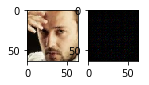

 65%|##  |ETA:   0:00:34  Epoch: 1   Iter: 1996   Class Loss: 0.00   Loss: 0.50

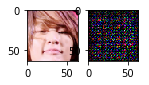

 68%|##  |ETA:   0:00:31  Epoch: 1   Iter: 2097   Class Loss: 0.00   Loss: 0.45

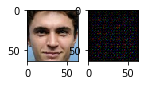

 72%|##  |ETA:   0:00:27  Epoch: 1   Iter: 2198   Class Loss: 0.00   Loss: 0.48

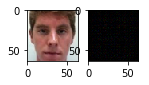

 75%|### |ETA:   0:00:24  Epoch: 1   Iter: 2297   Class Loss: 0.00   Loss: 0.47

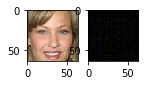

 78%|### |ETA:   0:00:21  Epoch: 1   Iter: 2396   Class Loss: 0.00   Loss: 0.96

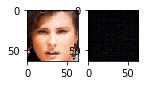

 81%|### |ETA:   0:00:18  Epoch: 1   Iter: 2498   Class Loss: 0.00   Loss: 0.27

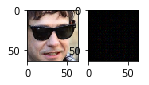

 85%|### |ETA:   0:00:14  Epoch: 1   Iter: 2596   Class Loss: 0.00   Loss: 4.15

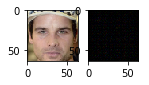

 88%|### |ETA:   0:00:11  Epoch: 1   Iter: 2697   Class Loss: 0.00   Loss: 0.38

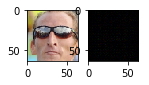

 91%|### |ETA:   0:00:08  Epoch: 1   Iter: 2797   Class Loss: 0.00   Loss: 0.30

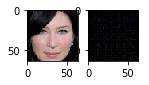

 94%|### |ETA:   0:00:05  Epoch: 1   Iter: 2898   Class Loss: 0.00   Loss: 0.22

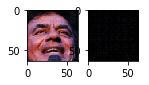

 98%|### |ETA:   0:00:02  Epoch: 1   Iter: 2999   Class Loss: 0.00   Loss: 0.33

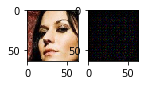

100%|####|Time:  0:01:46  Epoch: 1   Iter: 3052   Class Loss: 0.00   Loss: 0.70


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

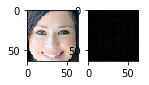

  3%|      |ETA:   0:01:37  Epoch: 2   Iter: 99   Class Loss: 0.00   Loss: 0.28

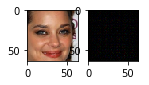

  6%|     |ETA:   0:01:42  Epoch: 2   Iter: 197   Class Loss: 0.00   Loss: 0.33

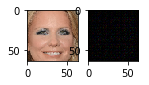

  9%|     |ETA:   0:01:30  Epoch: 2   Iter: 296   Class Loss: 0.00   Loss: 0.26

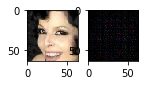

 13%|     |ETA:   0:01:27  Epoch: 2   Iter: 398   Class Loss: 0.00   Loss: 0.29

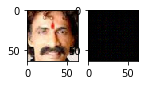

 16%|     |ETA:   0:01:23  Epoch: 2   Iter: 497   Class Loss: 0.00   Loss: 0.27

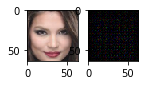

 19%|     |ETA:   0:01:20  Epoch: 2   Iter: 596   Class Loss: 0.00   Loss: 2.00

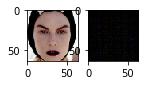

 22%|#    |ETA:   0:01:17  Epoch: 2   Iter: 699   Class Loss: 0.00   Loss: 0.39

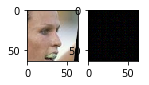

 26%|#    |ETA:   0:01:24  Epoch: 2   Iter: 799   Class Loss: 0.00   Loss: 0.37

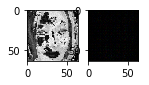

 29%|#    |ETA:   0:01:21  Epoch: 2   Iter: 897   Class Loss: 0.00   Loss: 0.35

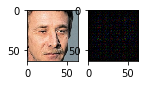

 32%|#    |ETA:   0:01:11  Epoch: 2   Iter: 999   Class Loss: 0.00   Loss: 0.20

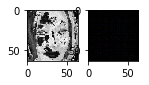

 35%|#   |ETA:   0:01:03  Epoch: 2   Iter: 1096   Class Loss: 0.00   Loss: 0.21

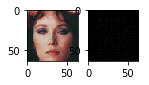

 39%|#   |ETA:   0:01:00  Epoch: 2   Iter: 1198   Class Loss: 0.00   Loss: 0.24

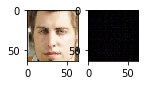

 42%|#   |ETA:   0:00:57  Epoch: 2   Iter: 1298   Class Loss: 0.00   Loss: 0.78

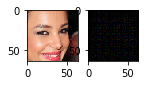

 45%|#   |ETA:   0:00:54  Epoch: 2   Iter: 1397   Class Loss: 0.00   Loss: 0.34

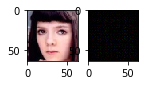

 49%|#   |ETA:   0:00:50  Epoch: 2   Iter: 1499   Class Loss: 0.00   Loss: 0.47

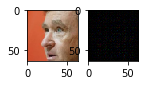

 52%|##  |ETA:   0:00:47  Epoch: 2   Iter: 1599   Class Loss: 0.00   Loss: 0.35

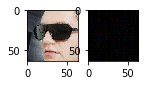

 55%|##  |ETA:   0:00:44  Epoch: 2   Iter: 1697   Class Loss: 0.00   Loss: 0.27

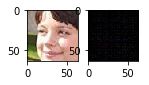

 58%|##  |ETA:   0:00:41  Epoch: 2   Iter: 1796   Class Loss: 0.00   Loss: 0.34

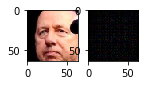

 62%|##  |ETA:   0:00:37  Epoch: 2   Iter: 1899   Class Loss: 0.00   Loss: 0.33

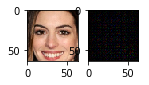

 65%|##  |ETA:   0:00:34  Epoch: 2   Iter: 1997   Class Loss: 0.00   Loss: 0.25

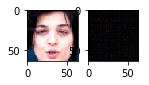

 68%|##  |ETA:   0:00:31  Epoch: 2   Iter: 2097   Class Loss: 0.00   Loss: 0.38

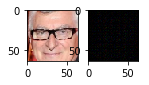

 72%|##  |ETA:   0:00:27  Epoch: 2   Iter: 2199   Class Loss: 0.00   Loss: 0.29

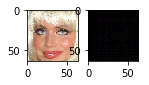

 75%|### |ETA:   0:00:24  Epoch: 2   Iter: 2298   Class Loss: 0.00   Loss: 0.26

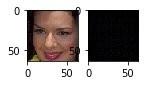

 78%|### |ETA:   0:00:24  Epoch: 2   Iter: 2398   Class Loss: 0.00   Loss: 0.24

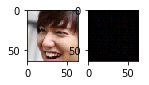

 81%|### |ETA:   0:00:18  Epoch: 2   Iter: 2499   Class Loss: 0.00   Loss: 0.21

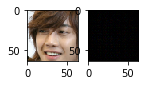

 85%|### |ETA:   0:00:15  Epoch: 2   Iter: 2599   Class Loss: 0.00   Loss: 0.22

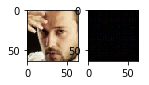

 88%|### |ETA:   0:00:11  Epoch: 2   Iter: 2696   Class Loss: 0.00   Loss: 0.26

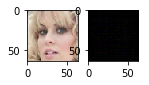

 91%|### |ETA:   0:00:08  Epoch: 2   Iter: 2799   Class Loss: 0.00   Loss: 0.21

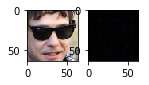

 94%|### |ETA:   0:00:05  Epoch: 2   Iter: 2898   Class Loss: 0.00   Loss: 0.23

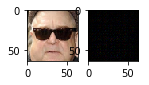

 98%|### |ETA:   0:00:01  Epoch: 2   Iter: 2997   Class Loss: 0.00   Loss: 0.20

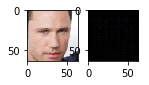

100%|####|Time:  0:01:46  Epoch: 2   Iter: 3052   Class Loss: 0.00   Loss: 0.21


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

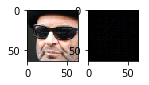

  3%|      |ETA:   0:01:50  Epoch: 3   Iter: 98   Class Loss: 0.00   Loss: 0.18

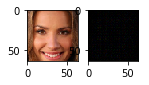

  6%|     |ETA:   0:01:38  Epoch: 3   Iter: 196   Class Loss: 0.00   Loss: 0.27

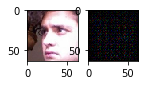

  9%|     |ETA:   0:01:30  Epoch: 3   Iter: 297   Class Loss: 0.00   Loss: 0.30

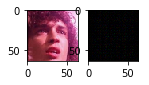

 13%|     |ETA:   0:01:27  Epoch: 3   Iter: 399   Class Loss: 0.00   Loss: 0.25

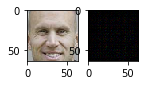

 16%|     |ETA:   0:01:22  Epoch: 3   Iter: 498   Class Loss: 0.00   Loss: 0.28

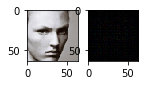

 19%|     |ETA:   0:01:19  Epoch: 3   Iter: 598   Class Loss: 0.00   Loss: 0.32

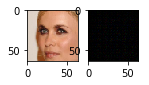

 22%|#    |ETA:   0:01:16  Epoch: 3   Iter: 698   Class Loss: 0.00   Loss: 1.32

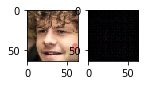

 26%|#    |ETA:   0:01:13  Epoch: 3   Iter: 799   Class Loss: 0.00   Loss: 0.25

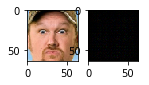

 29%|#    |ETA:   0:01:10  Epoch: 3   Iter: 899   Class Loss: 0.00   Loss: 0.29

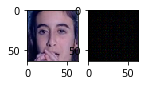

 32%|#    |ETA:   0:01:06  Epoch: 3   Iter: 996   Class Loss: 0.00   Loss: 0.33

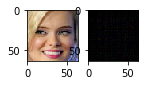

 35%|#   |ETA:   0:01:03  Epoch: 3   Iter: 1098   Class Loss: 0.00   Loss: 0.28

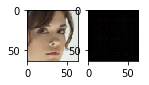

 39%|#   |ETA:   0:01:00  Epoch: 3   Iter: 1198   Class Loss: 0.00   Loss: 0.27

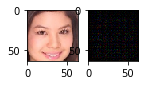

 42%|#   |ETA:   0:00:56  Epoch: 3   Iter: 1298   Class Loss: 0.00   Loss: 0.21

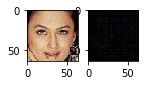

 45%|#   |ETA:   0:00:53  Epoch: 3   Iter: 1399   Class Loss: 0.00   Loss: 0.37

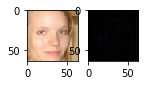

 49%|#   |ETA:   0:00:56  Epoch: 3   Iter: 1497   Class Loss: 0.00   Loss: 0.24

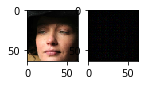

 52%|##  |ETA:   0:00:55  Epoch: 3   Iter: 1599   Class Loss: 0.00   Loss: 0.36

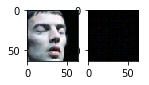

 55%|##  |ETA:   0:00:44  Epoch: 3   Iter: 1696   Class Loss: 0.00   Loss: 0.22

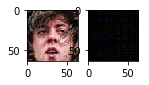

 58%|##  |ETA:   0:00:40  Epoch: 3   Iter: 1796   Class Loss: 0.00   Loss: 0.35

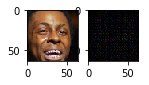

 62%|##  |ETA:   0:00:37  Epoch: 3   Iter: 1897   Class Loss: 0.00   Loss: 0.22

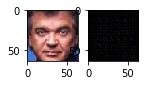

 65%|##  |ETA:   0:00:34  Epoch: 3   Iter: 1997   Class Loss: 0.00   Loss: 0.23

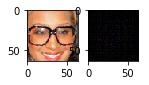

 68%|##  |ETA:   0:00:30  Epoch: 3   Iter: 2098   Class Loss: 0.00   Loss: 0.28

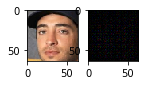

 72%|##  |ETA:   0:00:27  Epoch: 3   Iter: 2199   Class Loss: 0.00   Loss: 0.39

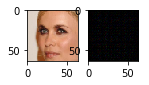

 75%|### |ETA:   0:00:28  Epoch: 3   Iter: 2298   Class Loss: 0.00   Loss: 0.21

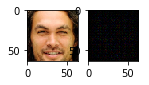

 78%|### |ETA:   0:00:24  Epoch: 3   Iter: 2399   Class Loss: 0.00   Loss: 0.19

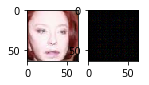

 81%|### |ETA:   0:00:19  Epoch: 3   Iter: 2497   Class Loss: 0.00   Loss: 0.30

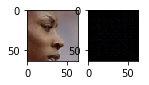

 85%|### |ETA:   0:00:14  Epoch: 3   Iter: 2596   Class Loss: 0.00   Loss: 0.27

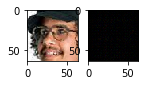

 88%|### |ETA:   0:00:11  Epoch: 3   Iter: 2697   Class Loss: 0.00   Loss: 0.30

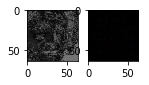

 91%|### |ETA:   0:00:08  Epoch: 3   Iter: 2798   Class Loss: 0.00   Loss: 0.32

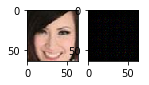

 94%|### |ETA:   0:00:05  Epoch: 3   Iter: 2898   Class Loss: 0.00   Loss: 0.40

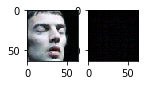

 98%|### |ETA:   0:00:01  Epoch: 3   Iter: 2998   Class Loss: 0.00   Loss: 0.28

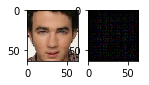

100%|####|Time:  0:01:46  Epoch: 3   Iter: 3052   Class Loss: 0.00   Loss: 0.26


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

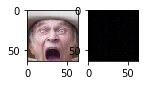

  3%|      |ETA:   0:01:34  Epoch: 4   Iter: 96   Class Loss: 0.00   Loss: 0.29

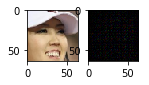

  6%|     |ETA:   0:01:31  Epoch: 4   Iter: 199   Class Loss: 0.00   Loss: 0.22

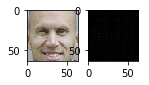

  9%|     |ETA:   0:01:28  Epoch: 4   Iter: 298   Class Loss: 0.00   Loss: 0.24

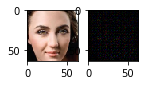

 13%|     |ETA:   0:01:34  Epoch: 4   Iter: 397   Class Loss: 0.00   Loss: 0.32

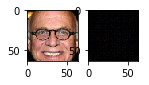

 16%|     |ETA:   0:01:22  Epoch: 4   Iter: 498   Class Loss: 0.00   Loss: 0.23

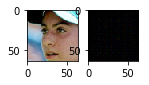

 19%|     |ETA:   0:01:26  Epoch: 4   Iter: 597   Class Loss: 0.00   Loss: 0.32

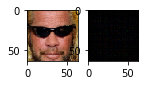

 22%|#    |ETA:   0:01:16  Epoch: 4   Iter: 699   Class Loss: 0.00   Loss: 0.22

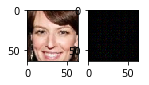

 26%|#    |ETA:   0:01:12  Epoch: 4   Iter: 799   Class Loss: 0.00   Loss: 0.23

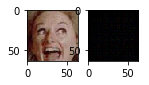

 29%|#    |ETA:   0:01:09  Epoch: 4   Iter: 899   Class Loss: 0.00   Loss: 0.25

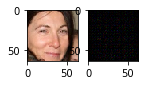

 32%|#    |ETA:   0:01:06  Epoch: 4   Iter: 997   Class Loss: 0.00   Loss: 0.22

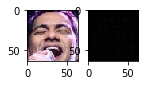

 36%|#   |ETA:   0:01:04  Epoch: 4   Iter: 1099   Class Loss: 0.00   Loss: 0.21

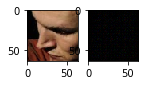

 39%|#   |ETA:   0:01:00  Epoch: 4   Iter: 1198   Class Loss: 0.00   Loss: 0.28

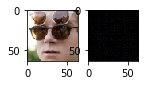

 42%|#   |ETA:   0:00:57  Epoch: 4   Iter: 1299   Class Loss: 0.00   Loss: 0.34

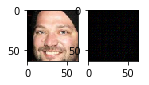

 45%|#   |ETA:   0:00:55  Epoch: 4   Iter: 1397   Class Loss: 0.00   Loss: 0.36

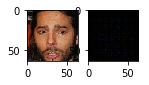

 49%|#   |ETA:   0:00:58  Epoch: 4   Iter: 1498   Class Loss: 0.00   Loss: 0.24

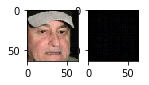

 52%|##  |ETA:   0:00:55  Epoch: 4   Iter: 1599   Class Loss: 0.00   Loss: 0.29

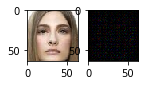

 55%|##  |ETA:   0:00:46  Epoch: 4   Iter: 1697   Class Loss: 0.00   Loss: 0.50

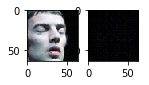

 58%|##  |ETA:   0:00:43  Epoch: 4   Iter: 1796   Class Loss: 0.00   Loss: 0.25

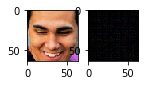

 62%|##  |ETA:   0:00:38  Epoch: 4   Iter: 1896   Class Loss: 0.00   Loss: 0.33

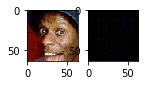

 65%|##  |ETA:   0:00:34  Epoch: 4   Iter: 1996   Class Loss: 0.00   Loss: 0.26

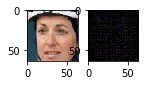

 68%|##  |ETA:   0:00:31  Epoch: 4   Iter: 2098   Class Loss: 0.00   Loss: 0.26

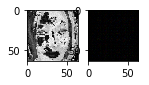

 72%|##  |ETA:   0:00:27  Epoch: 4   Iter: 2198   Class Loss: 0.00   Loss: 0.24

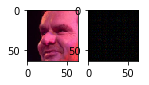

 75%|### |ETA:   0:00:24  Epoch: 4   Iter: 2298   Class Loss: 0.00   Loss: 0.22

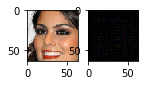

 78%|### |ETA:   0:00:22  Epoch: 4   Iter: 2399   Class Loss: 0.00   Loss: 0.28

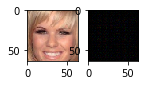

 81%|### |ETA:   0:00:21  Epoch: 4   Iter: 2497   Class Loss: 0.00   Loss: 0.29

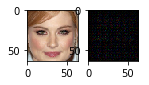

 85%|### |ETA:   0:00:17  Epoch: 4   Iter: 2598   Class Loss: 0.00   Loss: 0.30

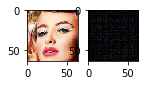

 88%|### |ETA:   0:00:11  Epoch: 4   Iter: 2698   Class Loss: 0.00   Loss: 0.24

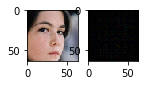

 91%|### |ETA:   0:00:09  Epoch: 4   Iter: 2797   Class Loss: 0.00   Loss: 0.33

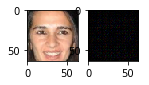

 94%|### |ETA:   0:00:05  Epoch: 4   Iter: 2898   Class Loss: 0.00   Loss: 0.23

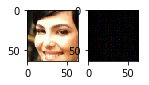

 98%|### |ETA:   0:00:01  Epoch: 4   Iter: 2998   Class Loss: 0.00   Loss: 0.24

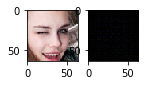

100%|####|Time:  0:01:48  Epoch: 4   Iter: 3052   Class Loss: 0.00   Loss: 0.43


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

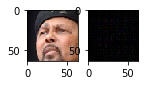

  3%|      |ETA:   0:01:36  Epoch: 5   Iter: 98   Class Loss: 0.00   Loss: 0.26

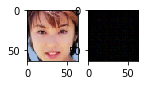

  6%|     |ETA:   0:01:32  Epoch: 5   Iter: 197   Class Loss: 0.00   Loss: 0.37

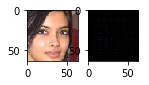

  9%|     |ETA:   0:01:29  Epoch: 5   Iter: 297   Class Loss: 0.00   Loss: 0.58

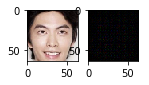

 13%|     |ETA:   0:01:27  Epoch: 5   Iter: 399   Class Loss: 0.00   Loss: 0.26

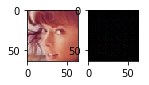

 16%|     |ETA:   0:01:24  Epoch: 5   Iter: 497   Class Loss: 0.00   Loss: 0.54

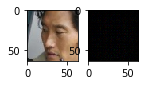

 19%|     |ETA:   0:01:31  Epoch: 5   Iter: 597   Class Loss: 0.00   Loss: 0.29

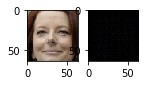

 22%|#    |ETA:   0:01:27  Epoch: 5   Iter: 698   Class Loss: 0.00   Loss: 0.99

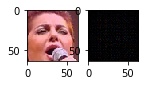

 26%|#    |ETA:   0:01:22  Epoch: 5   Iter: 799   Class Loss: 0.00   Loss: 0.39

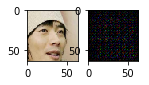

 29%|#    |ETA:   0:01:10  Epoch: 5   Iter: 896   Class Loss: 0.00   Loss: 0.28

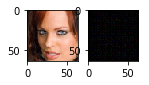

 32%|#    |ETA:   0:01:06  Epoch: 5   Iter: 997   Class Loss: 0.00   Loss: 0.54

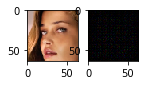

 35%|#   |ETA:   0:01:03  Epoch: 5   Iter: 1097   Class Loss: 0.00   Loss: 0.47

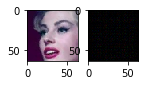

 39%|#   |ETA:   0:01:00  Epoch: 5   Iter: 1198   Class Loss: 0.00   Loss: 0.58

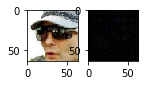

 42%|#   |ETA:   0:00:57  Epoch: 5   Iter: 1298   Class Loss: 0.00   Loss: 0.35

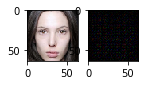

 45%|#   |ETA:   0:00:54  Epoch: 5   Iter: 1398   Class Loss: 0.01   Loss: 0.50

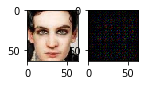

 49%|#   |ETA:   0:00:50  Epoch: 5   Iter: 1497   Class Loss: 0.00   Loss: 0.35

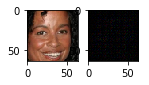

 52%|##  |ETA:   0:00:47  Epoch: 5   Iter: 1597   Class Loss: 0.00   Loss: 0.23

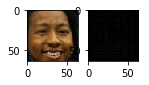

 55%|##  |ETA:   0:00:43  Epoch: 5   Iter: 1699   Class Loss: 0.00   Loss: 0.74

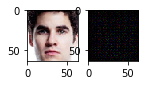

 58%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1797   Class Loss: 0.00   Loss: 0.88

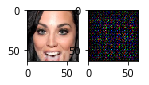

 62%|##  |ETA:   0:00:41  Epoch: 5   Iter: 1896   Class Loss: 0.00   Loss: 1.12

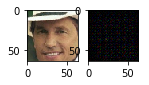

 65%|##  |ETA:   0:00:36  Epoch: 5   Iter: 1998   Class Loss: 0.00   Loss: 0.44

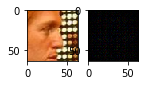

 68%|##  |ETA:   0:00:31  Epoch: 5   Iter: 2098   Class Loss: 0.00   Loss: 0.80

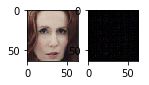

 71%|##  |ETA:   0:00:27  Epoch: 5   Iter: 2197   Class Loss: 0.00   Loss: 1.79

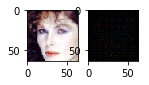

 75%|### |ETA:   0:00:24  Epoch: 5   Iter: 2299   Class Loss: 0.00   Loss: 0.88

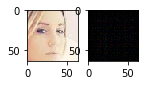

 78%|### |ETA:   0:00:21  Epoch: 5   Iter: 2398   Class Loss: 0.00   Loss: 1.04

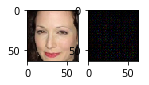

 81%|### |ETA:   0:00:18  Epoch: 5   Iter: 2496   Class Loss: 0.00   Loss: 0.52

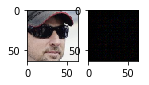

 85%|### |ETA:   0:00:14  Epoch: 5   Iter: 2597   Class Loss: 0.00   Loss: 0.99

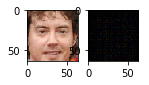

 88%|### |ETA:   0:00:11  Epoch: 5   Iter: 2698   Class Loss: 0.06   Loss: 0.57

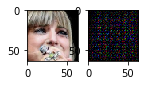

 91%|### |ETA:   0:00:08  Epoch: 5   Iter: 2799   Class Loss: 0.00   Loss: 0.43

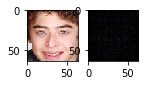

 94%|### |ETA:   0:00:05  Epoch: 5   Iter: 2898   Class Loss: 0.00   Loss: 0.18

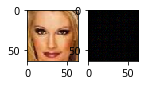

 98%|### |ETA:   0:00:01  Epoch: 5   Iter: 2999   Class Loss: 0.00   Loss: 0.25

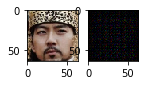

100%|####|Time:  0:01:46  Epoch: 5   Iter: 3052   Class Loss: 0.00   Loss: 0.25


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

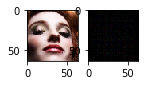

  3%|      |ETA:   0:01:35  Epoch: 6   Iter: 96   Class Loss: 0.00   Loss: 0.28

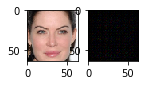

  6%|     |ETA:   0:01:32  Epoch: 6   Iter: 196   Class Loss: 0.00   Loss: 0.31

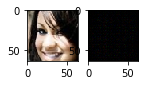

  9%|     |ETA:   0:01:29  Epoch: 6   Iter: 298   Class Loss: 0.00   Loss: 0.23

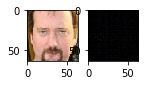

 13%|     |ETA:   0:01:26  Epoch: 6   Iter: 397   Class Loss: 0.00   Loss: 0.86

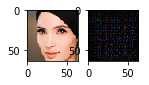

 16%|     |ETA:   0:01:22  Epoch: 6   Iter: 498   Class Loss: 0.00   Loss: 0.28

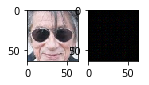

 19%|     |ETA:   0:01:19  Epoch: 6   Iter: 598   Class Loss: 0.00   Loss: 0.58

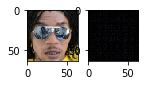

 22%|#    |ETA:   0:01:15  Epoch: 6   Iter: 698   Class Loss: 0.00   Loss: 0.29

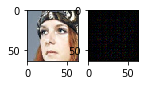

 26%|#    |ETA:   0:01:12  Epoch: 6   Iter: 799   Class Loss: 0.00   Loss: 0.35

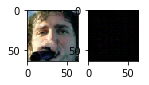

 29%|#    |ETA:   0:01:21  Epoch: 6   Iter: 897   Class Loss: 0.00   Loss: 0.31

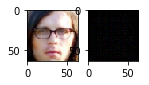

 32%|#    |ETA:   0:01:19  Epoch: 6   Iter: 996   Class Loss: 0.00   Loss: 0.45

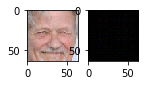

 35%|#   |ETA:   0:01:02  Epoch: 6   Iter: 1098   Class Loss: 0.00   Loss: 0.30

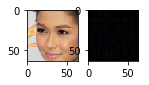

 39%|#   |ETA:   0:00:59  Epoch: 6   Iter: 1198   Class Loss: 0.00   Loss: 0.25

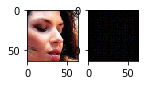

 42%|#   |ETA:   0:00:56  Epoch: 6   Iter: 1299   Class Loss: 0.00   Loss: 0.24

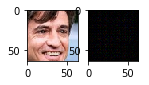

 45%|#   |ETA:   0:00:53  Epoch: 6   Iter: 1398   Class Loss: 0.00   Loss: 0.19

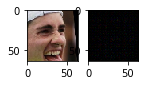

 49%|#   |ETA:   0:00:51  Epoch: 6   Iter: 1497   Class Loss: 0.00   Loss: 0.23

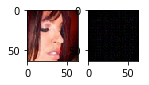

 52%|##  |ETA:   0:00:47  Epoch: 6   Iter: 1599   Class Loss: 0.00   Loss: 0.22

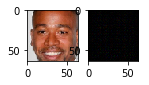

 55%|##  |ETA:   0:00:43  Epoch: 6   Iter: 1699   Class Loss: 0.00   Loss: 0.62

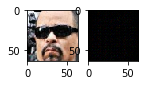

 58%|##  |ETA:   0:00:40  Epoch: 6   Iter: 1796   Class Loss: 0.00   Loss: 0.18

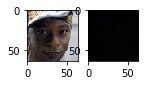

 62%|##  |ETA:   0:00:37  Epoch: 6   Iter: 1897   Class Loss: 0.00   Loss: 0.23

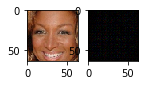

 65%|##  |ETA:   0:00:34  Epoch: 6   Iter: 1996   Class Loss: 0.00   Loss: 0.26

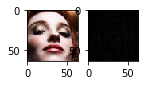

 68%|##  |ETA:   0:00:35  Epoch: 6   Iter: 2098   Class Loss: 0.00   Loss: 0.32

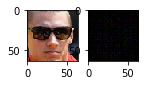

 72%|##  |ETA:   0:00:31  Epoch: 6   Iter: 2199   Class Loss: 0.00   Loss: 0.23

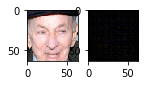

 75%|### |ETA:   0:00:27  Epoch: 6   Iter: 2298   Class Loss: 0.00   Loss: 0.29

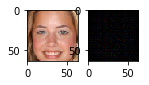

 78%|### |ETA:   0:00:21  Epoch: 6   Iter: 2399   Class Loss: 0.00   Loss: 0.40

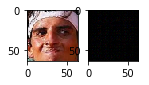

 81%|### |ETA:   0:00:17  Epoch: 6   Iter: 2496   Class Loss: 0.00   Loss: 0.31

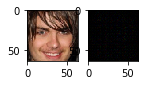

 85%|### |ETA:   0:00:14  Epoch: 6   Iter: 2597   Class Loss: 0.00   Loss: 0.28

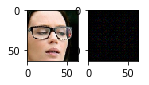

 88%|### |ETA:   0:00:11  Epoch: 6   Iter: 2696   Class Loss: 0.00   Loss: 0.31

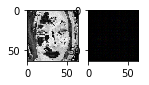

 91%|### |ETA:   0:00:08  Epoch: 6   Iter: 2797   Class Loss: 0.00   Loss: 0.29

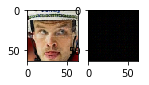

 94%|### |ETA:   0:00:04  Epoch: 6   Iter: 2898   Class Loss: 0.00   Loss: 2.47

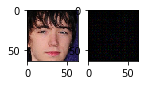

 98%|### |ETA:   0:00:01  Epoch: 6   Iter: 2999   Class Loss: 0.00   Loss: 0.33

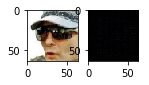

100%|####|Time:  0:01:45  Epoch: 6   Iter: 3052   Class Loss: 0.00   Loss: 0.26


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

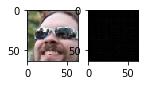

  3%|      |ETA:   0:01:44  Epoch: 7   Iter: 97   Class Loss: 0.00   Loss: 0.27

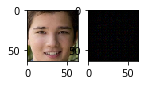

  6%|     |ETA:   0:01:33  Epoch: 7   Iter: 197   Class Loss: 0.00   Loss: 0.29

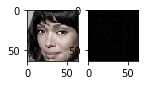

  9%|     |ETA:   0:01:29  Epoch: 7   Iter: 297   Class Loss: 0.00   Loss: 0.24

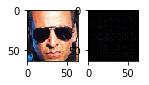

 13%|     |ETA:   0:01:25  Epoch: 7   Iter: 397   Class Loss: 0.00   Loss: 0.23

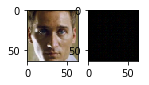

 16%|     |ETA:   0:01:22  Epoch: 7   Iter: 499   Class Loss: 0.00   Loss: 0.29

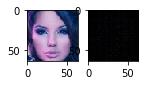

 19%|     |ETA:   0:01:19  Epoch: 7   Iter: 599   Class Loss: 0.00   Loss: 0.23

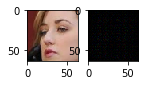

 22%|#    |ETA:   0:01:16  Epoch: 7   Iter: 698   Class Loss: 0.00   Loss: 0.30

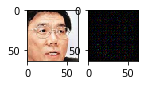

 26%|#    |ETA:   0:01:13  Epoch: 7   Iter: 799   Class Loss: 0.00   Loss: 0.27

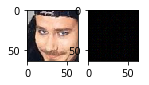

 29%|#    |ETA:   0:01:09  Epoch: 7   Iter: 896   Class Loss: 0.00   Loss: 0.27

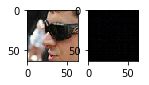

 32%|#    |ETA:   0:01:06  Epoch: 7   Iter: 999   Class Loss: 0.00   Loss: 0.32

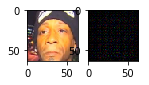

 35%|#   |ETA:   0:01:03  Epoch: 7   Iter: 1096   Class Loss: 0.00   Loss: 0.31

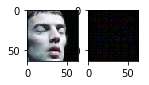

 39%|#   |ETA:   0:00:59  Epoch: 7   Iter: 1198   Class Loss: 0.00   Loss: 0.19

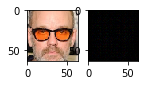

 42%|#   |ETA:   0:01:01  Epoch: 7   Iter: 1299   Class Loss: 0.00   Loss: 0.22

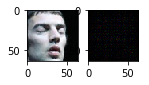

 45%|#   |ETA:   0:01:01  Epoch: 7   Iter: 1399   Class Loss: 0.00   Loss: 0.33

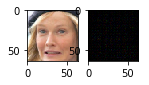

 49%|#   |ETA:   0:00:57  Epoch: 7   Iter: 1498   Class Loss: 0.00   Loss: 0.33

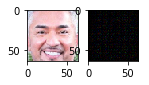

 52%|##  |ETA:   0:00:46  Epoch: 7   Iter: 1598   Class Loss: 0.00   Loss: 0.31

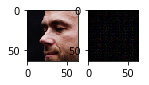

 55%|##  |ETA:   0:00:44  Epoch: 7   Iter: 1698   Class Loss: 0.36   Loss: 0.70

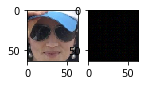

 58%|##  |ETA:   0:00:40  Epoch: 7   Iter: 1796   Class Loss: 0.00   Loss: 0.30

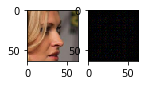

 62%|##  |ETA:   0:00:37  Epoch: 7   Iter: 1897   Class Loss: 0.00   Loss: 0.27

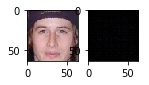

 65%|##  |ETA:   0:00:38  Epoch: 7   Iter: 1997   Class Loss: 0.00   Loss: 0.79

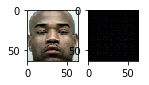

 68%|##  |ETA:   0:00:37  Epoch: 7   Iter: 2098   Class Loss: 0.00   Loss: 0.25

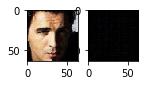

 72%|##  |ETA:   0:00:33  Epoch: 7   Iter: 2199   Class Loss: 0.00   Loss: 0.51

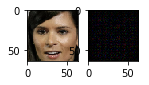

 75%|### |ETA:   0:00:26  Epoch: 7   Iter: 2296   Class Loss: 0.00   Loss: 0.34

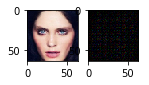

 78%|### |ETA:   0:00:21  Epoch: 7   Iter: 2399   Class Loss: 0.00   Loss: 1.73

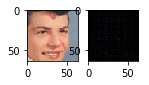

 81%|### |ETA:   0:00:17  Epoch: 7   Iter: 2499   Class Loss: 0.00   Loss: 0.40

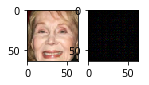

 85%|### |ETA:   0:00:14  Epoch: 7   Iter: 2596   Class Loss: 0.00   Loss: 0.27

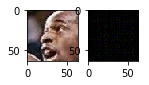

 88%|### |ETA:   0:00:11  Epoch: 7   Iter: 2699   Class Loss: 0.00   Loss: 0.28

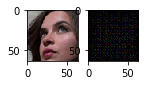

 91%|### |ETA:   0:00:08  Epoch: 7   Iter: 2797   Class Loss: 0.00   Loss: 0.31

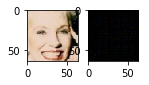

 94%|### |ETA:   0:00:04  Epoch: 7   Iter: 2898   Class Loss: 0.00   Loss: 0.30

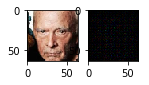

 98%|### |ETA:   0:00:01  Epoch: 7   Iter: 2999   Class Loss: 0.00   Loss: 0.34

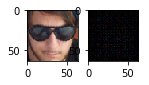

100%|####|Time:  0:01:46  Epoch: 7   Iter: 3052   Class Loss: 0.00   Loss: 0.52


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

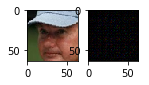

  3%|      |ETA:   0:01:35  Epoch: 8   Iter: 96   Class Loss: 0.00   Loss: 0.49

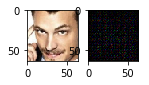

  6%|     |ETA:   0:01:32  Epoch: 8   Iter: 197   Class Loss: 0.00   Loss: 0.52

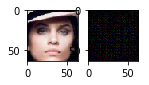

  9%|     |ETA:   0:01:30  Epoch: 8   Iter: 299   Class Loss: 0.00   Loss: 0.97

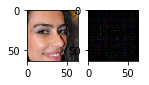

 13%|     |ETA:   0:01:25  Epoch: 8   Iter: 397   Class Loss: 0.00   Loss: 0.53

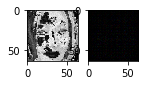

 16%|     |ETA:   0:01:34  Epoch: 8   Iter: 499   Class Loss: 0.00   Loss: 0.76

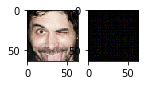

 19%|     |ETA:   0:01:31  Epoch: 8   Iter: 597   Class Loss: 0.00   Loss: 0.72

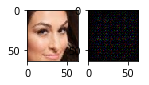

 22%|#    |ETA:   0:01:26  Epoch: 8   Iter: 699   Class Loss: 0.00   Loss: 0.41

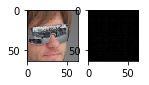

 26%|#    |ETA:   0:01:12  Epoch: 8   Iter: 796   Class Loss: 0.00   Loss: 0.34

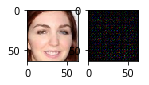

 29%|#    |ETA:   0:01:09  Epoch: 8   Iter: 896   Class Loss: 0.00   Loss: 0.33

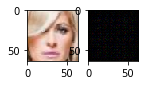

 32%|#    |ETA:   0:01:06  Epoch: 8   Iter: 997   Class Loss: 0.00   Loss: 0.26

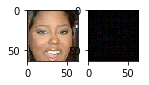

 35%|#   |ETA:   0:01:03  Epoch: 8   Iter: 1096   Class Loss: 0.00   Loss: 0.29

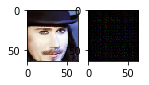

 39%|#   |ETA:   0:00:59  Epoch: 8   Iter: 1198   Class Loss: 0.00   Loss: 0.36

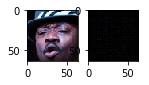

 42%|#   |ETA:   0:00:56  Epoch: 8   Iter: 1298   Class Loss: 0.00   Loss: 0.51

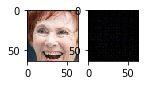

 45%|#   |ETA:   0:00:58  Epoch: 8   Iter: 1399   Class Loss: 0.00   Loss: 0.40

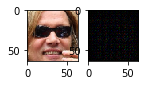

 49%|#   |ETA:   0:00:50  Epoch: 8   Iter: 1497   Class Loss: 0.00   Loss: 0.37

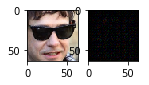

 52%|##  |ETA:   0:00:46  Epoch: 8   Iter: 1596   Class Loss: 0.00   Loss: 0.31

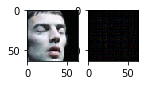

 55%|##  |ETA:   0:00:43  Epoch: 8   Iter: 1696   Class Loss: 0.00   Loss: 0.37

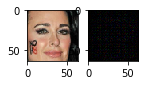

 58%|##  |ETA:   0:00:40  Epoch: 8   Iter: 1796   Class Loss: 0.00   Loss: 0.43

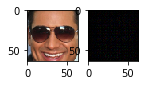

 62%|##  |ETA:   0:00:37  Epoch: 8   Iter: 1897   Class Loss: 0.00   Loss: 0.41

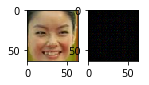

 65%|##  |ETA:   0:00:34  Epoch: 8   Iter: 1997   Class Loss: 0.00   Loss: 0.35

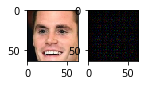

 68%|##  |ETA:   0:00:30  Epoch: 8   Iter: 2097   Class Loss: 0.00   Loss: 0.50

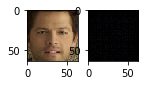

 71%|##  |ETA:   0:00:28  Epoch: 8   Iter: 2197   Class Loss: 0.00   Loss: 0.27

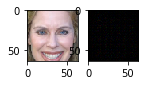

 75%|### |ETA:   0:00:24  Epoch: 8   Iter: 2296   Class Loss: 0.00   Loss: 0.27

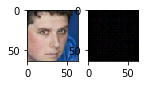

 78%|### |ETA:   0:00:21  Epoch: 8   Iter: 2398   Class Loss: 0.00   Loss: 0.25

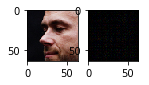

 81%|### |ETA:   0:00:17  Epoch: 8   Iter: 2496   Class Loss: 0.00   Loss: 0.22

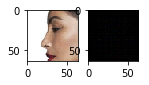

 85%|### |ETA:   0:00:14  Epoch: 8   Iter: 2597   Class Loss: 0.00   Loss: 0.27

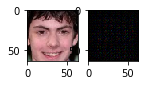

 88%|### |ETA:   0:00:11  Epoch: 8   Iter: 2698   Class Loss: 0.00   Loss: 0.29

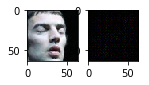

 91%|### |ETA:   0:00:08  Epoch: 8   Iter: 2798   Class Loss: 0.00   Loss: 0.40

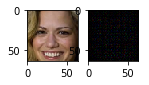

 94%|### |ETA:   0:00:05  Epoch: 8   Iter: 2898   Class Loss: 0.00   Loss: 0.32

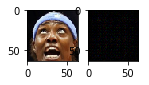

 98%|### |ETA:   0:00:01  Epoch: 8   Iter: 2999   Class Loss: 0.00   Loss: 0.34

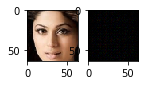

100%|####|Time:  0:01:45  Epoch: 8   Iter: 3052   Class Loss: 0.00   Loss: 0.29


Recomputing the sampling probabilities


N/A%|     |ETA:  --:--:--  Epoch: nan   Iter: nan   Class Loss: nan   Loss: nan

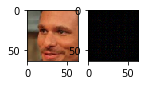

  3%|      |ETA:   0:01:34  Epoch: 9   Iter: 97   Class Loss: 0.00   Loss: 0.28

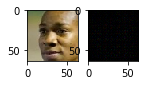

  6%|     |ETA:   0:01:32  Epoch: 9   Iter: 197   Class Loss: 0.00   Loss: 0.22

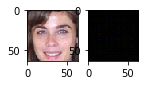

  9%|     |ETA:   0:01:29  Epoch: 9   Iter: 299   Class Loss: 0.00   Loss: 0.34

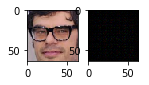

 13%|     |ETA:   0:01:41  Epoch: 9   Iter: 398   Class Loss: 0.00   Loss: 0.21

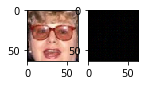

 16%|     |ETA:   0:01:29  Epoch: 9   Iter: 498   Class Loss: 0.00   Loss: 0.22

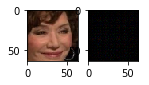

 19%|     |ETA:   0:01:19  Epoch: 9   Iter: 598   Class Loss: 0.00   Loss: 0.18

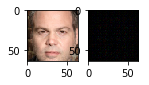

 22%|#    |ETA:   0:01:15  Epoch: 9   Iter: 699   Class Loss: 0.00   Loss: 0.23

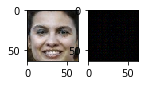

 26%|#    |ETA:   0:01:12  Epoch: 9   Iter: 796   Class Loss: 0.00   Loss: 0.23

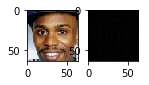

 29%|#    |ETA:   0:01:08  Epoch: 9   Iter: 896   Class Loss: 0.00   Loss: 0.23

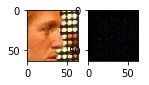

 32%|#    |ETA:   0:01:06  Epoch: 9   Iter: 996   Class Loss: 0.00   Loss: 0.22

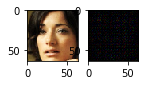

 35%|#   |ETA:   0:01:04  Epoch: 9   Iter: 1097   Class Loss: 0.00   Loss: 0.17

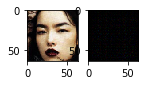

 39%|#   |ETA:   0:01:00  Epoch: 9   Iter: 1197   Class Loss: 0.00   Loss: 0.23

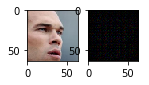

 42%|#   |ETA:   0:00:56  Epoch: 9   Iter: 1298   Class Loss: 0.00   Loss: 0.26

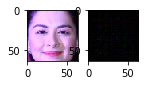

 45%|#   |ETA:   0:00:53  Epoch: 9   Iter: 1398   Class Loss: 0.00   Loss: 0.25

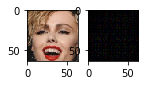

 49%|#   |ETA:   0:00:50  Epoch: 9   Iter: 1498   Class Loss: 0.00   Loss: 0.20

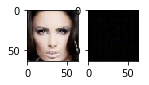

 52%|##  |ETA:   0:00:47  Epoch: 9   Iter: 1599   Class Loss: 0.00   Loss: 0.21

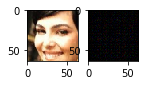

 55%|##  |ETA:   0:00:44  Epoch: 9   Iter: 1699   Class Loss: 0.00   Loss: 0.27

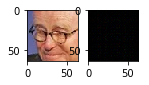

 58%|##  |ETA:   0:00:40  Epoch: 9   Iter: 1796   Class Loss: 0.00   Loss: 0.26

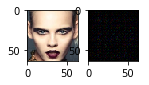

 62%|##  |ETA:   0:00:37  Epoch: 9   Iter: 1897   Class Loss: 0.00   Loss: 0.22

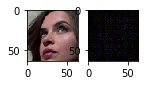

 65%|##  |ETA:   0:00:34  Epoch: 9   Iter: 1998   Class Loss: 0.00   Loss: 0.20

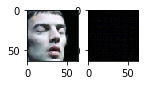

 68%|##  |ETA:   0:00:35  Epoch: 9   Iter: 2098   Class Loss: 0.00   Loss: 0.20

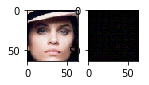

 72%|##  |ETA:   0:00:31  Epoch: 9   Iter: 2199   Class Loss: 0.00   Loss: 0.24

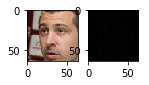

 75%|### |ETA:   0:00:25  Epoch: 9   Iter: 2296   Class Loss: 0.00   Loss: 0.22

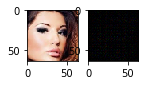

 78%|### |ETA:   0:00:21  Epoch: 9   Iter: 2399   Class Loss: 0.00   Loss: 0.22

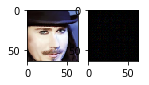

 81%|### |ETA:   0:00:18  Epoch: 9   Iter: 2496   Class Loss: 0.00   Loss: 0.21

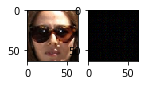

 85%|### |ETA:   0:00:14  Epoch: 9   Iter: 2597   Class Loss: 0.00   Loss: 0.26

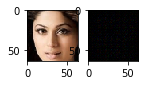

 88%|### |ETA:   0:00:12  Epoch: 9   Iter: 2697   Class Loss: 0.00   Loss: 0.23

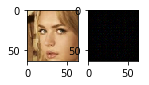

 91%|### |ETA:   0:00:08  Epoch: 9   Iter: 2797   Class Loss: 0.00   Loss: 0.21

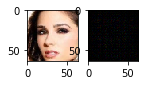

 94%|### |ETA:   0:00:05  Epoch: 9   Iter: 2898   Class Loss: 0.00   Loss: 0.18

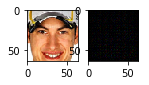

 98%|### |ETA:   0:00:01  Epoch: 9   Iter: 2999   Class Loss: 0.00   Loss: 0.29

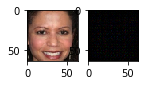

100%|####|Time:  0:01:45  Epoch: 9   Iter: 3052   Class Loss: 0.00   Loss: 0.27
100% (97 of 97) |########################| Elapsed Time: 0:01:10 Time:  0:01:10
N/A% (0 of 72) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male lighter: 0.948453608247


100% (72 of 72) |########################| Elapsed Time: 0:00:48 Time:  0:00:48
N/A% (0 of 78) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


female lighter: 0.958333333333


100% (78 of 78) |########################| Elapsed Time: 0:00:52 Time:  0:00:52
N/A% (0 of 71) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--


male darker: 0.820512820513


100% (71 of 71) |########################| Elapsed Time: 0:00:48 Time:  0:00:48



female darker: 0.887323943662


Text(0,0.5,'Accuracy')

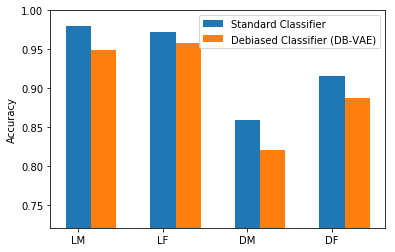

In [19]:
loss_history = []
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)

enable_debiasing = True
all_faces = loader.get_all_train_faces() # parameter from data loader

for epoch in range(num_epochs):
  
  # progress message and bar
  custom_msg = util.custom_progress_text("Epoch: %(epoch).0f   Iter: %(idx).0f   Class Loss: %(class_loss)2.2f   Loss: %(loss)2.2f")
  bar = util.create_progress_bar(custom_msg)

  p_faces = None
  if enable_debiasing: 
      # Recompute data sampling proabilities if debiasing is enabled
      '''TODO: write the function call to recompute the sampling probabilities
          when debiasing is enabled'''
      p_faces = get_training_sample_probabilities(all_faces, encoder,smoothing_fac=0.0)
  for idx in bar(range(loader.get_train_size()//batch_size)):
    # load a batch of data
    (x, y) = loader.get_batch(batch_size, p_pos=p_faces)
    x = tf.convert_to_tensor(x, dtype=tf.float32)
    y = tf.convert_to_tensor(y, dtype=tf.float32)
  
    # define GradientTape for automatic differentiation
    with tf.GradientTape() as tape:
      y_logit, mu, logsigma, z = encoder(x)
      x_hat = decoder(z)
      '''TODO: call the relevant loss function to compute the loss'''
      loss, class_loss = debiasing_loss_function(x, x_hat, y, y_logit, mu, logsigma)
    
    '''TODO: use the GradientTape.gradient method to compute the gradients'''
    grads = tape.gradient(loss, vae.variables)
    # apply gradients to variables
    optimizer.apply_gradients(zip(grads, vae.variables),
                              global_step=tf.train.get_or_create_global_step())

    # track the losses
    class_loss_value = class_loss.numpy().mean()
    loss_value = loss.numpy().mean()
    loss_history.append((class_loss_value, loss_value))
    custom_msg.update_mapping(epoch=epoch, idx=idx, loss=loss_value, class_loss=class_loss_value)
    
    # plot the progress every 100 steps
    if idx%100 == 0: 
      util.plot_sample(x,y,vae)
accuracy_debiased = []
for skin_color in ['lighter', 'darker']:
  for gender in ['male', 'female']:
    accuracy_debiased.append( ppb.evaluate([encoder], gender, skin_color, output_idx=0, from_logit=True)[0] )
    print 
    print "{} {}: {}".format(gender, skin_color, accuracy_debiased[-1])
    
    
bar_width = 0.3
plt.bar(np.arange(4), standard_cnn_accuracy, width=bar_width)
plt.bar(np.arange(4)+bar_width, accuracy_debiased, width=bar_width)
plt.legend(('Standard Classifier','Debiased Classifier (DB-VAE)'))
plt.xticks(np.arange(4), ('LM', 'LF', 'DM', 'DF'))
plt.ylim(np.min([standard_cnn_accuracy,accuracy_debiased])-0.1,1)
plt.ylabel('Accuracy')

Conclusion
--------------

Debiased Classifier is more unbiased than Standard Classifier, we can see it in graph that both male and female are nearer to each other in Accuracy.